# Setup

In [ ]:
!nvidia-smi

Mon May 29 21:27:32 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8    12W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
!pip install torcheval

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.4/158.4 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.9/87.9 kB 7.0 MB/s eta 0:00:00


In [ ]:
!pip install gdown
!pip install --upgrade gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: gdown
    Found existing installation: gdown 4.6.6
    Uninstalling gdown-4.6.6:
      Successfully uninstalled gdown-4.6.6


In [ ]:
!pip install mpi4py blobfile

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 15.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.5/74.5 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 30.6 MB/s eta 0:00:00


In [ ]:
!git clone --recurse-submodules https://github.com/yandex-research/ddpm-segmentation.git

In [ ]:
%cd ddpm-segmentation/
!wget -c https://storage.yandexcloud.net/yandex-research/ddpm-segmentation/datasets.tar.gz
!tar -xzf datasets.tar.gz -C datasets/
!rm datasets.tar.gz

In [ ]:
%cd guided_diffusion

In [ ]:
%mkdir models

In [ ]:
%cd models

In [ ]:
!gdown 1ZW42BlKH51W4__GNjTdZEZ4A-3-iTsXI

In [ ]:
#!wget -P models/ https://openaipublic.blob.core.windows.net/diffusion/jul-2021/64x64_diffusion.pt
#!wget -P models/ https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion.pt
#!wget -P models/ https://openaipublic.blob.core.windows.net/diffusion/jul-2021/256x256_diffusion_uncond.pt

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_images(images, max_cols=5, axis=True, cmap=None, init='/content/3J6A0789.JPG',
                save=False, path=None):
  # Calculate the number of rows and columns needed
  num_images = len(images)
  num_cols = min(num_images, max_cols)
  num_rows = (num_images - 1) // num_cols + 1

  # Create a figure with a grid of subplots
  fig, axs = plt.subplots(num_rows, num_cols, figsize=(20,10))

  # Plot each image in a subplot
  for i, ax in enumerate(axs.flat):
    if i < num_images:
      if init and i == 0:
        size = np.array(images[0])[0].shape[-1]
        img = read_image(init, size=(size, size), ch_first=False)
        ax.imshow(img)
      else:
        if cmap == 'gray':
          try:
            ax.imshow(images[i], cmap='gray')
          except:
            ax.imshow(images[i].cpu(), cmap='gray')
        elif cmap:
          ax.imshow(images[i], cmap=cmap[i])
        else:
          ax.imshow(images[i])
      if not axis:
        ax.axis('off')

  plt.show()
  if save and path:
      plt.savefig(os.path.join(path, "testset_visualizations.pdf"))

Add to `image_sample.py`

In [ ]:
# import sys; sys.path.append("/content/ddpm-segmentation/guided_diffusion")

# out_path = f"/content/samples_{shape_str}.npz"

# Generation

In [ ]:
!sed -i '82s/.*/out_path = f"/content/samples_{shape_str}.npz"/' scripts/image_sample.py
!sed -i '5s/.*/import sys; sys.path.append("/content/ddpm-segmentation/guided_diffusion")/' scripts/image_sample.py

### 64 Conditional

In [ ]:
SAMPLE_FLAGS="--batch_size 5 --num_samples 10 --timestep_respacing 250"

In [ ]:
MODEL_FLAGS="""--attention_resolutions 32,16,8 --class_cond True
--diffusion_steps 1000 --dropout 0.1 --image_size 64 --learn_sigma True
--noise_schedule cosine --num_channels 192 --num_head_channels 64
--num_res_blocks 3 --resblock_updown True --use_new_attention_order True
--use_fp16 False --use_scale_shift_norm True""".replace('\n', '').strip()

CHECKPOINT="--model_path models/64x64_diffusion.pt"

!python scripts/image_sample.py $CHECKPOINT $MODEL_FLAGS $SAMPLE_FLAGS

Logging to /tmp/openai-2023-01-05-20-02-38-239984
creating model and diffusion...
tcmalloc: large alloc 1183744000 bytes == 0x4d53c000 @  0x7f9c419fe1e7 0x4d30a0 0x5dede2 0x61033f 0x5aab9b 0x47c416 0x6170f1 0x4f7916 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f9c415fbc87 0x5e1baa
tcmalloc: large alloc 1610620928 bytes == 0xd3e26000 @  0x7f9c419ff2a4 0x5d6f4c 0x523000 0x61cc55 0x52749b 0x58fa2d 0x52aa08 0x7f9bbc73850d 0x7f9bbc7ae6e1 0x7f9bbc7b02c1 0x4f9336 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f9c415fbc87 0x5e1baa
sampling...
created 5 samples
created 10 samples
saving to /content/samples_10x64x64x3.npz
sampling complete
[04145f7decdb:06827] *** Process received signal ***
[04145f7decdb:06827] Signal: Segmentation fault (11)
[04145f7decdb:06827] Signal code: Address not mapped (1)
[04145f7decdb:0

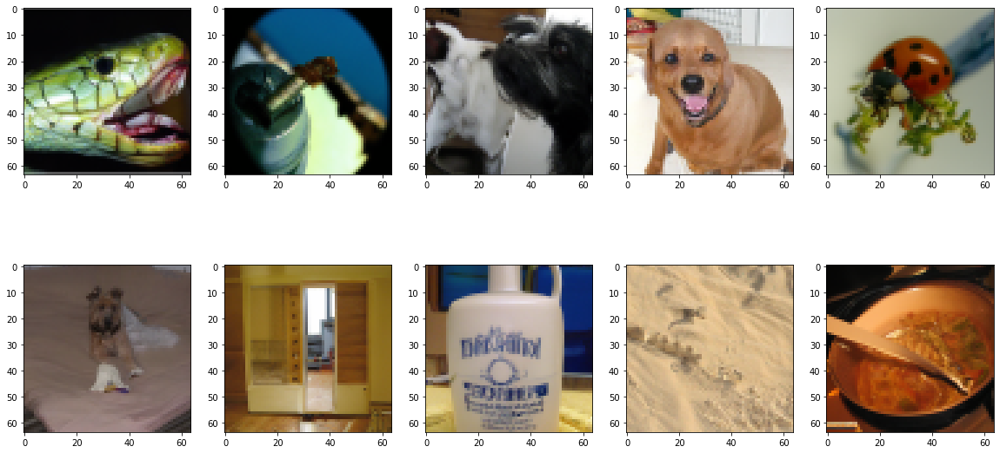

In [ ]:
samples = np.load('/content/samples_10x64x64x3.npz')
imgs = samples['arr_0']
plot_images(imgs)

### 256 Conditional

In [ ]:
MODEL_FLAGS="""--attention_resolutions 32,16,8 --class_cond True
--diffusion_steps 1000 --image_size 256 --learn_sigma True
--noise_schedule linear --num_channels 256 --num_head_channels 64
--num_res_blocks 2 --resblock_updown True --use_fp16 True
--use_scale_shift_norm True""".replace('\n', '').strip()

CHECKPOINT="--model_path models/256x256_diffusion.pt"

!python scripts/image_sample.py $CHECKPOINT $MODEL_FLAGS $SAMPLE_FLAGS

Logging to /tmp/openai-2023-01-05-20-05-13-187228
creating model and diffusion...
tcmalloc: large alloc 2215485440 bytes == 0x8ab9e000 @  0x7f386f8a91e7 0x4d30a0 0x5dede2 0x61033f 0x5aab9b 0x47c416 0x6170f1 0x4f7916 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f386f4a6c87 0x5e1baa
tcmalloc: large alloc 1610620928 bytes == 0x14ec7a000 @  0x7f386f8aa2a4 0x5d6f4c 0x523000 0x61cc55 0x52749b 0x58fa2d 0x52aa08 0x7f37ea5e350d 0x7f37ea6596e1 0x7f37ea65b2c1 0x4f9336 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f386f4a6c87 0x5e1baa
tcmalloc: large alloc 1610620928 bytes == 0x14ec7a000 @  0x7f386f8aa2a4 0x5d6f4c 0x523000 0x61cc55 0x52749b 0x58fa2d 0x52aa08 0x7f37ea5e350d 0x7f37ea6596e1 0x7f37ea65b2c1 0x4f9336 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b7

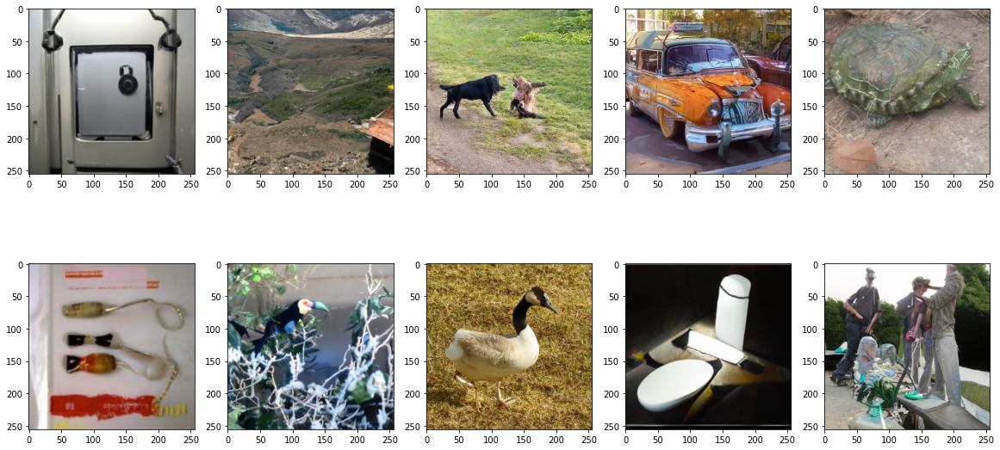

In [ ]:
samples = np.load("/content/samples_10x256x256x3.npz")
imgs = samples['arr_0']
plot_images(imgs)

### 256 Unconditional

In [ ]:
MODEL_FLAGS="""--attention_resolutions 32,16,8 --class_cond False
--diffusion_steps 1000 --image_size 256 --learn_sigma True
--noise_schedule linear --num_channels 256 --num_head_channels 64
--num_res_blocks 2 --resblock_updown True --use_fp16 True
--use_scale_shift_norm True""".replace('\n', '').strip()

CHECKPOINT="--model_path models/256x256_diffusion_uncond.pt"

!python scripts/image_sample.py $CHECKPOINT $MODEL_FLAGS $SAMPLE_FLAGS

Logging to /tmp/openai-2023-01-05-20-14-42-073837
creating model and diffusion...
tcmalloc: large alloc 2211389440 bytes == 0x8bda4000 @  0x7f8a1e7841e7 0x4d30a0 0x5dede2 0x61033f 0x5aab9b 0x47c416 0x6170f1 0x4f7916 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f8a1e381c87 0x5e1baa
tcmalloc: large alloc 1610620928 bytes == 0x14fa98000 @  0x7f8a1e7852a4 0x5d6f4c 0x523000 0x61cc55 0x52749b 0x58fa2d 0x52aa08 0x7f89994be50d 0x7f89995346e1 0x7f89995362c1 0x4f9336 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b78 0x64511c 0x677e5e 0x678029 0x7f8a1e381c87 0x5e1baa
tcmalloc: large alloc 1610620928 bytes == 0x14fa98000 @  0x7f8a1e7852a4 0x5d6f4c 0x523000 0x61cc55 0x52749b 0x58fa2d 0x52aa08 0x7f89994be50d 0x7f89995346e1 0x7f89995362c1 0x4f9336 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55d078 0x5d8941 0x4990ca 0x55cd91 0x55d743 0x642630 0x6426ae 0x644b7

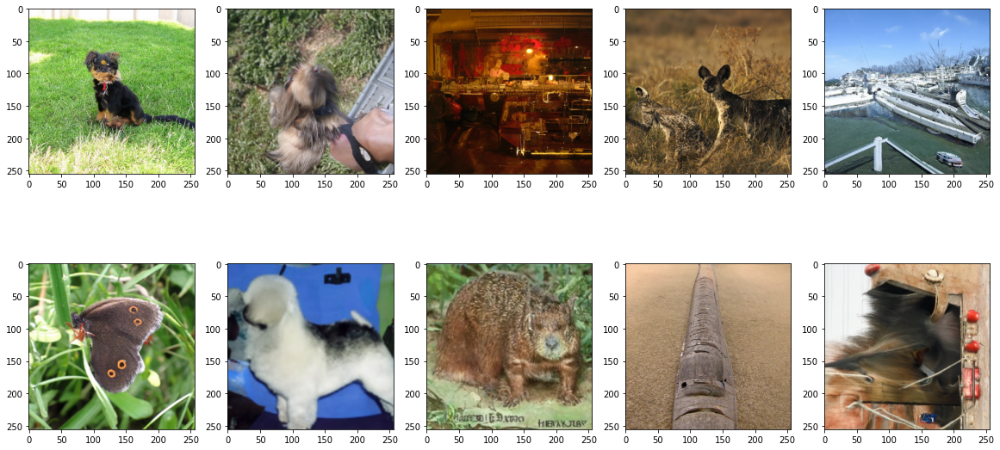

In [ ]:
samples = np.load("/content/samples_10x256x256x3.npz")
imgs = samples['arr_0']
plot_images(imgs)

## Feature extractor

In [ ]:
%cd ..

/content/ddpm-segmentation


In [ ]:
import torch
from tqdm import tqdm
import json
import os
import gc
import PIL
import matplotlib.colors as colors
from sklearn.cluster import KMeans

import sys
from torch import nn
from typing import List
from src.feature_extractors import create_feature_extractor, collect_features
from guided_diffusion.guided_diffusion.dist_util import dev

In [ ]:
args = {
    # ICLR Args
    "exp_dir": "pixel_classifiers/kmeans/ddpm_256_uncond",
    "model_type": "ddpm",

    "category": "kmeans_5",
    "number_class": 5,
    "ignore_label": 255,

    "training_path": None,
    "validation_path": None,
    "testing_path": None,
    "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    "dim": [256, 256, 13312], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [50, 150, 250, 500], # how many steps before grabbing activations
    "blocks": [5, 6, 7, 8, 10, 12, 14, 16], # where to grab activations

    "model_num": 10,
    "batch_size": 5,
    "max_training": None,

    "training_number": None,
    "testing_number": 1,

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
}

In [ ]:
def save_tensors(module: nn.Module, features, name: str):
    """ Process and save activations in the module. """
    if type(features) in [list, tuple]:
        features = [f.detach().float() if f is not None else None
                    for f in features]
        setattr(module, name, features)
    elif isinstance(features, dict):
        features = {k: f.detach().float() for k, f in features.items()}
        setattr(module, name, features)
    else:
        setattr(module, name, features.detach().float())

In [ ]:
def save_input_hook(self, inp, out):
    save_tensors(self, inp[0], 'activations')
    return out

In [ ]:
def save_out_hook(self, inp, out):
    save_tensors(self, out, 'activations')
    return out

In [ ]:
def collect_features(args, activations: List[torch.Tensor], sample_idx=0):
    """ Upsample activations and concatenate them to form a feature tensor """
    assert all([isinstance(acts, torch.Tensor) for acts in activations])
    size = tuple(args['dim'][:-1])
    resized_activations = []
    for feats in activations:
        feats = feats[sample_idx][None]
        feats = nn.functional.interpolate(
            feats, size=size, mode=args["upsample_mode"]
        )
        resized_activations.append(feats[0])

    return torch.cat(resized_activations, dim=0)

In [ ]:
class FeatureExtractor(nn.Module):
    def __init__(self, model_path: str, input_activations: bool, **kwargs):
        '''
        Parent feature extractor class.

        param: model_path: path to the pretrained model
        param: input_activations:
            If True, features are input activations of the corresponding blocks
            If False, features are output activations of the corresponding blocks
        '''
        super().__init__()
        self._load_pretrained_model(model_path, **kwargs)
        print(f"Pretrained model is successfully loaded from {model_path}")
        self.save_hook = save_input_hook if input_activations else save_out_hook
        self.feature_blocks = []

    def _load_pretrained_model(self, model_path: str, **kwargs):
        pass

In [ ]:
class FeatureExtractorDDPM(FeatureExtractor):
    '''
    Wrapper to extract features from pretrained DDPMs.

    :param steps: list of diffusion steps t.
    :param blocks: list of the UNet decoder blocks.
    '''

    def __init__(self, steps: List[int], blocks: List[int], **kwargs):
        super().__init__(**kwargs)
        self.steps = steps
        self.block_list = blocks

        # Save decoder activations
        for idx, block in enumerate(self.model.output_blocks):
            if idx in blocks:
                block.register_forward_hook(self.save_hook)
                self.feature_blocks.append(block)

    def _load_pretrained_model(self, model_path, **kwargs):
        import inspect
        import guided_diffusion.guided_diffusion.dist_util as dist_util
        from guided_diffusion.guided_diffusion.script_util import create_model_and_diffusion

        # Needed to pass only expected args to the function
        argnames = inspect.getfullargspec(create_model_and_diffusion)[0]
        expected_args = {name: kwargs[name] for name in argnames}
        self.model, self.diffusion = create_model_and_diffusion(**expected_args)

        self.model.load_state_dict(
            dist_util.load_state_dict(model_path, map_location="cpu")
        )
        self.model.to(dist_util.dev())
        if kwargs['use_fp16']:
            self.model.convert_to_fp16()
        self.model.eval()

    @torch.no_grad()
    def forward(self, x, noise=None):
        activations = []
        for t in self.steps:
            # Compute x_t and run DDPM
            t = torch.tensor([t]).to(x.device)
            noisy_x = self.diffusion.q_sample(x, t, noise=noise)
            self.model(noisy_x, self.diffusion._scale_timesteps(t))

            # Extract activations
            for i, block in enumerate(self.feature_blocks):
                print(f"Saving activations at timestep {t}")
                print(f"Block number {self.block_list[i]} of size {block.activations.shape}")
                print()
                activations.append(block.activations)
                block.activations = None

        # Per-layer list of activations [N, C, H, W]
        return activations

In [ ]:
feature_extractor = FeatureExtractorDDPM(**args)

Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt


In [ ]:
rnd_gen = torch.Generator(device=dev()).manual_seed(420)
noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())

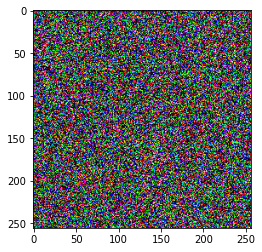

In [ ]:
plt.imshow(noise.cpu().numpy()[0].transpose((1, 2, 0)))

In [ ]:
from src.datasets import ImageLabelDataset, FeatureDataset, make_transform

In [ ]:
def read_image(filepath, size=(256, 256), ch_first=True):
  # Open the image using PIL
  with PIL.Image.open(filepath) as img:
    if img.format == 'PNG':
        img = img.convert('RGB')
    # Resize the image to the specified size
    img = img.resize(size, resample=PIL.Image.BILINEAR)
    # Convert the image to a NumPy array
    img_array = np.array(img)

  if ch_first:
    # Convert the NumPy array to a PyTorch tensor
    img_tensor = torch.from_numpy(img_array)
    # Return the tensor in the "ch, row, col" format
    return img_tensor.permute(2, 0, 1)

  else:
    return img_array

In [ ]:
def plot_activations(activations, num=5, cmap='gray', axis=False, init=None):
  # Get the number of channels in the activations
  num_images = min(num, len(activations))
  plot_images(activations[:num_images], cmap=cmap, axis=axis, init=init)

In [ ]:
def cluster_and_plot(feature_maps, num, k, init=None):
  images = []
  cmaps = []
  for feature_map in feature_maps[:num]:

    # Flatten the feature map to a 1D array
    feature_map_flat = feature_map.flatten()

    # Run k-means clustering
    kmeans = KMeans(n_clusters=k).fit(feature_map_flat.reshape(-1, 1))

    # Get the cluster labels for each value in the feature map
    labels = kmeans.predict(feature_map_flat.reshape(-1, 1))

    # Reshape the labels back to the original shape
    labels = labels.reshape(feature_map.shape)

    # Create a colormap for the clusters
    color_values = ['r', 'g', 'b', 'c', 'm', 'y', 'k']
    cmap = colors.ListedColormap(color_values[:k])
    images.append(labels)
    cmaps.append(cmap)

  plot_images(images, cmap=cmaps, init=init)

## Horse

In [ ]:
dataset = ImageLabelDataset(
    data_dir="datasets/horse_21/real/train",
    resolution=args['image_size'],
    num_images=30,
    transform=make_transform(
        args['model_type'],
        args['image_size']
    )
)

In [ ]:
for row, (img, label) in enumerate(tqdm(dataset)):
    break

  0%|          | 0/30 [00:00<?, ?it/s]


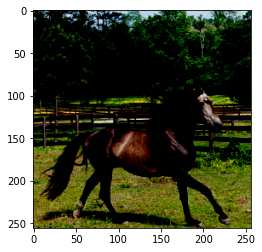

In [ ]:
plt.imshow(img.cpu().numpy().transpose((1, 2, 0)))
img = img[None].to(dev())
features = feature_extractor(img, noise=noise)
horse_features = collect_features(args, features).cpu()

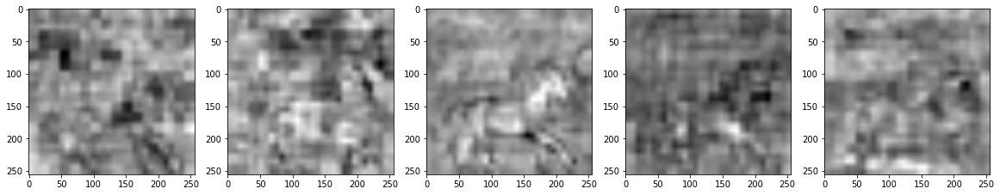

In [ ]:
plot_activations(horse_features, axis=True)

## Davinci

In [ ]:
wound_img = read_image('/content/3J6A0789.JPG')
wound_img = wound_img[None].to(dev())
features = feature_extractor(wound_img, noise=noise)
wound_features = collect_features(args, features).cpu()

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

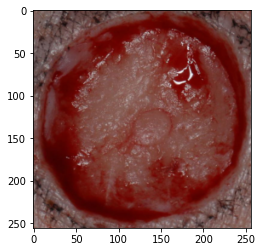

In [ ]:
plt.imshow(wound_img.cpu().numpy()[0].transpose((1, 2, 0)))

### Block 5 at 32x32

In [ ]:
block5_t50 = np.array(features[0].cpu())

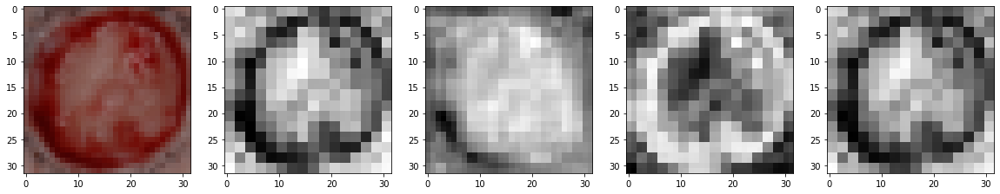

In [ ]:
plot_activations(block5_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

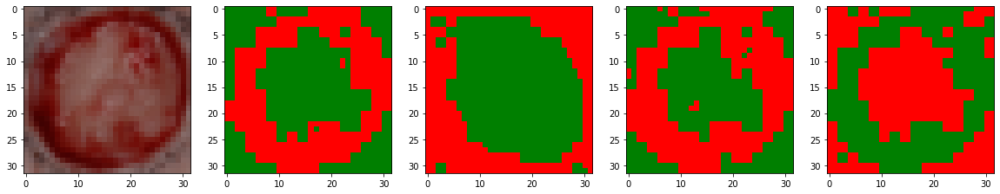

In [ ]:
cluster_and_plot(block5_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

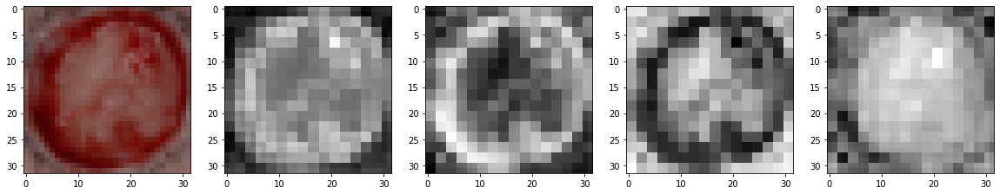

In [ ]:
plot_activations(block5_t50[0][30:], num=5, axis=True, init='/content/3J6A0789.JPG')

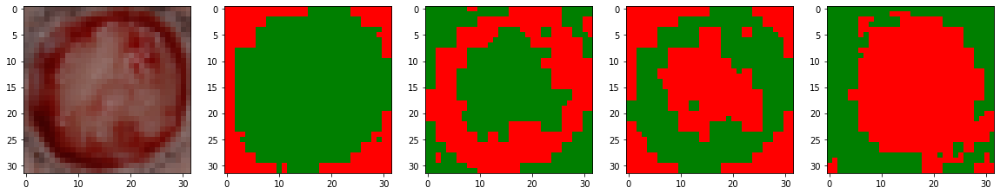

In [ ]:
cluster_and_plot(block5_t50[0][30:], num=5, k=2, init='/content/3J6A0789.JPG')

### Block 6 at 32x32

In [ ]:
block6_t50 = np.array(features[1].cpu())

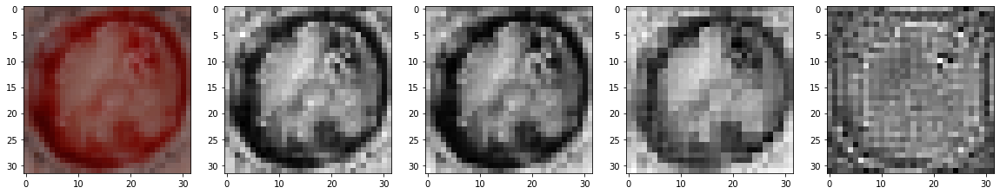

In [ ]:
plot_activations(block6_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

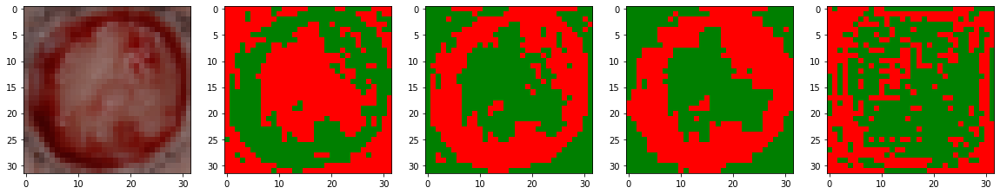

In [ ]:
cluster_and_plot(block6_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

### Block 8 at 64x64

In [ ]:
block8_t50 = np.array(features[3].cpu())

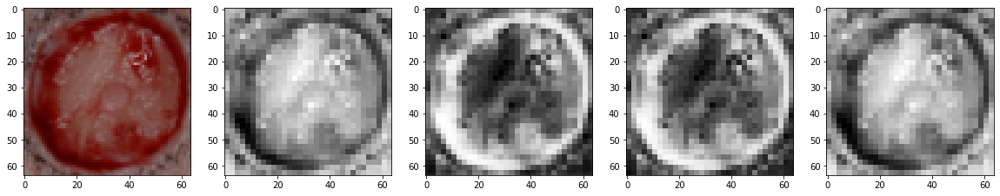

In [ ]:
plot_activations(block8_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

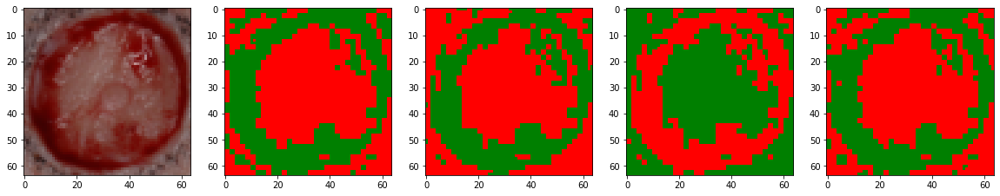

In [ ]:
cluster_and_plot(block8_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

### Block 12 at 128x128

In [ ]:
block12_t50 = np.array(features[5].cpu())

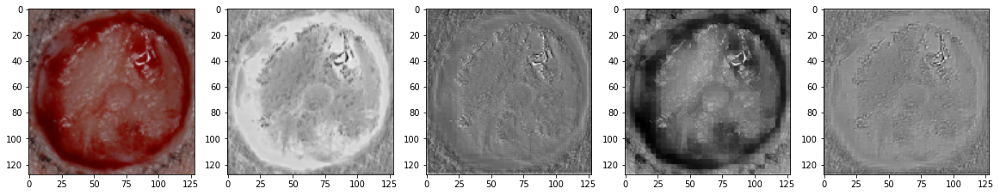

In [ ]:
plot_activations(block12_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

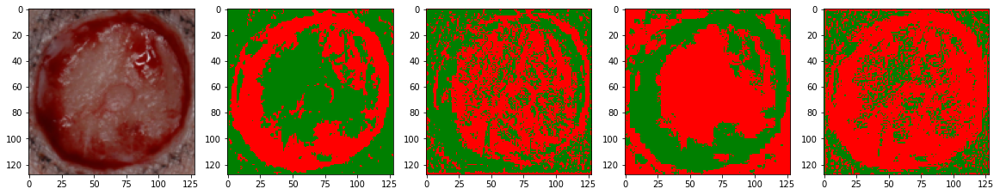

In [ ]:
cluster_and_plot(block12_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

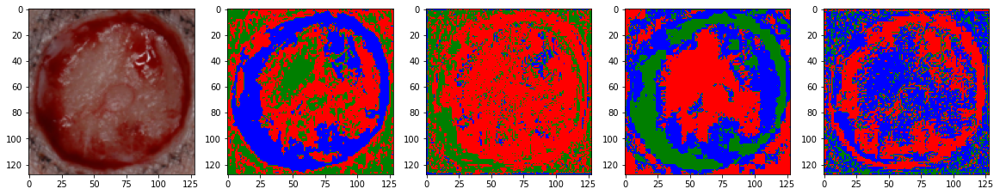

In [ ]:
cluster_and_plot(block12_t50[0], num=5, k=3, init='/content/3J6A0789.JPG')

### Block 14 (256x256)

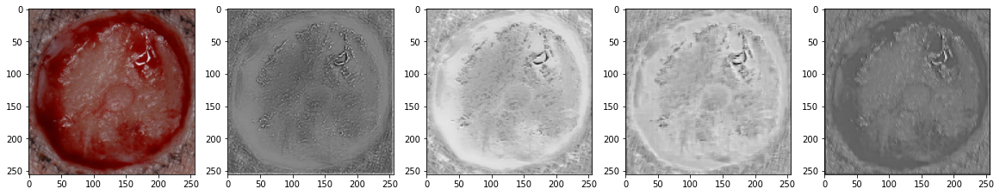

In [ ]:
block14_t50 = np.array(features[6].cpu())
plot_activations(block14_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

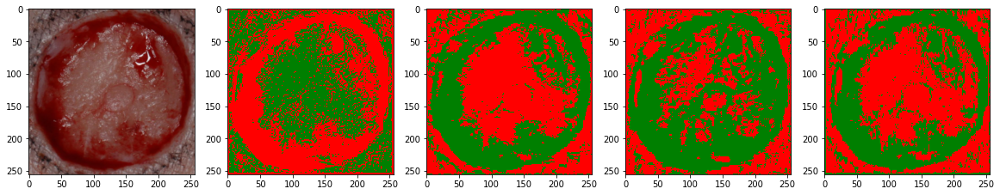

In [ ]:
cluster_and_plot(block14_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

### Block 16 (256x256)

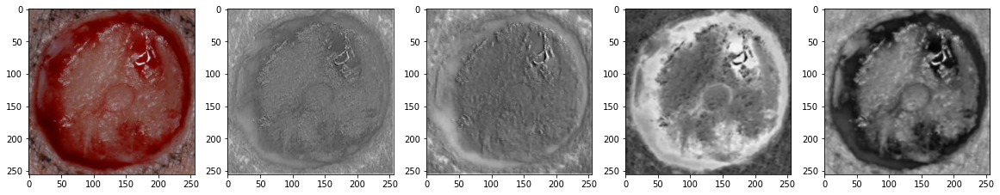

In [ ]:
block16_t50 = np.array(features[7].cpu())
plot_activations(block16_t50[0], num=5, axis=True, init='/content/3J6A0789.JPG')

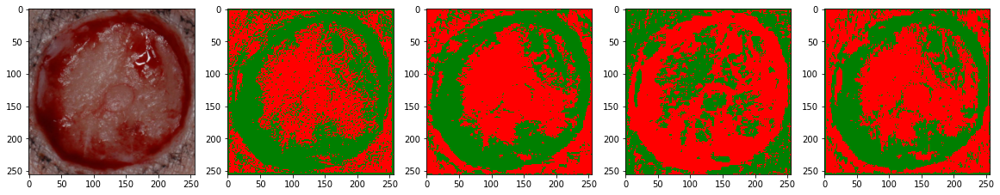

In [ ]:
cluster_and_plot(block14_t50[0], num=5, k=2, init='/content/3J6A0789.JPG')

## Device

In [ ]:
wound_img = read_image('/content/2022-11-11-13-00-38.jpg')
wound_img = wound_img[None].to(dev())
features = feature_extractor(wound_img, noise=noise)
wound_features = collect_features(args, features).cpu()

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

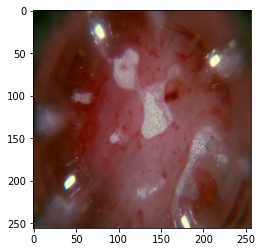

In [ ]:
plt.imshow(wound_img.cpu().numpy()[0].transpose((1, 2, 0)))

### Block 6 (32x32)

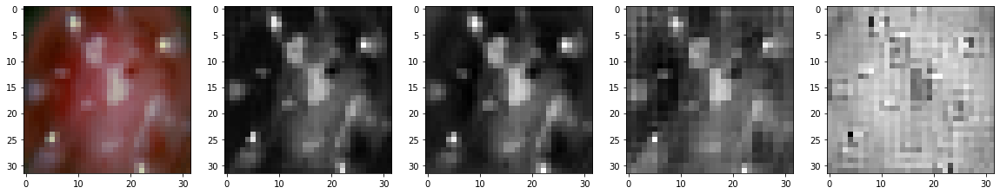

In [ ]:
block6_t50 = np.array(features[1].cpu())
plot_activations(block6_t50[0], num=5, axis=True, init='/content/2022-11-11-13-00-38.jpg')

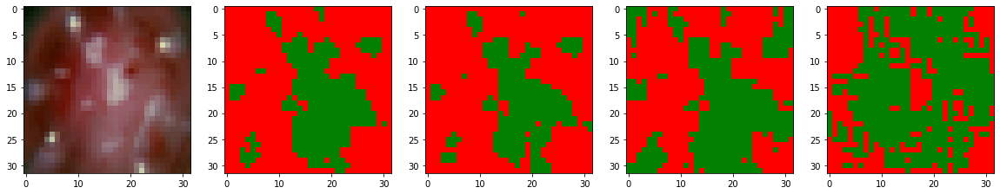

In [ ]:
cluster_and_plot(block6_t50[0], num=5, k=2, init='/content/2022-11-11-13-00-38.jpg')

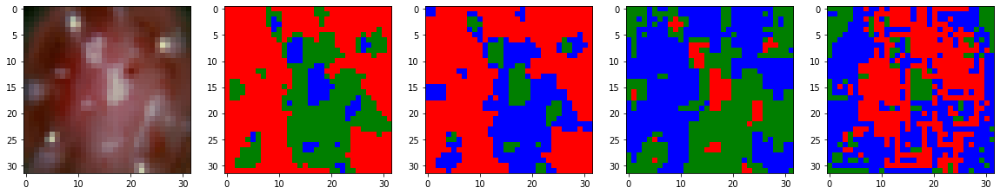

In [ ]:
cluster_and_plot(block6_t50[0], num=5, k=3, init='/content/2022-11-11-13-00-38.jpg')

### Block 8 (64x64)

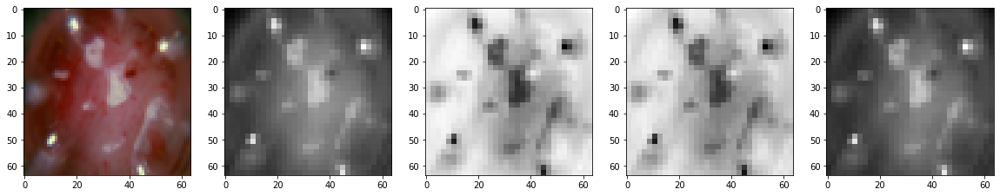

In [ ]:
block8_t50 = np.array(features[3].cpu())
plot_activations(block8_t50[0], num=5, axis=True, init='/content/2022-11-11-13-00-38.jpg')

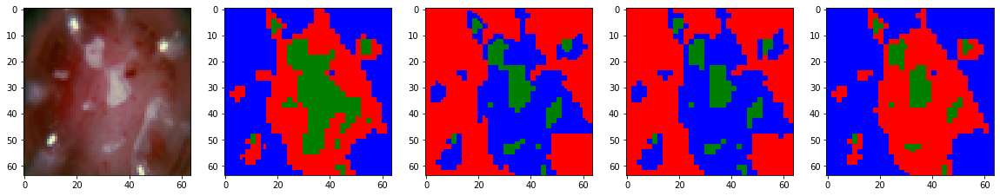

In [ ]:
cluster_and_plot(block8_t50[0], num=5, k=3, init='/content/2022-11-11-13-00-38.jpg')

### Block 12 (128x128)

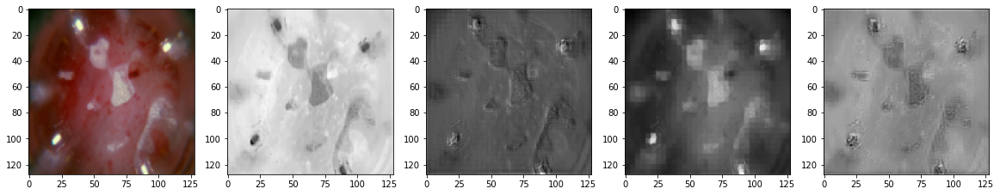

In [ ]:
block12_t50 = np.array(features[5].cpu())
plot_activations(block12_t50[0], num=5, axis=True, init='/content/2022-11-11-13-00-38.jpg')

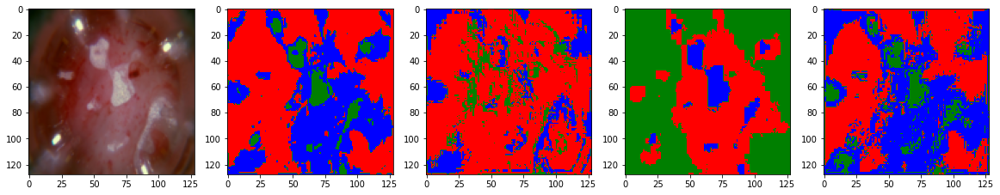

In [ ]:
cluster_and_plot(block12_t50[0], num=5, k=3, init='/content/2022-11-11-13-00-38.jpg')

### Block 14 (256x256)

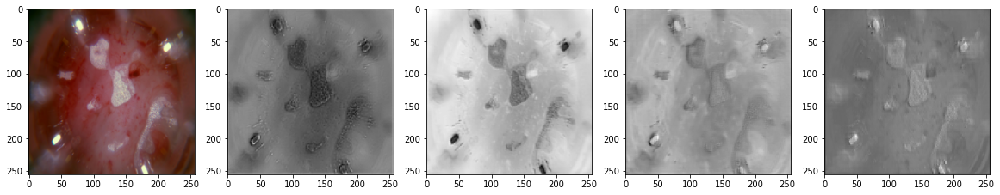

In [ ]:
block14_t50 = np.array(features[6].cpu())
plot_activations(block14_t50[0], num=5, axis=True, init='/content/2022-11-11-13-00-38.jpg')

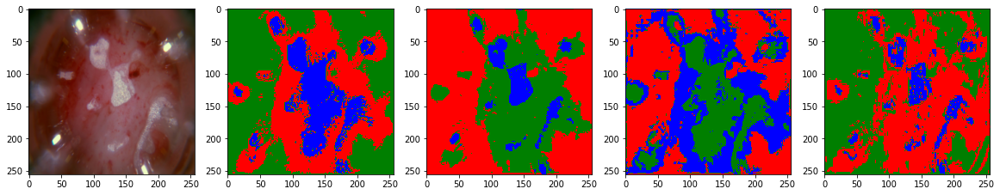

In [ ]:
cluster_and_plot(block14_t50[0], num=5, k=3, init='/content/2022-11-11-13-00-38.jpg')

### Block 16 (256x256)

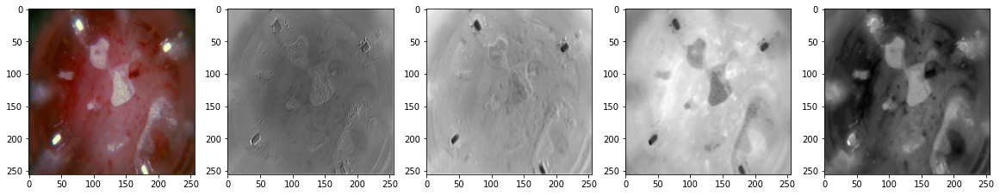

In [ ]:
block16_t50 = np.array(features[7].cpu())
plot_activations(block16_t50[0], num=5, axis=True, init='/content/2022-11-11-13-00-38.jpg')

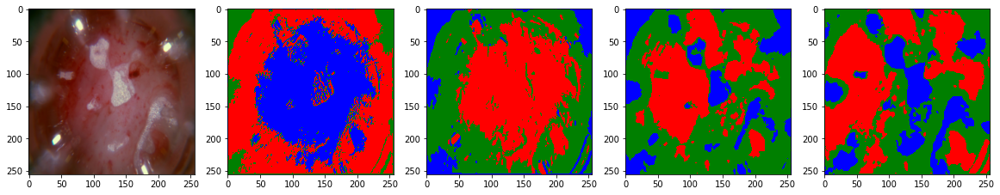

In [ ]:
cluster_and_plot(block16_t50[0], num=5, k=3, init='/content/2022-11-11-13-00-38.jpg')

## SkinCon (DDI / Flitzpatick)

In [ ]:
!gdown 1QJGjZycS4l_aM8-YHeG_NTsr4u7dmKqn
!unzip DDI.zip

Downloading...
From: https://drive.google.com/uc?id=1QJGjZycS4l_aM8-YHeG_NTsr4u7dmKqn
To: /content/ddpm-segmentation/DDI.zip
100% 140M/140M [00:03<00:00, 42.5MB/s]


Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

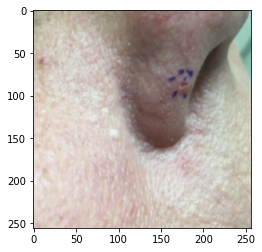

Plotting block 8 of size 64


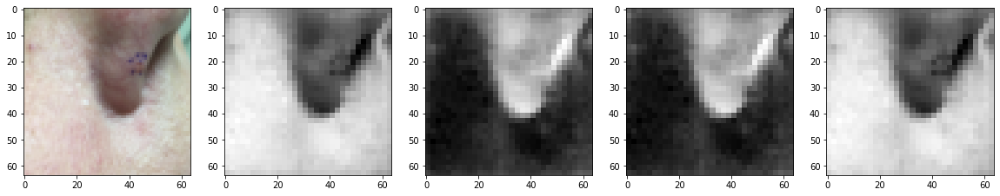

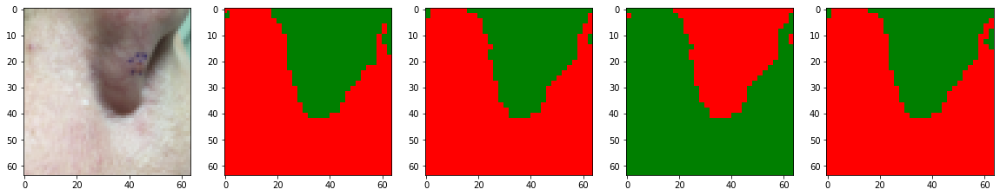

Plotting block 12 of size 128


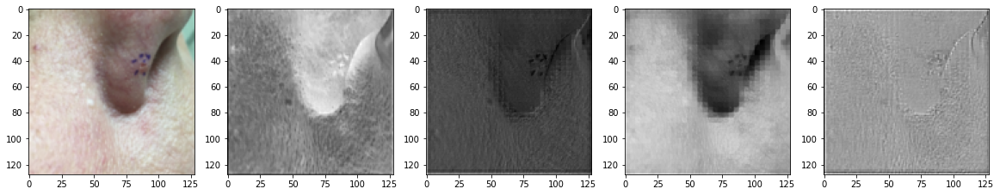

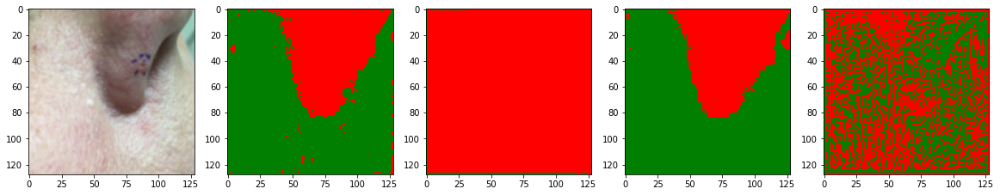

Plotting block 14 of size 256


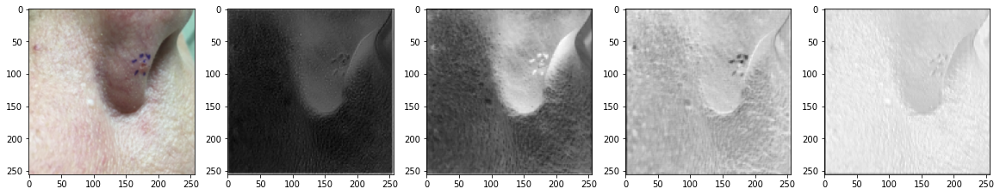

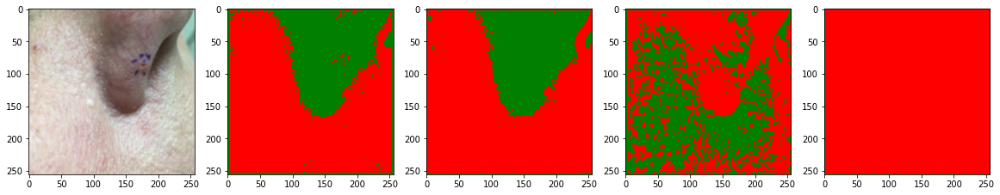

Plotting block 16 of size 256


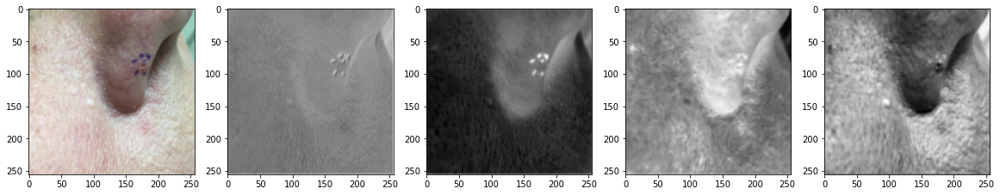

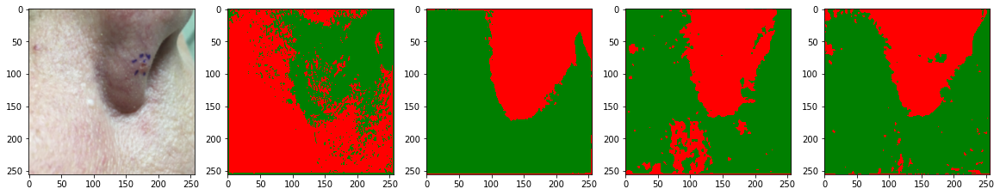

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

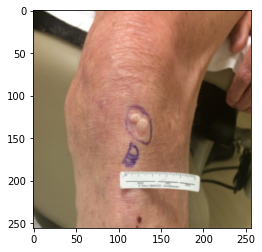

Plotting block 8 of size 64


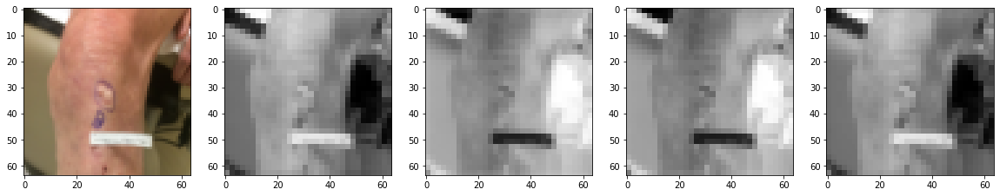

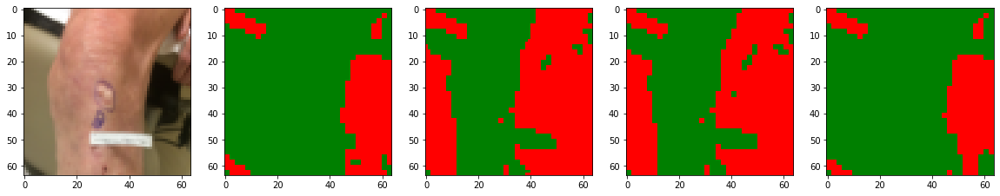

Plotting block 12 of size 128


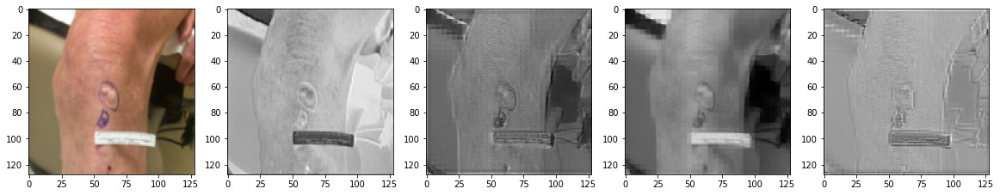

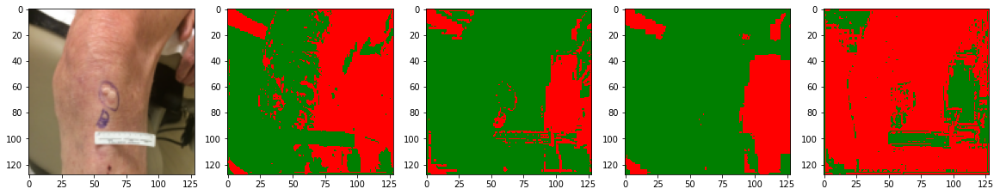

Plotting block 14 of size 256


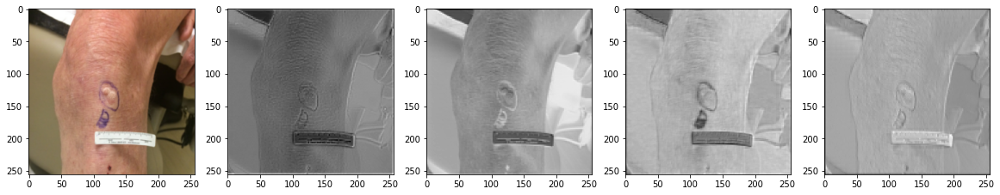

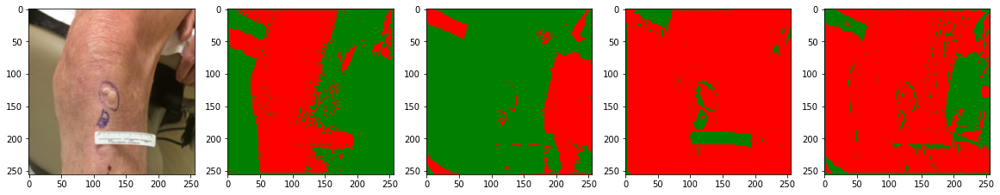

Plotting block 16 of size 256


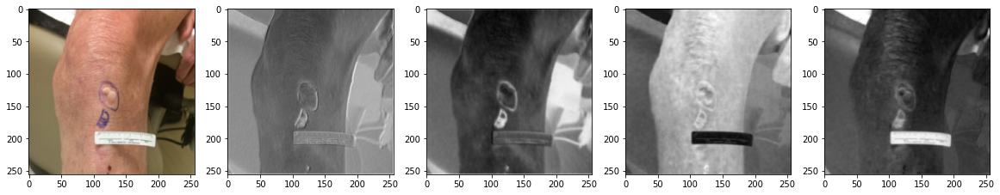

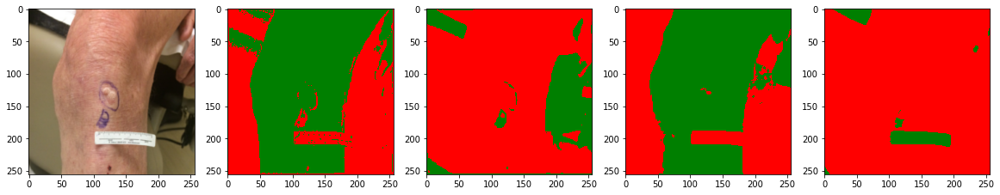

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

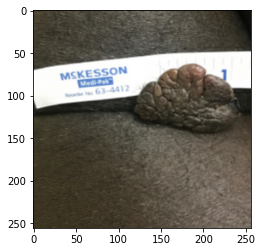

Plotting block 8 of size 64


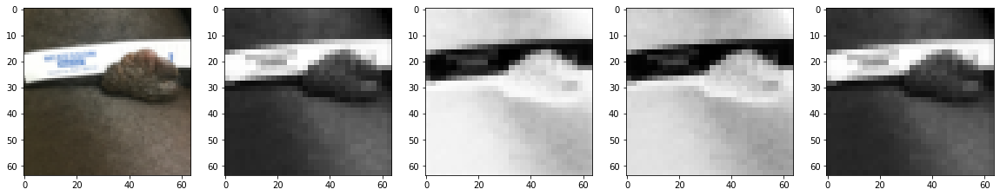

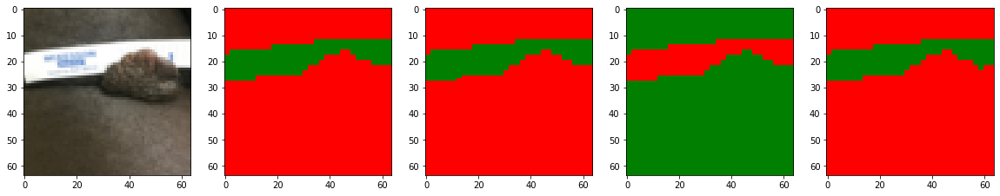

Plotting block 12 of size 128


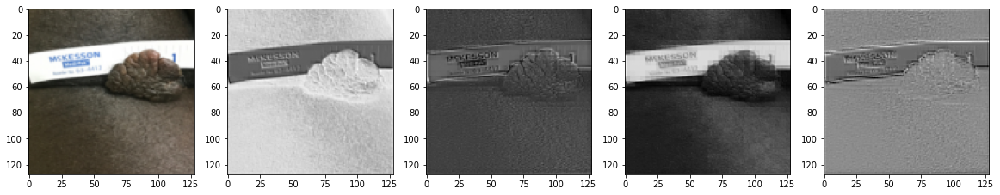

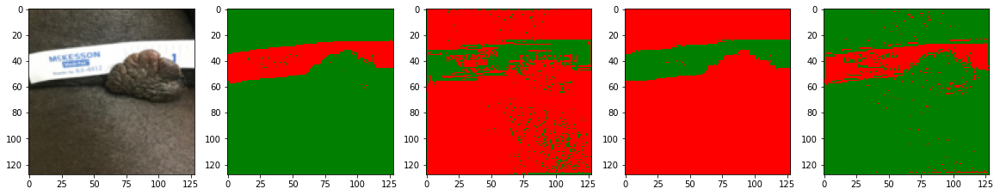

Plotting block 14 of size 256


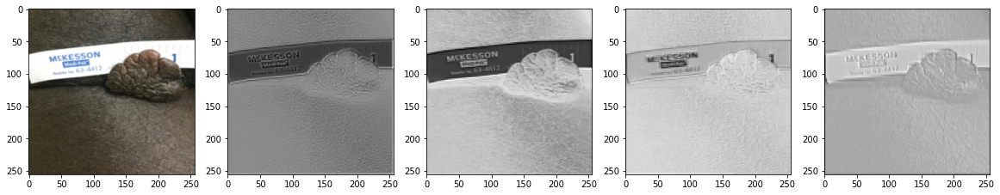

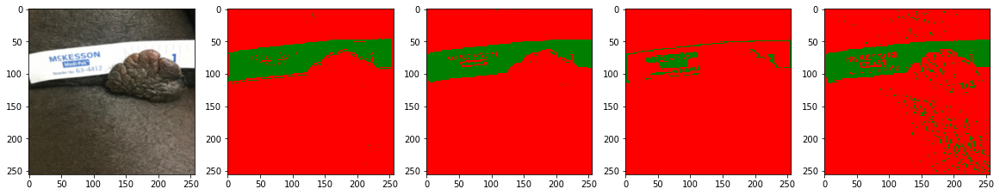

Plotting block 16 of size 256


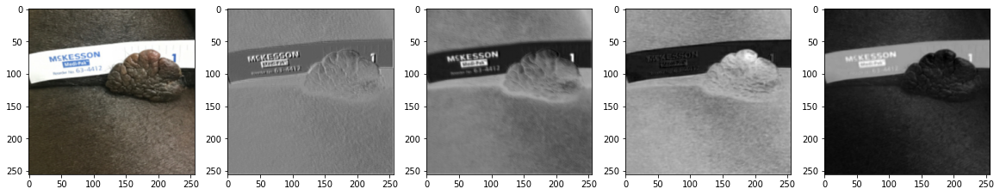

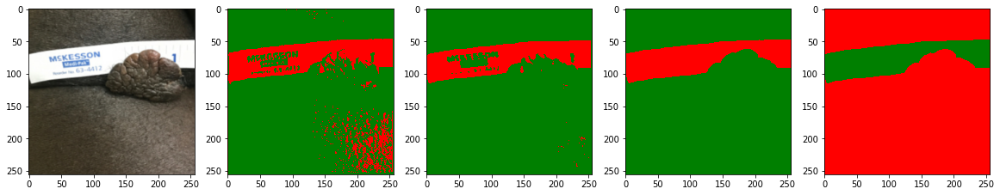

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

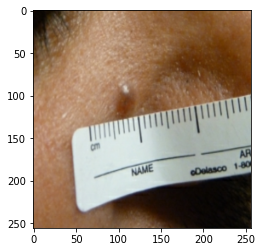

Plotting block 8 of size 64


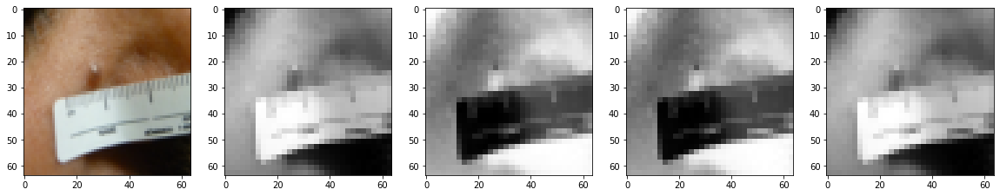

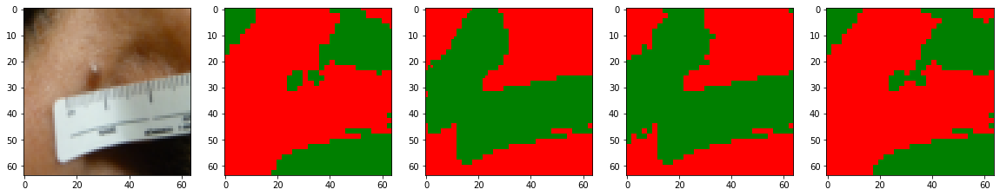

Plotting block 12 of size 128


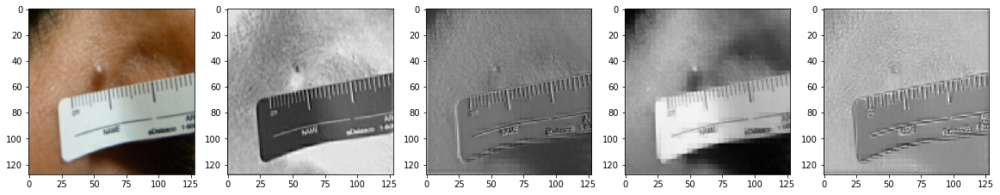

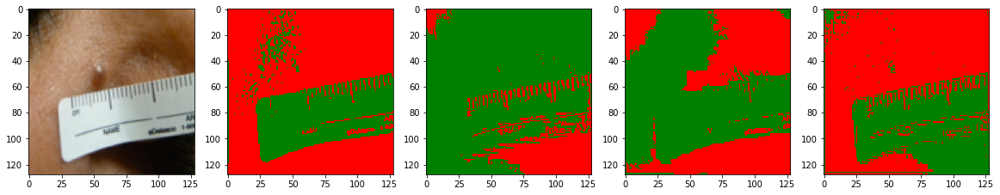

Plotting block 14 of size 256


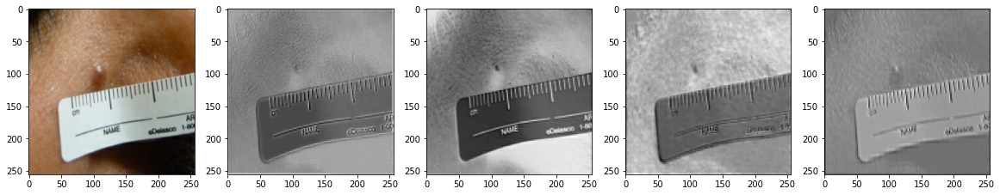

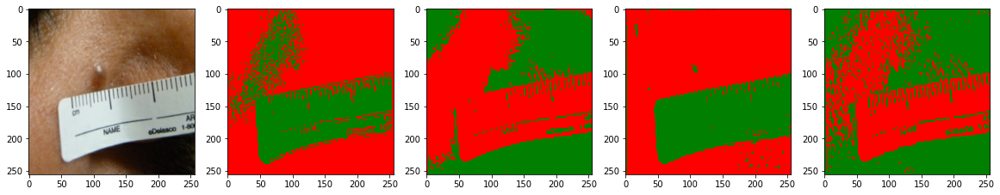

Plotting block 16 of size 256


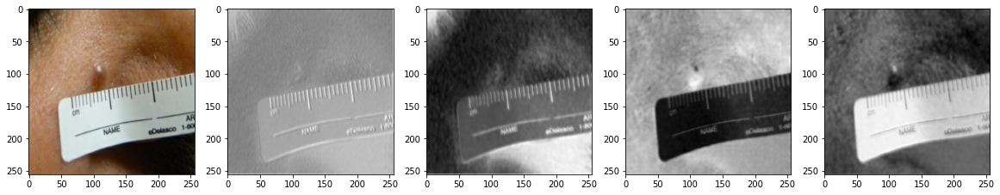

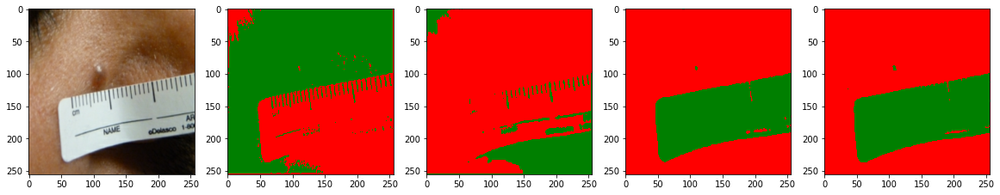

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

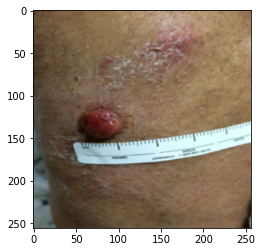

Plotting block 8 of size 64


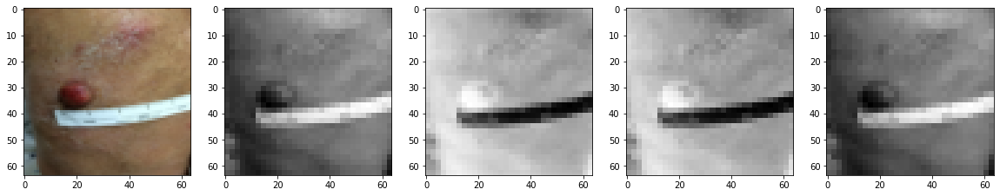

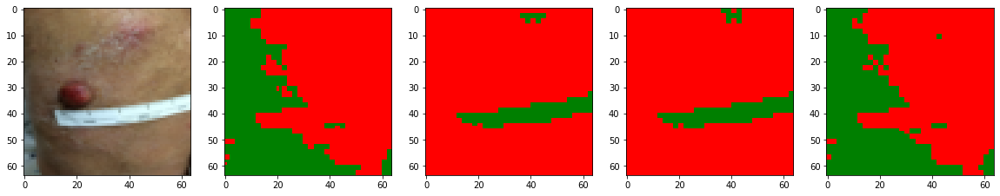

Plotting block 12 of size 128


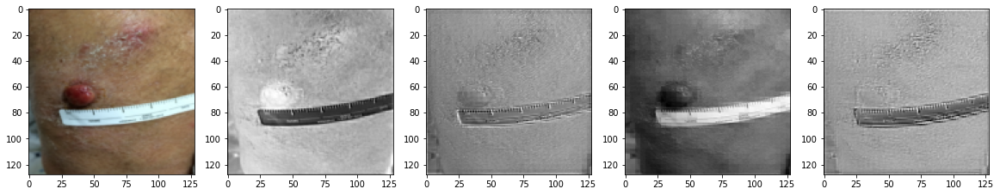

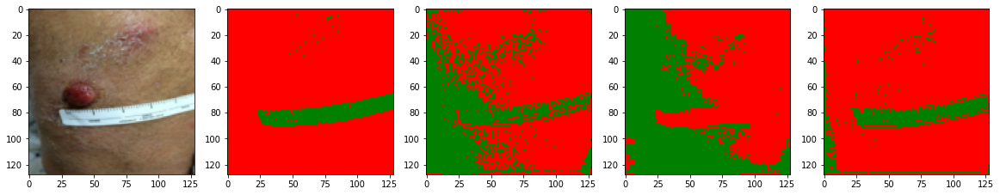

Plotting block 14 of size 256


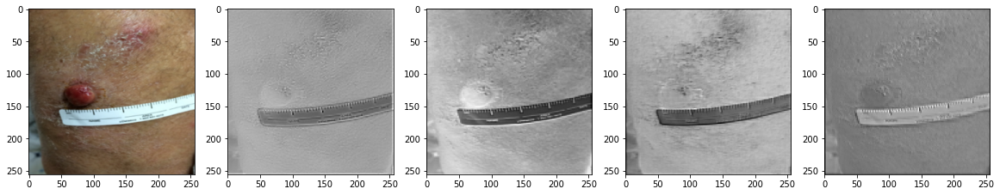

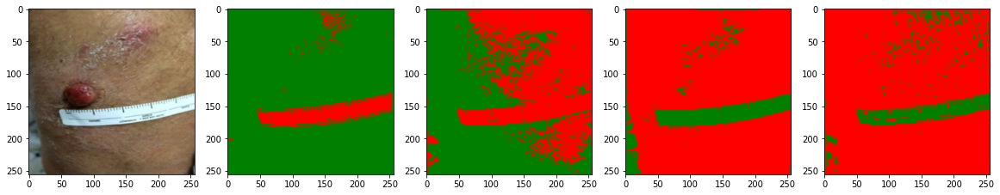

Plotting block 16 of size 256


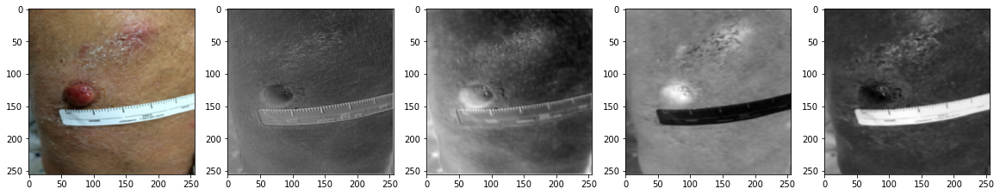

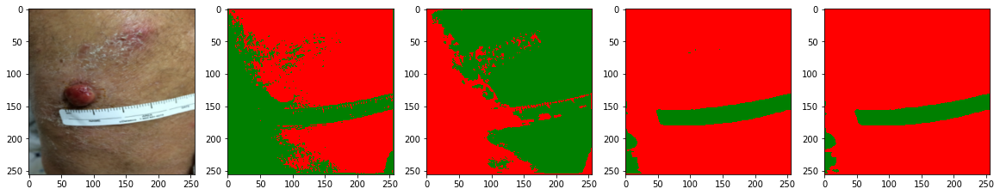

In [ ]:
# read code
base = "/content/ddpm-segmentation/ddidiversedermatologyimages/"
for ddi_fn in os.listdir(base)[:5]:
    wound_img = read_image(base + ddi_fn)
    wound_img = wound_img[None].to(dev())
    features = feature_extractor(wound_img, noise=noise)
    wound_features = collect_features(args, features).cpu()
    print("Original Image")
    plt.imshow(wound_img.cpu().numpy()[0].transpose((1, 2, 0)))
    plt.show()

    for block, idx in zip([8, 12, 14, 16],[3, 5, 6, 7]):
        act = np.array(features[idx].cpu()) # 3, 5, 6, 7 - block 8, 12, 14, 16
        print(f"Plotting block {block} of size {np.array(act[0][0])[0].shape[-1]}")
        plot_activations(act[0], num=5, axis=True, init=(base + ddi_fn))
        cluster_and_plot(act[0], num=5, k=2, init=(base + ddi_fn))

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

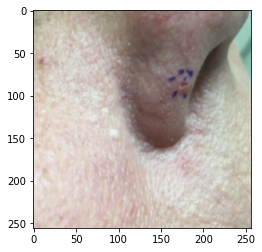

Plotting block 8 of size 64


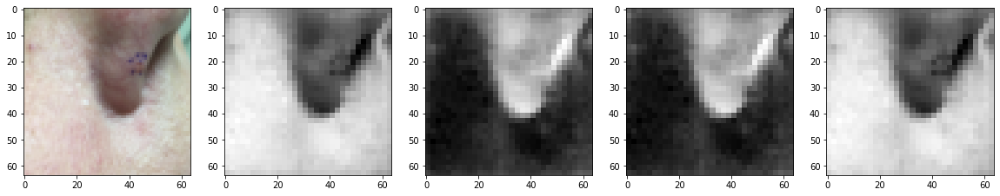

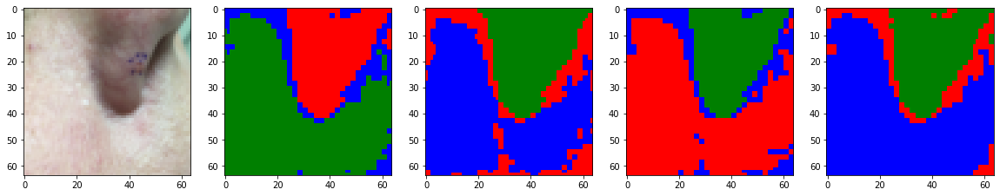

Plotting block 12 of size 128


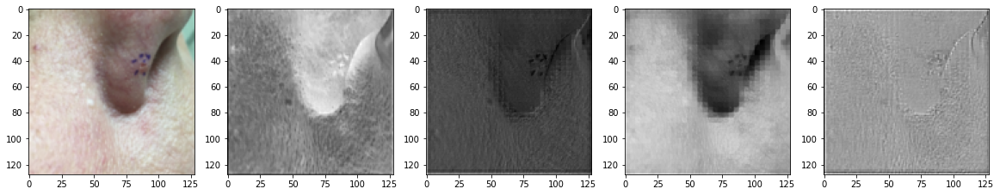

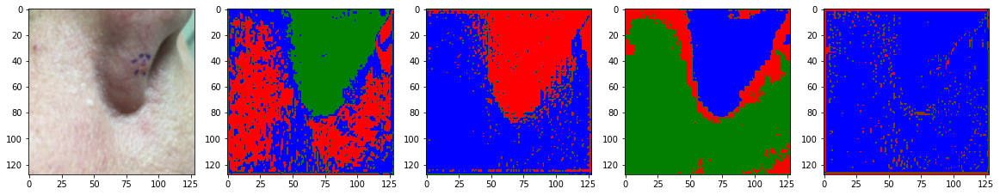

Plotting block 14 of size 256


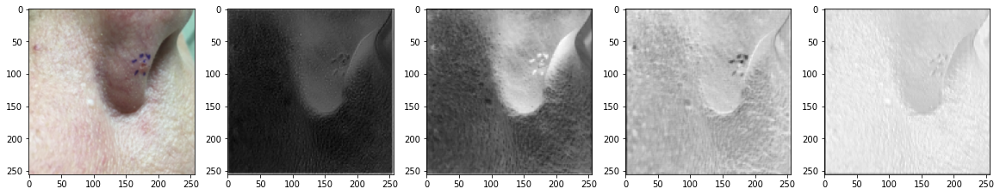

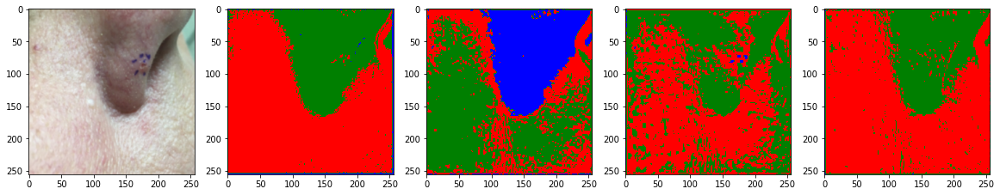

Plotting block 16 of size 256


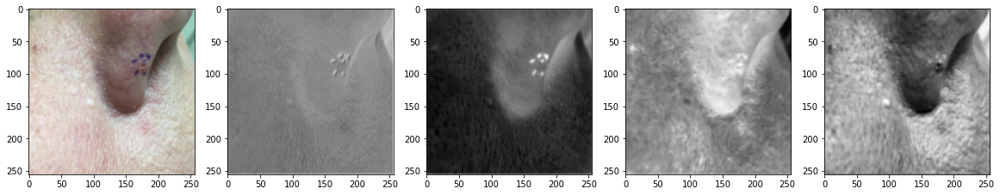

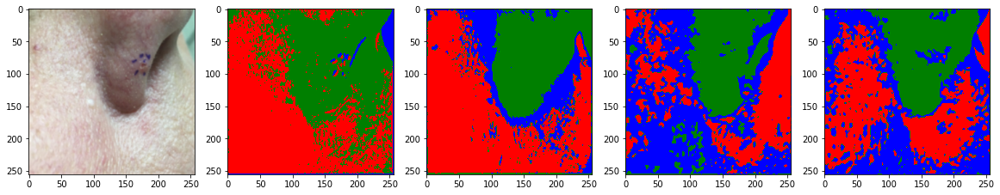

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

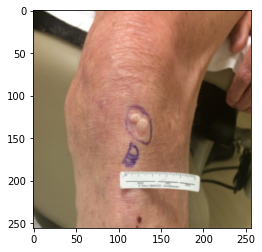

Plotting block 8 of size 64


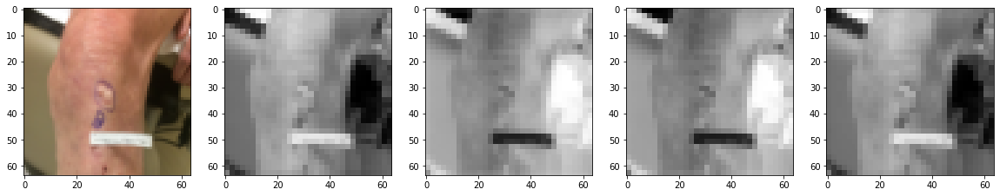

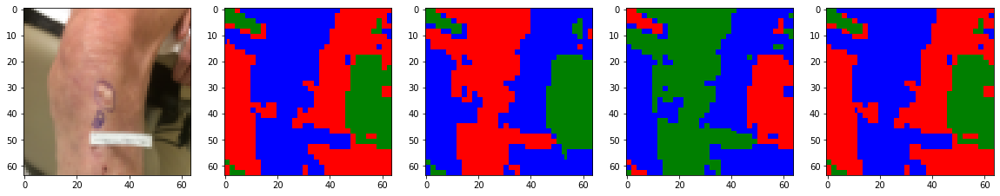

Plotting block 12 of size 128


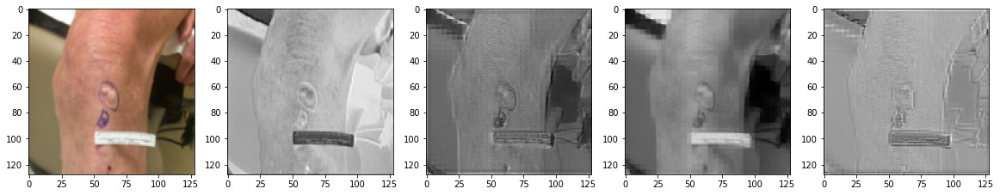

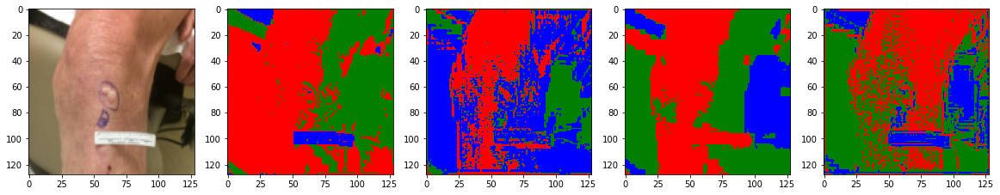

Plotting block 14 of size 256


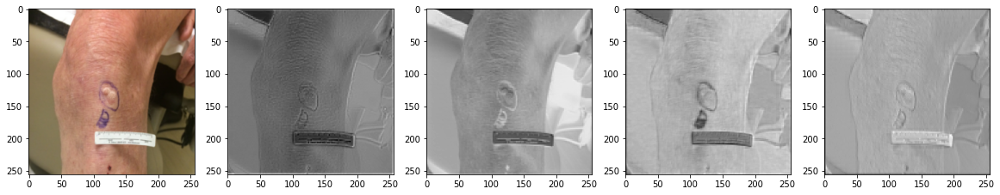

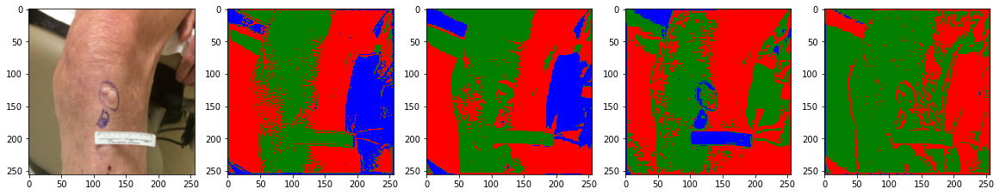

Plotting block 16 of size 256


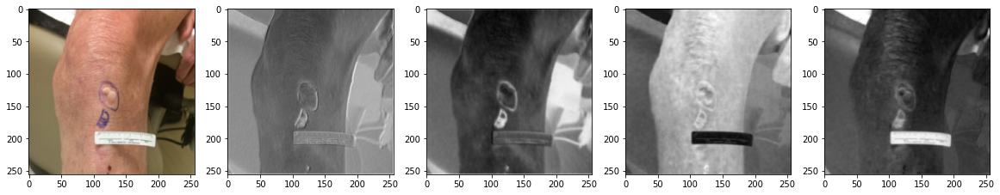

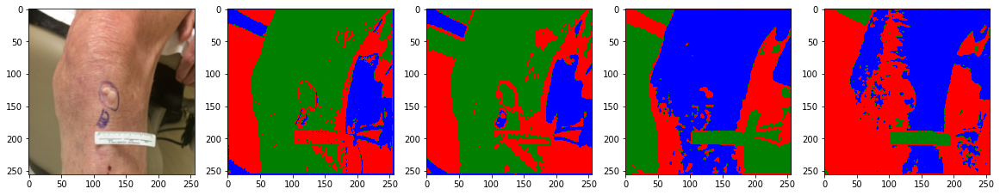

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

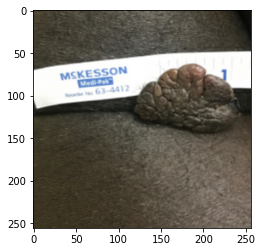

Plotting block 8 of size 64


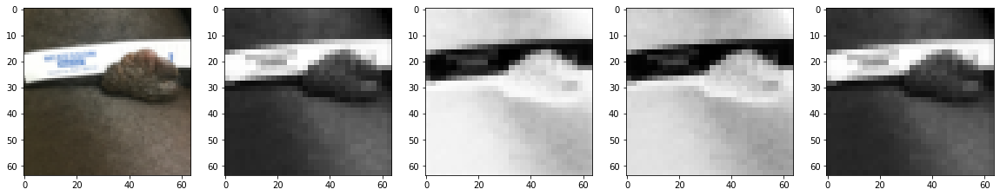

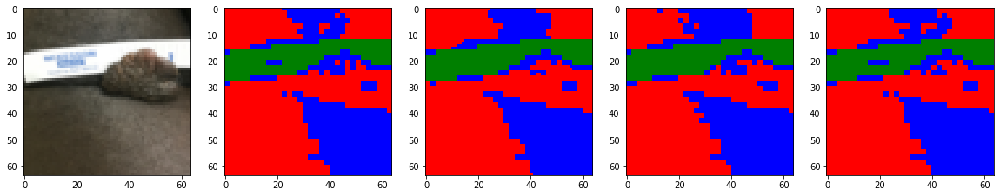

Plotting block 12 of size 128


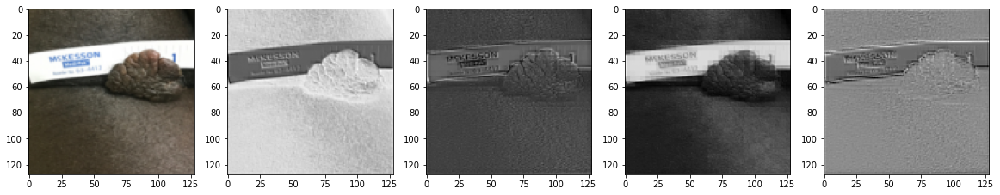

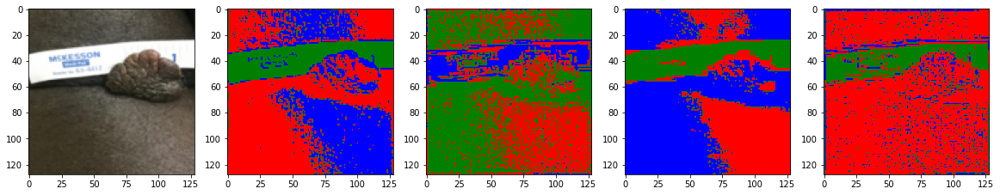

Plotting block 14 of size 256


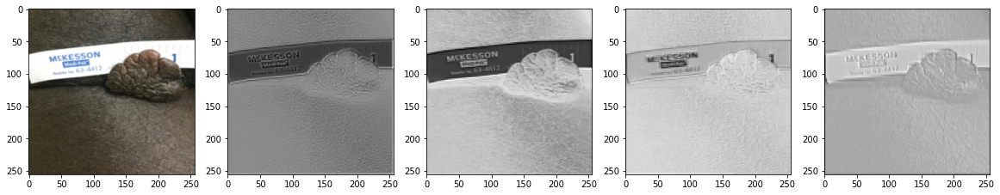

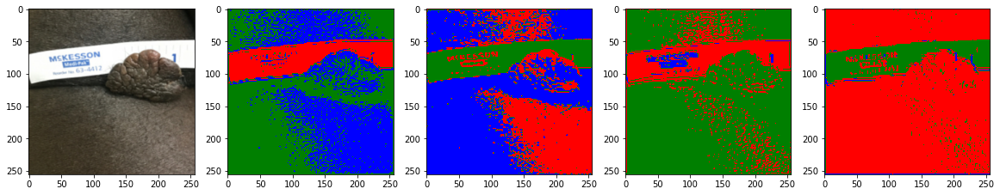

Plotting block 16 of size 256


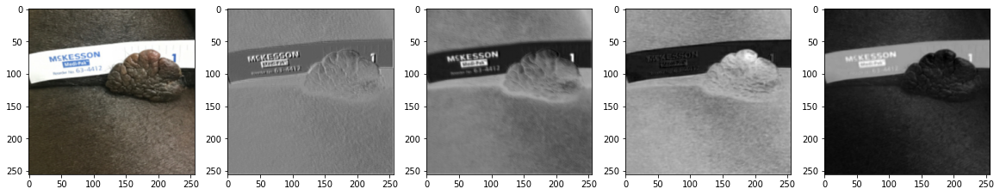

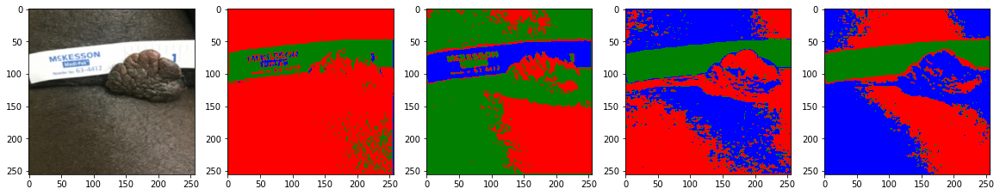

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

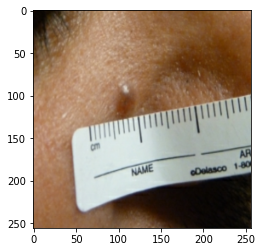

Plotting block 8 of size 64


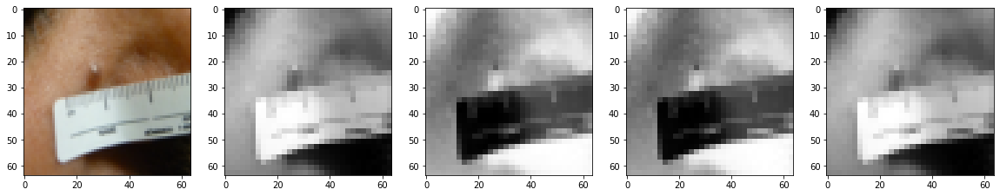

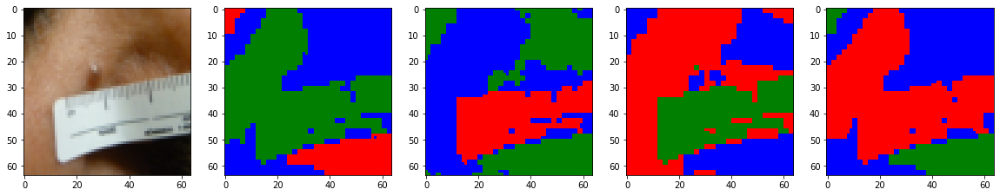

Plotting block 12 of size 128


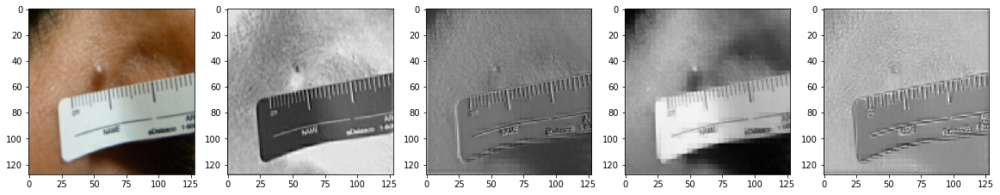

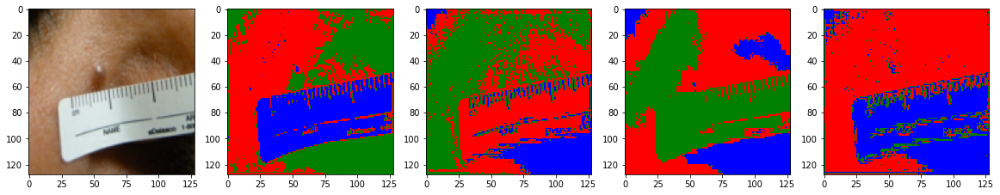

Plotting block 14 of size 256


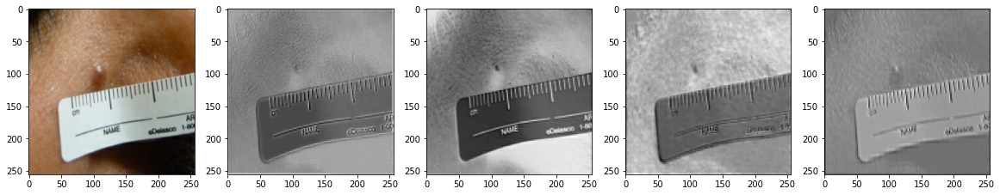

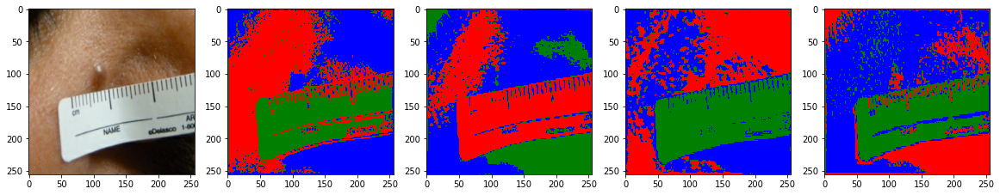

Plotting block 16 of size 256


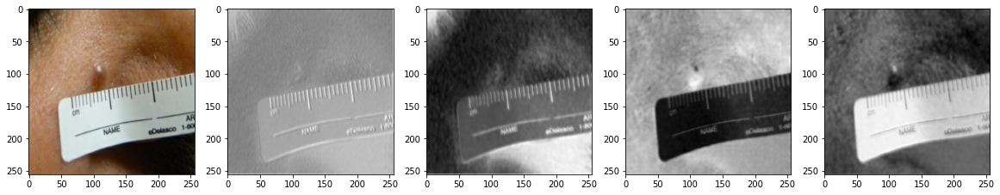

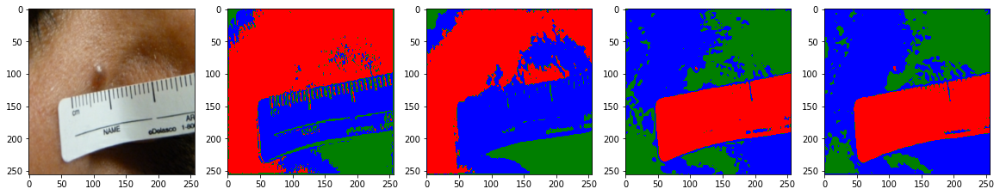

Saving activations at timestep tensor([50], device='cuda:0')
Block number 5 of size torch.Size([1, 1024, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 6 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 7 of size torch.Size([1, 512, 32, 32])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 8 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 10 of size torch.Size([1, 512, 64, 64])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 12 of size torch.Size([1, 256, 128, 128])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 14 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([50], device='cuda:0')
Block number 16 of size torch.Size([1, 256, 256, 256])

Saving activations at timestep tensor([150], device='cuda:0')
Block number 5 

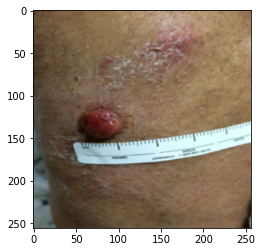

Plotting block 8 of size 64


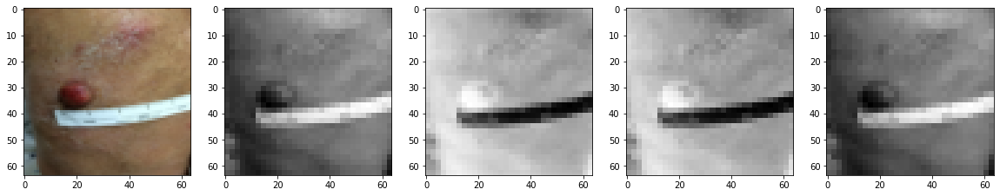

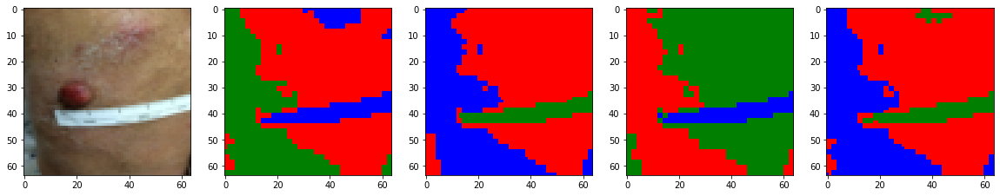

Plotting block 12 of size 128


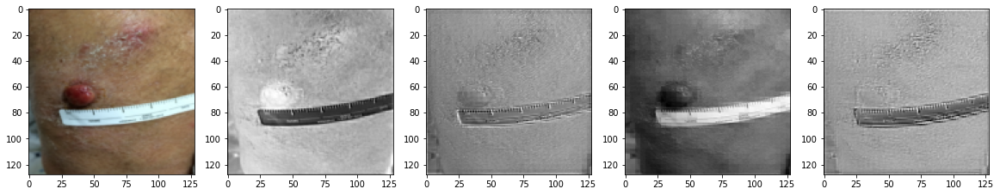

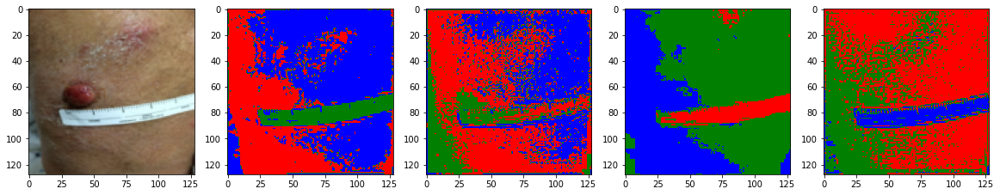

Plotting block 14 of size 256


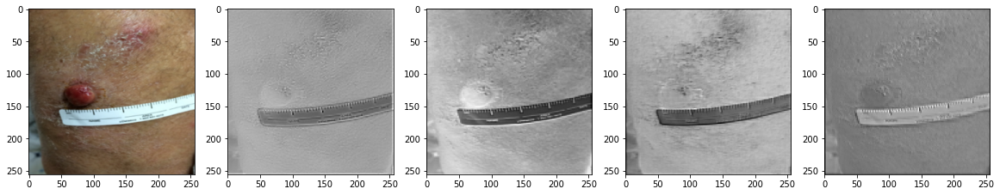

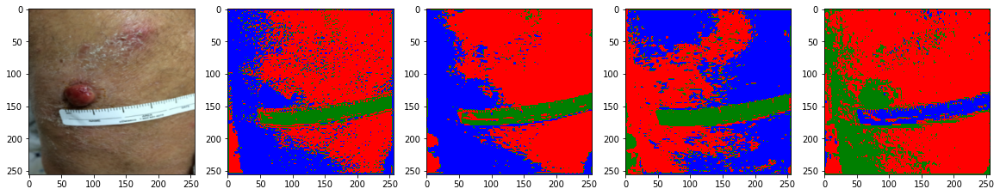

Plotting block 16 of size 256


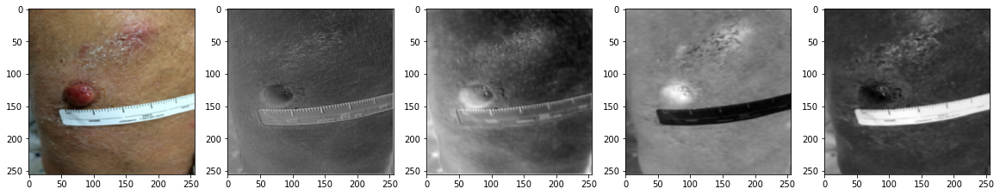

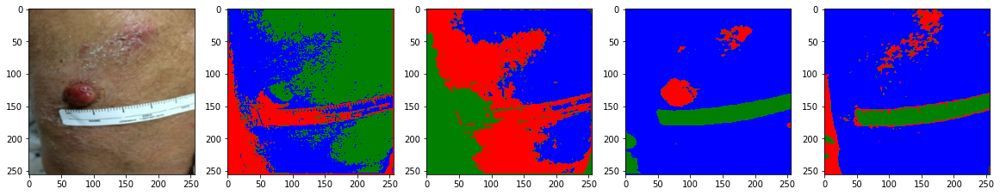

In [ ]:
# read code
base = "/content/ddpm-segmentation/ddidiversedermatologyimages/"
for ddi_fn in os.listdir(base)[:5]:
    wound_img = read_image(base + ddi_fn)
    wound_img = wound_img[None].to(dev())
    features = feature_extractor(wound_img, noise=noise)
    wound_features = collect_features(args, features).cpu()
    print("Original Image")
    plt.imshow(wound_img.cpu().numpy()[0].transpose((1, 2, 0)))
    plt.show()

    for block, idx in zip([8, 12, 14, 16],[3, 5, 6, 7]):
        act = np.array(features[idx].cpu()) # 3, 5, 6, 7 - block 8, 12, 14, 16
        print(f"Plotting block {block} of size {np.array(act[0][0])[0].shape[-1]}")
        plot_activations(act[0], num=5, axis=True, init=(base + ddi_fn))
        cluster_and_plot(act[0], num=5, k=3, init=(base + ddi_fn))

# Supervised train DDI

## Init

In [ ]:
# Load the Drive helper and mount:
from google.colab import drive

# This will prompt for authorization:
drive.mount('/content/drive')

In [ ]:
%cd /content/ddpm-segmentation/

In [ ]:
import tensorflow as tf
import math
from sklearn.metrics import roc_curve, roc_auc_score, f1_score

In [ ]:
import torch
import torch.nn as nn
from tqdm.auto import tqdm
import json
import os
import gc
from PIL import Image
from collections import Counter
import pandas as pd
from torcheval.metrics import BinaryAccuracy
import itertools
from tensorflow.keras import layers
from keras.callbacks import ModelCheckpoint, TensorBoard, ReduceLROnPlateau, EarlyStopping
from keras.models import load_model
from keras.utils import plot_model
from keras.models import Model
from tensorflow.keras.optimizers import Adam

from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from guided_diffusion.guided_diffusion.image_datasets import _list_image_files_recursively

import argparse
from src.utils import setup_seed, multi_acc, colorize_mask
from src.pixel_classifier import  load_ensemble, predict_labels, pixel_classifier
from src.datasets import ImageLabelDataset, FeatureDataset, make_transform
from src.feature_extractors import create_feature_extractor, collect_features

from guided_diffusion.guided_diffusion.script_util import model_and_diffusion_defaults, add_dict_to_argparser
from guided_diffusion.guided_diffusion.dist_util import dev

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_images(images, max_cols=5, axis=True, cmap=None, init='/content/3J6A0789.JPG',
                save=False, path=None):
  # Calculate the number of rows and columns needed
  num_images = len(images)
  num_cols = min(num_images, max_cols)
  num_rows = (num_images - 1) // num_cols + 1

  # Create a figure with a grid of subplots
  fig, axs = plt.subplots(num_rows, num_cols, figsize=(20,10))

  # Plot each image in a subplot
  for i, ax in enumerate(axs.flat):
    if i < num_images:
      if init and i == 0:
        size = np.array(images[0])[0].shape[-1]
        img = read_image(init, size=(size, size), ch_first=False)
        ax.imshow(img)
      else:
        if cmap == 'gray':
          try:
            ax.imshow(images[i], cmap='gray')
          except:
            ax.imshow(images[i].cpu(), cmap='gray')
        elif cmap:
          ax.imshow(images[i], cmap=cmap[i])
        else:
          ax.imshow(images[i])
      if not axis:
        ax.axis('off')

  if save and path:
      plt.savefig(os.path.join(path, "testset_visualizations.pdf"))
  plt.show()

In [ ]:
def prepare_data(args):
    feature_extractor = create_feature_extractor(**args)

    print(f"Preparing the train set for {args['category']}...")
    dataset = ImageLabelDataset(
        data_dir=args['training_path'],
        resolution=args['image_size'],
        num_images=args['training_number'],
        transform=make_transform(
            args['model_type'],
            args['image_size']
        )
    )

    # 256, 256
    X = torch.zeros((len(dataset), *args['dim'][::-1]), dtype=torch.float)
    # dim?
    y = torch.zeros((len(dataset), *args['dim'][:-1]), dtype=torch.uint8)

    if 'share_noise' in args and args['share_noise']:
        rnd_gen = torch.Generator(device=dev()).manual_seed(args['seed'])
        noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())
    else:
        noise = None

    for row, (img, label) in enumerate(tqdm(dataset)):
        img = img[None].to(dev())
        features = feature_extractor(img, noise=noise)
        X[row] = collect_features(args, features).cpu()

        # for target in range(args['number_class']):
        #     if target == args['ignore_label']: continue
        #     # if 0 < (label == target).sum() < 20: # MARK: Should we do this?
        #     #     print(f'Delete small annotation from image {dataset.image_paths[row]} | label {target}')
        #     #     label[label == target] = args['ignore_label']
        y[row] = label

    d = X.shape[1]
    print(f'Total dimension {d}')
    X = X.permute(1,0,2,3).reshape(d, -1).permute(1, 0)
    y = y.flatten()
    return X[y != args['ignore_label']], y[y != args['ignore_label']]

In [ ]:
def compute_iou(args, preds, gts, print_per_class_ious=True):
    class_names = ['background', 'lesion', 'marker', 'ruler', 'skin']

    ids = range(args['number_class'])

    unions = Counter()
    intersections = Counter()

    for pred, gt in zip(preds, gts):
        for target_num in ids:
            if target_num == args['ignore_label']:
                continue
            preds_tmp = (pred == target_num).astype(int)
            gts_tmp = (gt == target_num).astype(int)
            unions[target_num] += (preds_tmp | gts_tmp).sum()
            intersections[target_num] += (preds_tmp & gts_tmp).sum()

    csv = {"Class":[], "IOU":[]}
    ious = []
    for target_num in ids:
        if target_num == args['ignore_label']:
            continue
        iou = intersections[target_num] / (1e-8 + unions[target_num])
        if iou == 0:
            csv["Class"].append(class_names[target_num])
            csv["IOU"].append(-1)
            print(f"No {class_names[target_num]}?")
        else:
            ious.append(iou)
            print(f"IOU for {class_names[target_num]} {iou:.4}")
            csv["Class"].append(class_names[target_num])
            csv["IOU"].append(iou)

    csv["Class"].append("mean")
    csv["IOU"].append(np.array(ious).mean())
    return np.array(ious).mean(), csv

In [ ]:
def save_predictions(args, image_paths, preds, evaluate=True):
    palette = [255, 255, 255,
               255, 74,  70,
               238, 130, 238,
               0,   111, 166,
               60,  179, 113]
    if evaluate:
        dest = 'visualizations'
    else:
        dest = 'validation_visualizations'

    os.makedirs(os.path.join(args['exp_dir'], 'predictions'), exist_ok=True)
    os.makedirs(os.path.join(args['exp_dir'], dest), exist_ok=True)

    for i, pred in enumerate(preds):
        filename = image_paths[i].split('/')[-1].split('.')[0]
        pred = np.squeeze(pred)
        if evaluate:
            np.save(os.path.join(args['exp_dir'], 'predictions', filename + '.npy'), pred)

        mask = colorize_mask(pred, palette)
        Image.fromarray(mask).save(
            os.path.join(args['exp_dir'], dest, filename + '.jpg')
        )

In [ ]:
def evaluation(args, models, split='test', skin='all'):
    feature_extractor = create_feature_extractor(**args)
    if split == 'val':
        if skin == 'all':
            dir = args['validation_path']
            num = args['testing_number'] - 1
        elif skin == 'light':
            dir = args['validation_light']
            num = (args['testing_number'] - 1)//3
        elif skin == 'med':
            dir = args['validation_med']
            num = (args['testing_number'] - 1)//3
        elif skin == 'dark':
            dir = args['validation_dark']
            num = (args['testing_number'] - 1)//3

    elif split == 'test':
        if skin == 'all':
            dir = args['testing_path']
            num = args['testing_number']
        elif skin == 'light':
            dir = args['testing_light']
            num = ((args['testing_number'] - 1)//3) + 1
        elif skin == 'med':
            dir = args['testing_med']
            num = (args['testing_number'] - 1)//3
        elif skin == 'dark':
            dir = args['testing_dark']
            num = (args['testing_number'] - 1)//3

    elif split == 'train':
        dir = args['training_path']
        num = args['training_number']

    dataset = ImageLabelDataset(
            data_dir=dir,
            resolution=args['image_size'],
            num_images=num,
            transform=make_transform(
                args['model_type'],
                args['image_size']
            )
        )


    if 'share_noise' in args and args['share_noise']:
        rnd_gen = torch.Generator(device=dev()).manual_seed(args['seed'])
        noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())
    else:
        noise = None

    preds, gts, uncertainty_scores = [], [], []
    for img, label in tqdm(dataset):
        img = img[None].to(dev())
        features = feature_extractor(img, noise=noise)
        features = collect_features(args, features)

        x = features.view(args['dim'][-1], -1).permute(1, 0)
        pred, uncertainty_score = predict_labels(
            models, x, size=args['dim'][:-1]
        )
        gts.append(label.numpy())
        preds.append(pred.numpy())
        uncertainty_scores.append(uncertainty_score.item())
    if split != 'test':
        save_predictions(args, dataset.image_paths, preds, evaluate=False)
    else:
        save_predictions(args, dataset.image_paths, preds)
    miou, csv = compute_iou(args, preds, gts)
    print(f'Overall mIoU: ', miou)
    print(f'Mean uncertainty: {sum(uncertainty_scores) / len(uncertainty_scores)}')
    return csv

In [ ]:
def predict(args, models, predict_path):
    feature_extractor = create_feature_extractor(**args)
    dataset = ImageLabelDataset(
        data_dir=predict_path,
        resolution=args['image_size'],
        num_images=len(os.listdir(predict_path))//2,
        transform=make_transform(
            args['model_type'],
            args['image_size']
        )
    )

    if 'share_noise' in args and args['share_noise']:
        rnd_gen = torch.Generator(device=dev()).manual_seed(args['seed'])
        noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())
    else:
        noise = None

    preds, uncertainty_scores = [], []
    for img, label in tqdm(dataset):
        img = img[None].to(dev())
        features = feature_extractor(img, noise=noise)
        features = collect_features(args, features)

        x = features.view(args['dim'][-1], -1).permute(1, 0)
        pred, uncertainty_score = predict_labels(
            models, x, size=args['dim'][:-1]
        )
        preds.append(pred.numpy())
        uncertainty_scores.append(uncertainty_score.item())

    save_predictions(args, dataset.image_paths, preds, evaluate=False)
    print("Predictions saved")

In [ ]:
def train(args, epochs=100):
    features, labels = prepare_data(args)
    train_data = FeatureDataset(features, labels)

    print(f" ********* max_label {args['number_class']} *** ignore_label {args['ignore_label']} ***********")
    print(f" *********************** Current number data {len(features)} ***********************")

    train_loader = DataLoader(dataset=train_data, batch_size=args['batch_size'], shuffle=True, drop_last=True)

    print(" *********************** Current dataloader length " +  str(len(train_loader)) + " ***********************")
    for MODEL_NUMBER in range(args['start_model_num'], args['model_num'], 1):

        gc.collect()
        classifier = pixel_classifier(numpy_class=(args['number_class']), dim=args['dim'][-1])
        classifier.init_weights()

        classifier = nn.DataParallel(classifier).cuda()
        criterion = nn.CrossEntropyLoss()
        optimizer = torch.optim.Adam(classifier.parameters(), lr=0.001)
        classifier.train()

        iteration = 0
        break_count = 0
        best_loss = 10000000
        stop_sign = 0
        for epoch in range(epochs):
            for X_batch, y_batch in train_loader:
                X_batch, y_batch = X_batch.to(dev()), y_batch.to(dev())
                y_batch = y_batch.type(torch.long)

                optimizer.zero_grad()
                y_pred = classifier(X_batch)
                loss = criterion(y_pred, y_batch)
                acc = multi_acc(y_pred, y_batch)

                loss.backward()
                optimizer.step()

                iteration += 1
                if iteration % 100000 == 0:
                    print('Epoch : ', str(epoch), 'iteration', iteration, 'loss', loss.item(), 'acc', acc)

                if epoch > 3:
                    if loss.item() < best_loss:
                        best_loss = loss.item()
                        break_count = 0
                    else:
                        break_count += 1

                    if break_count > 50:
                        stop_sign = 1
                        print("*************** Break, Total iters,", iteration, ", at epoch", str(epoch), "***************")
                        break

            if stop_sign == 1:
                break

        model_path = os.path.join(args['exp_dir'],
                                  'model_' + str(MODEL_NUMBER) + '.pth')
        MODEL_NUMBER += 1
        print('save to:', model_path)
        torch.save({'model_state_dict': classifier.state_dict()},
                   model_path)

In [ ]:
def collect_features_cls(args, activations, size=(64,64), sample_idx=0):
    """ Upsample activations and concatenate them to form a feature tensor """
    assert all([isinstance(acts, torch.Tensor) for acts in activations])
    #size = tuple(args['dim'][:-1])
    resized_activations = []
    for feats in activations:
        feats = feats[sample_idx][None]
        feats = nn.functional.interpolate(
            feats, size=size, mode=args["upsample_mode"]
        )
        resized_activations.append(feats[0])

    return torch.cat(resized_activations, dim=0)

In [ ]:
class LinearClassifier(nn.Module):
    def __init__(self, classes, dim):
        super(LinearClassifier, self).__init__()
        self.classes = classes
        self.dim = dim
        self.activation = nn.Sigmoid()
        self.layers = nn.Sequential(
                # nn.Linear(dim, 256),
                # nn.ReLU(),
                # nn.BatchNorm1d(num_features=256),
                # nn.Linear(256, 128),
                # nn.ReLU(),
                # nn.BatchNorm1d(num_features=128),

                # nn.MaxPool2d(kernel_size=2, stride=2),
                # nn.Flatten(),

                nn.Linear(dim, 64),
                nn.Dropout(0.5),
                nn.ReLU(),
                nn.BatchNorm1d(num_features=64),
                nn.Linear(64, 32),
                nn.Dropout(0.25),
                nn.ReLU(),
                nn.BatchNorm1d(num_features=32),
                nn.Linear(32, classes) # Binary Classification -> classes = 1
            )

    def forward(self, x):
        if self.classes == 1:
            return torch.sigmoid(self.layers(x))
        else:
            return self.sofmax(self.layers(x))

In [ ]:
class ImageLabelBinaryDataset(Dataset):
    '''
    :param data_dir: path to a folder with images and their annotations.
                     Annotations are supposed to be in *.npy format.
    :param resolution: image and mask output resolution.
    :param num_images: restrict a number of images in the dataset.
    :param transform: image transforms.
    '''
    def __init__(
        self,
        data_dir: str,
        df_dir: str,
        resolution: int,
        num_images= -1,
        transform=None,
    ):
        super().__init__()
        self.resolution = resolution
        self.transform = transform
        self.image_paths = _list_image_files_recursively(data_dir)
        self.image_paths = sorted(self.image_paths)
        self.df = pd.read_csv(df_dir)

        if num_images > 0:
            print(f"Take first {num_images} images...")
            self.image_paths = self.image_paths[:num_images]

        self.label_paths = [
            (image_path.split('/')[-1])
            for image_path in self.image_paths
        ]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # Load an image
        image_path = self.image_paths[idx]
        pil_image = Image.open(image_path)
        pil_image = pil_image.convert("RGB")
        assert pil_image.size[0] == pil_image.size[1], \
               f"Only square images are supported: ({pil_image.size[0]}, {pil_image.size[1]})"

        tensor_image = self.transform(pil_image)
        # Load a corresponding mask and resize it to (self.resolution, self.resolution)
        label_path = self.label_paths[idx]
        # read csv for this file, check malignant
        if self.df.query(f'DDI_file == "{label_path}"')['malignant'].item():
            label = np.array(1)
        else:
            label = np.array(0)
        tensor_label = torch.from_numpy(label)
        return tensor_image, tensor_label

In [ ]:
def get_poolings(target_size, in_shape):

    if target_size > in_shape[1]:
        min_dims = int(target_size / in_shape[1])
        pool_2d = int(np.log(in_shape[2] / min_dims) / np.log(2))
        prod = in_shape[1] * min_dims * min_dims
        pool_1d = int(np.log(prod / target_size) / np.log(2))

    else:
        pool_2d = int(np.log(in_shape[2]) / np.log(2))
        pool_1d = int(np.log(in_shape[1] / target_size) / np.log(2))

    return pool_2d, pool_1d

In [ ]:
def resize_images(input_folder, output_folder, size=(256, 256)):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for root, dirs, files in os.walk(input_folder):
        for file in files:
            if file.endswith(('.png', '.jpg', '.jpeg')):
                input_path = os.path.join(root, file)
                output_path = os.path.join(output_folder, file)

                with Image.open(input_path) as img:
                    resized_img = img.resize(size)
                    resized_img.save(output_path)

In [ ]:
def prepare_data_cls(args, df_path, target_size, feature_extractor, split='train'):

    print(f"Preparing the {split} set for {args['category']}...")

    if split == 'train':
        d_dir = args['training_path']
        size = args['training_number']

    elif split == 'val' or split == 'test':
        if split == 'val':
            d_dir = args['validation_path']
        else:
            d_dir = args['testing_path']
        size = args['testing_number']

    dataset = ImageLabelBinaryDataset(
            data_dir=d_dir, # here
            df_dir=args['metadata_path'],
            resolution=args['image_size'],
            num_images=size, # here
            transform=make_transform(
                args['model_type'],
                args['image_size']
            )
        )

    y = torch.zeros(size, dtype=torch.uint8)

    if 'share_noise' in args and args['share_noise']:
        rnd_gen = torch.Generator(device=dev()).manual_seed(args['seed'])
        noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())
    else:
        noise = None

    for row, (img, label) in enumerate(tqdm(dataset)):
        img = img[None].to(dev())
        features = feature_extractor(img, noise=noise)

        if row == 0 and len(args['blocks']) == 1:
            raw_size = features[0].shape
            pool_2d, pool_1d = get_poolings(target_size, features[0].shape)

            if pool_1d > 0:
                if target_size > raw_size[1]:
                    min_dims = int(target_size / raw_size[1])
                    X = torch.zeros(size, raw_size[1]*min_dims*min_dims, dtype=torch.float)
                else:
                    X = torch.zeros(size, raw_size[1], dtype=torch.float)
            else:
                X = torch.zeros(size, target_size, dtype=torch.float)

        if len(args['blocks']) > 1:
            raise Exception("Warning... fusing block embeddings, implement")
            c_features = collect_features_cls(args, features).cpu()

        for i in range(pool_2d):
            if i == 0:
                c_features = nn.MaxPool2d(kernel_size=(2,2), stride=2)(features[0])
            else:
                c_features = nn.MaxPool2d(kernel_size=(2,2), stride=2)(c_features)

        c_features = c_features.flatten()

        X[row] = c_features.cpu()
        y[row] = label

    for _ in range(pool_1d):
            X = nn.MaxPool1d(2, stride=2)(X)

    return X, y, raw_size

In [ ]:
def get_elements(a, b):
    return [a[i] for i in b]

In [ ]:
def skin_acc(preds, trues):
    goods = 0
    for pred, gt in zip(preds, trues):
        if gt == 1:
            if pred > 0.5:
                goods += 1
        else:
            if pred <= 0.5:
                goods += 1
    return goods / len(preds)

In [ ]:
def binary_accuracy(predictions, labels, threshold=0.5):
    # Convert predictions to binary values
    predictions = (predictions > threshold).long()

    # Calculate the accuracy
    accuracy = (predictions == labels).float().mean()

    return accuracy.item()

In [ ]:
class FeatureDatasetCls(Dataset):
    '''
    Dataset of the pixel representations and their labels.
    :param X_data: pixel representations [num_pixels, feature_dim]
    :param y_data: pixel labels [num_pixels]
    '''
    def __init__(
        self,
        X_data: torch.Tensor,
        y_data: torch.Tensor
    ):
        self.X_data = X_data
        self.y_data = y_data

    def __getitem__(self, index):
        return self.X_data[index], self.y_data[index]

    def __len__(self):
        return len(self.X_data)

In [ ]:
def train_binary_cls(args, target_size, epochs, batch_size, early_stop):

    ## Loads a backbone network
    feature_extractor = create_feature_extractor(**args)

    ## Uses the backbone network to extract features and grond truth labels
    features, labels, raw_size = prepare_data_cls(args, args['metadata_path'], target_size,
                                        feature_extractor)
    # Debug print
    print(f" ************** Features size {len(features)} ******************")

    ## Simple class that extends `Dataset`, see above for details
    train_data = FeatureDatasetCls(features, labels)

    ## Call to PyTorch's DataLoader
    train_loader = DataLoader(dataset=train_data, batch_size=batch_size,
                              shuffle=True, drop_last=True)

    print(" ******* Dataloader length " +  str(len(train_loader)) + " *******")

    ## Creates a binary classifier from our LinearClassifier class
    binary_classifier = LinearClassifier(classes=1, dim=target_size)

    ## DataParallel (seen on some examples, not sure if needed)
    binary_classifier = nn.DataParallel(binary_classifier).cuda()
    ## BinaryCrossEntropy loss (as we're doing binary classification)
    criterion = nn.BCELoss()
    ## Adam with L2 penalty
    optimizer = torch.optim.Adam(binary_classifier.parameters(), lr=0.0001,
                                 weight_decay=0.00001)
    ## Not sure if this is needed (seen on some examples)
    binary_classifier.train()
    ## Binary acccuracy for our accuracy metric
    metric = BinaryAccuracy()

    ## Some definitions for our loop
    iteration = 0
    break_count = 0
    best_loss = 10000000
    best_vacc = 0.0
    best_tacc = 0.0
    best_test_acc = 0.0
    stop_sign = 0


    ## Prepares the validation data the same way as the training data above
    v_features, v_labels, _ = prepare_data_cls(args, args['metadata_path'],
                                            target_size, feature_extractor,
                                            split='val')

    val_data = FeatureDatasetCls(v_features, v_labels)

    val_loader = DataLoader(dataset=val_data, batch_size=30,
                              shuffle=False, drop_last=True)

    print(" **** Val Dataloader length " +  str(len(val_loader)) + " ****")


    test_features, test_labels, _ = prepare_data_cls(args, args['metadata_path'],
                                            target_size, feature_extractor,
                                            split='test')

    test_data = FeatureDatasetCls(test_features, test_labels)

    test_loader = DataLoader(dataset=test_data, batch_size=30,
                              shuffle=False, drop_last=True)

    print("**** Test Dataloader length " +  str(len(test_loader)) + " ****")

    print("Training...")
    # Epoch loop
    for epoch in range(epochs):
        # batch loop
        for X_batch, y_batch in train_loader:
            binary_classifier.train(True)
            X_batch, y_batch = X_batch.to(dev()), y_batch.to(dev())
            y_batch = y_batch.type(torch.float)

            optimizer.zero_grad()
            y_pred = binary_classifier(X_batch.float())
            #y_pred = y_pred.unsqueeze(1)
            #y_pred = y_pred.float()

            loss = criterion(y_pred, y_batch.unsqueeze(1))
            loss.backward()

            metric.update(torch.squeeze(y_pred).cpu(), y_batch.cpu())
            optimizer.step()

            t_acc = binary_accuracy(y_pred, y_batch.unsqueeze(1))
            iteration += 1
            if iteration % 1000 == 0:
                #acc = metric.compute()
                print('Epoch :', str(epoch+1), 'iteration', iteration, 'loss', loss.item(), 'acc', t_acc)
                # print("For pred, gt:")
                # print(y_pred, y_batch)

            if epoch > 3:
                if loss.item() < best_loss:
                    best_loss = loss.item()
                    break_count = 0
                else:
                    break_count += 1

                if break_count > early_stop:
                    stop_sign = 1
                    print("* Early Stop, Total iters,", iteration, ", at epoch", str(epoch), "*")
                    break


        binary_classifier.train(False)

        test_criterion = nn.BCELoss()
        for test_X_batch, test_y_batch in test_loader:
            X_batch_test, y_batch_test = test_X_batch.to(dev()), test_y_batch.to(dev())
            y_batch_test = y_batch_test.type(torch.float)
            y_pred_test = binary_classifier(X_batch_test.float())
            test_loss = test_criterion(y_pred_test, y_batch_test.unsqueeze(1))
        test_acc = binary_accuracy(y_pred_test, y_batch_test.unsqueeze(1))


        v_criterion = nn.BCELoss()
        for val_X_batch, val_y_batch in val_loader:
            X_batch_val, y_batch_val = val_X_batch.to(dev()), val_y_batch.to(dev())
            y_batch_val = y_batch_val.type(torch.float)
            y_pred_val = binary_classifier(X_batch_val.float())
            v_loss = v_criterion(y_pred_val, y_batch_val.unsqueeze(1))
        v_acc = binary_accuracy(y_pred_val, y_batch_val.unsqueeze(1))

        # better_train_same_val = (math.isclose(v_acc, best_vacc, rel_tol=0.01) and t_acc > best_tacc)
        # better_test_same_val_same_train = (math.isclose(v_acc, best_vacc, rel_tol=0.01) and
        #                                    math.isclose(t_acc, best_tacc, rel_tol=0.01) and
        #                                    test_acc > best_test_acc)

        # if v_acc > best_vacc or (better_train_same_val or better_test_same_val_same_train):

        better_test_same_val = (math.isclose(v_acc, best_vacc, rel_tol=0.01) and test_acc > best_test_acc)
        better_train_same_val_same_test = (math.isclose(v_acc, best_vacc, rel_tol=0.01) and
                                           math.isclose(test_acc, best_test_acc, rel_tol=0.01) and
                                           t_acc > best_tacc)

        if v_acc > best_vacc or (better_test_same_val or better_train_same_val_same_test):

            print(f"* Train Loss: {loss.item()}, Train Acc: {t_acc} *")
            print(f"*** Val Loss: {v_loss.item()}, Val Acc: {v_acc} ***")
            print(f"*** Test Loss: {test_loss.item()}, Test Acc: {test_acc} ***")
            best_test_acc = test_acc
            best_vacc = v_acc
            best_tacc = t_acc
            model_path = os.path.join(args['exp_dir'], 'binary_model.pth')
            print('save to:', model_path)
            torch.save({'model_state_dict': binary_classifier.state_dict()}, model_path)

        if stop_sign == 1:
                break

    return best_tacc, best_vacc, best_test_acc, raw_size

## TF Re-write

In [ ]:
def prepare_data_cls_tf(args, feature_extractor, split='train'):

    print(f"Preparing the {split} set for {args['category']}...")

    if split == 'train':
        d_dir = args['training_path']
        size = args['training_number']

    elif split == 'val' or split == 'test':
        if split == 'val':
            d_dir = args['validation_path']
        else:
            d_dir = args['testing_path']
        size = args['testing_number']

    dataset = ImageLabelBinaryDataset(
            data_dir=d_dir, # here
            df_dir=args['metadata_path'],
            resolution=args['image_size'],
            num_images=size, # here
            transform=make_transform(
                args['model_type'],
                args['image_size']
            )
        )

    if 'share_noise' in args and args['share_noise']:
        rnd_gen = torch.Generator(device=dev()).manual_seed(args['seed'])
        noise = torch.randn(1, 3, args['image_size'], args['image_size'],
                            generator=rnd_gen, device=dev())
    else:
        noise = None

    for row, (img, label) in enumerate(tqdm(dataset)):
        img = img[None].to(dev())
        features = feature_extractor(img, noise=noise)
        if row == 0 and len(args['blocks']) == 1:
            shape = list(features[0].shape)
            shape[0] = size
            X = np.zeros(shape)
            y = np.zeros(size, dtype=np.uint8)
        if len(args['blocks']) > 1:
            print("Warning... fusing block embeddings")
            print("Implement shapes above")
            c_features = collect_features_cls(args, features).cpu()
        else:
            c_features = features[0]

        X[row] = c_features.cpu()
        y[row] = label

    X = np.moveaxis(X, 1, 2)
    X = np.moveaxis(X, 2, 3)

    return X, y

## Malignant / non-malignant

### One-off

#### Settings

In [ ]:
pooling = 6
block = 6
frac = 20
fold = 2
timestep = 100

zoom = "Resized"
kind = "Binary_TF"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Classification/{zoom}"

opts = {
    # ICLR Args
    "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
    "model_type": "ddpm",

    "category": "ddi_binary_cls",
    "number_class": 2,

    "metadata_path": '/content/drive/MyDrive/Winter 2023/DDI/ddi_metadata.csv',
    "training_path": f"{base}/Fold {fold}/{frac}%/train",
    "validation_path": f"{base}/Fold {fold}/{frac}%/val",
    "testing_path": f"{base}/Fold {fold}/{frac}%/test",
    #"model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
    "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    "validation_light": f"{base}/Fold {fold}/val_light",
    "validation_med": f"{base}/Fold {fold}/val_med",
    "validation_dark": f"{base}/Fold {fold}/val_dark",

    "testing_light": f"{base}/Fold {fold}/test_light",
    "testing_med": f"{base}/Fold {fold}/test_med",
    "testing_dark": f"{base}/Fold {fold}/test_dark",

    # Hyper-params
    "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [timestep], # how many steps before grabbing activations
    "blocks": [block], # where to grab activations 8, 10, 12, 14, 16?
    "model_num": 1, # How many MLP's to train

    "batch_size": 64,
    "training_number": frac * 6,
    "testing_number": 30,
    "max_training": frac * 6,

    "seed": 0,
    #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
}

factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
factor = 1024
#global_csv["Image Size"].append(str(opts["dim"]))

opts['dim'].append(factor)

setup_seed(opts['seed'])

# Add model num to path
if len(opts['steps']) > 0:
    suffix = '_'.join([str(step) for step in opts['steps']])
    suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
    suffix += "_" + str(opts['model_num'])
    suffix += "_" + str(frac)
    suffix += "_" + str(fold)
    suffix += "_" + str(pooling)
    if zoom == 'Resized':
        suffix += "_" + zoom
    if kind:
        suffix += "_" + kind

    opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

path = opts['exp_dir']
os.makedirs(path, exist_ok=True)
print('Experiment folder: %s' % (path))

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_1_20_2_6_Resized_Binary_TF


#### Exp

In [ ]:
gc.collect()

0

In [ ]:
feature_extractor = create_feature_extractor(**opts)

Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt


In [ ]:
test = feature_extractor._load_pretrained_model(opts['model_path'])

KeyError: ignored

In [ ]:
x = torch.randn(1, 3, 256, 256, requires_grad=True).cuda()
torch_out = feature_extractor(x)

In [ ]:
feature_extractor.model(x, feature_extractor.diffusion._scale_timesteps([0]))

AttributeError: ignored

In [ ]:
print(feature_extractor)

FeatureExtractorDDPM(
  (model): UNetModel(
    (time_embed): Sequential(
      (0): Linear(in_features=256, out_features=1024, bias=True)
      (1): SiLU()
      (2): Linear(in_features=1024, out_features=1024, bias=True)
    )
    (input_blocks): ModuleList(
      (0): TimestepEmbedSequential(
        (0): Conv2d(3, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      )
      (1): TimestepEmbedSequential(
        (0): ResBlock(
          (in_layers): Sequential(
            (0): GroupNorm32(32, 256, eps=1e-05, affine=True)
            (1): SiLU()
            (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          )
          (h_upd): Identity()
          (x_upd): Identity()
          (emb_layers): Sequential(
            (0): SiLU()
            (1): Linear(in_features=1024, out_features=512, bias=True)
          )
          (out_layers): Sequential(
            (0): GroupNorm32(32, 256, eps=1e-05, affine=True)
            (1): SiLU()
            (2

In [ ]:
!pip install hiddenlayer

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import hiddenlayer as hl

In [ ]:
transforms = [ hl.transforms.Prune('Constant') ] # Removes Constant nodes from graph.

In [ ]:
graph = hl.build_graph(feature_extractor, x, transforms=transforms)

/content/ddpm-segmentation/src/feature_extractors.py:113: TracerWarning: torch.tensor results are registered as constants in the trace. You can safely ignore this warning if you use this function to create tensors out of constant variables that would be the same every time you call this function. In any other case, this might cause the trace to be incorrect.
  t = torch.tensor([t]).to(x.device)
/content/ddpm-segmentation/guided_diffusion/guided_diffusion/gaussian_diffusion.py:201: TracerWarning: Converting a tensor to a Python boolean might cause the trace to be incorrect. We can't record the data flow of Python values, so this value will be treated as a constant in the future. This means that the trace might not generalize to other inputs!
  assert noise.shape == x_start.shape
/content/ddpm-segmentation/guided_diffusion/guided_diffusion/gaussian_diffusion.py:905: TracerWarning: torch.from_numpy results are registered as constants in the trace. You can safely ignore this warning if you

In [ ]:
graph.theme = hl.graph.THEMES['blue'].copy()

In [ ]:
graph.save('/content/ddpm_viz', format='png')

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.246821 to fit


In [ ]:
graph.save('/content/ddpm_viz_hq', format='pdf')

In [ ]:
torch.onnx.export(feature_extractor,               # model being run
                  torch_out[0],                         # model input (or a tuple for multiple inputs)
                  "super_resolution.onnx",   # where to save the model (can be a file or file-like object)
                  export_params=True,        # store the trained parameter weights inside the model file
                  opset_version=10,          # the ONNX version to export the model to
                  do_constant_folding=True,  # whether to execute constant folding for optimization
                  input_names = ['input'],   # the model's input names
                  output_names = ['output'], # the model's output names
                  dynamic_axes={'input' : {0 : 'batch_size'},    # variable length axes
                                'output' : {0 : 'batch_size'}})

/content/ddpm-segmentation/src/feature_extractors.py:113: TracerWarning: torch.tensor results are registered as constants in the trace. You can safely ignore this warning if you use this function to create tensors out of constant variables that would be the same every time you call this function. In any other case, this might cause the trace to be incorrect.
  t = torch.tensor([t]).to(x.device)
/content/ddpm-segmentation/guided_diffusion/guided_diffusion/gaussian_diffusion.py:201: TracerWarning: Converting a tensor to a Python boolean might cause the trace to be incorrect. We can't record the data flow of Python values, so this value will be treated as a constant in the future. This means that the trace might not generalize to other inputs!
  assert noise.shape == x_start.shape
/content/ddpm-segmentation/guided_diffusion/guided_diffusion/gaussian_diffusion.py:905: TracerWarning: torch.from_numpy results are registered as constants in the trace. You can safely ignore this warning if you

RuntimeError: ignored

In [ ]:
!pip install torchviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for torchviz: filename=torchviz-0.0.2-py3-none-any.whl size=4151 sha256=e22e7fe06b121d6c56f068a86d5571d13f15ec1c1adabfb4511f22ed56dde700
  Stored in directory: /root/.cache/pip/wheels/05/7d/1b/8306781244e42ede119edbb053bdcda1c1f424ca226165a417
Successfully built torchviz


In [ ]:
torch_out[0].shape

torch.Size([1, 512, 32, 32])

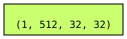

In [ ]:
from torchviz import make_dot

make_dot(torch_out[0], params=dict(feature_extractor.named_parameters()))

In [ ]:
features, labels = prepare_data_cls_tf(opts, feature_extractor, 'train')

Preparing the train set for ddi_binary_cls...
Take first 120 images...


  0%|          | 0/120 [00:00<?, ?it/s]

In [ ]:
train_dataset = tf.data.Dataset.from_tensor_slices((features, labels))
batch_size = opts['training_number']
train_dataset = train_dataset.shuffle(batch_size).batch(batch_size)

In [ ]:
features_val, labels_val = prepare_data_cls_tf(opts, feature_extractor, 'val')

Preparing the val set for ddi_binary_cls...
Take first 30 images...


  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
val_dataset = tf.data.Dataset.from_tensor_slices((features_val, labels_val))
batch_size_val = opts['testing_number']
val_dataset = val_dataset.shuffle(batch_size_val).batch(batch_size_val)

In [ ]:
target_size = 512
downsample_factor = 1/4
in_shape = features.shape[1:]
pooling_layers = int(np.log(target_size/np.prod(in_shape)) / np.log(downsample_factor))
pool_2d_ceiling = int(np.log(in_shape[1]) / np.log(2))

if pool_2d_ceiling >= pooling_layers:
    pool_2d = pooling_layers
    pool_1d = 0
else:
    pool_2d = pool_2d_ceiling
    pool_1d = pooling_layers - pool_2d

In [ ]:
act = 'relu'
input = tf.keras.Input(shape=in_shape, name='ddpm_encoding')
#filters = 512

for i in range(pool_2d):
    if i == 0:
        x = layers.MaxPool2D(pool_size=(2, 2), strides=2)(input)
        #x = layers.Conv2D(filters, kernel_size=(2, 2), strides=2, activation=act)(input)
    else:
        x = layers.MaxPool2D(pool_size=(2, 2), strides=2)(x)
        #filters = filters // 2
        #x = layers.Conv2D(filters, kernel_size=(2, 2), strides=2, activation=act)(x)
x = layers.Flatten()(x)

for _ in range(pool_1d):
    x = layers.MaxPool1D(pool_size=2, strides=2)(x)

x = layers.Dense(64)(x)
x = layers.BatchNormalization()(x)
x = layers.Activation(act)(x) # currently relu try others?
x = layers.Dropout(0.5)(x)

x = layers.Dense(32)(x)
x = layers.BatchNormalization()(x)
x = layers.Activation(act)(x) # currently relu try others?
x = layers.Dropout(0.25)(x)

output = layers.Dense(1, activation='sigmoid')(x)

model = Model(inputs=input, outputs=output)

In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 ddpm_encoding (InputLayer)  [(None, 32, 32, 512)]     0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 16, 16, 512)      0         
 )                                                               
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 8, 8, 512)        0         
 2D)                                                             
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 4, 4, 512)        0         
 2D)                                                             
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 2, 2, 512)        0         
 2D)                                                         

In [ ]:
model.compile(loss="binary_crossentropy", optimizer=Adam(learning_rate=0.0001),
              metrics=["binary_accuracy"])

In [ ]:
best_model_path = os.path.join(opts['exp_dir'], "final_model.h5")

earlystop = EarlyStopping(monitor = 'val_binary_accuracy',
                        mode = "max",
                        min_delta = 0,
                        patience = 50,
                        verbose = 1,
                        restore_best_weights = True)

reduce_lr = ReduceLROnPlateau(monitor='val_binary_accuracy',
                            mode = "max",
                            factor = 0.1,
                            patience = 25,
                            min_lr = 0.00001,
                            verbose = 1)

best_model = ModelCheckpoint(best_model_path,
                             monitor = 'val_binary_accuracy',
                             mode = 'max',
                             verbose = 1,
                             save_best_only = True)

tensor_board = TensorBoard(log_dir = os.path.join(opts['exp_dir'], 'logs/'),
                                        histogram_freq = 0,
                                        write_graph = True,
                                        write_images = False)

In [ ]:
callback_list = [reduce_lr, earlystop, best_model, tensor_board]

history = model.fit(train_dataset,
                    epochs=500,
                    verbose=1,
                    validation_data=val_dataset,
                    callbacks = callback_list)

Epoch 1/500
1/1 [==============================] - ETA: 0s - loss: 0.7717 - binary_accuracy: 0.5250
Epoch 1: val_binary_accuracy improved from -inf to 0.50000, saving model to /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_1_20_2_6_Resized_Binary_TF/final_model.h5
1/1 [==============================] - 5s 5s/step - loss: 0.7717 - binary_accuracy: 0.5250 - val_loss: 6.4467 - val_binary_accuracy: 0.5000 - lr: 1.0000e-04
Epoch 2/500
1/1 [==============================] - ETA: 0s - loss: 0.8290 - binary_accuracy: 0.4917
Epoch 2: val_binary_accuracy did not improve from 0.50000
1/1 [==============================] - 0s 473ms/step - loss: 0.8290 - binary_accuracy: 0.4917 - val_loss: 5.7896 - val_binary_accuracy: 0.5000 - lr: 1.0000e-04
Epoch 3/500
1/1 [==============================] - ETA: 0s - loss: 0.8523 - binary_accuracy: 0.5250
Epoch 3: val_binary_accuracy did not improve from 0.50000
1/1 [==============================] - 1s 612ms/step - loss: 0.8523 - binary_acc

In [ ]:
from google.colab import runtime
runtime.unassign()

### Experiment Loop

In [ ]:
timesteps = list(range(0,1000,50))
timesteps.append(999)
fracs = [5, 10, 15, 20]
target_sizes = [128, 256, 512]
blocks = [10, 12, 14]
folds = [3]

hyperparams = list(itertools.product(timesteps, fracs, target_sizes, blocks, folds))

zoom = "Resized"
kind = "Binary_v3"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Classification/{zoom}"

exp_table_path = os.path.join("/content/drive/MyDrive/Winter 2023/DDPM/",
                              "experiments_ddpm_classifier_v4_b10b12b14_2.csv")

try:
    experiment_table = pd.read_csv(exp_table_path)

except:
    headers = {"Method":[], "DDI Fraction (%)":[], "Fold":[], "Zoom":[],
               "Image Size":[], "Diffusion Timesteps":[], "Blocks":[],
               "Dense Layers":[], "Dropout":[], "L2 Penalty":[], "Raw Embedding":[],
               "Pooling Layers":[], "Final Embedding Size":[],

               "Train Accuracy":[], "Val Accuracy":[], "Test Accuracy":[],

               "Results":[]}

    table = pd.DataFrame.from_dict(headers)
    table.to_csv(exp_table_path, index=False)
    experiment_table = pd.read_csv(exp_table_path)

for timestep, frac, target_size, block, fold in tqdm(hyperparams[500:]):

    gc.collect()
    torch.cuda.empty_cache()

    opts = {
        # ICLR Args
        "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
        "model_type": "ddpm",

        "category": "ddi_binary_cls",
        "number_class": 2,

        "metadata_path": '/content/drive/MyDrive/Winter 2023/DDI/ddi_metadata.csv',
        "training_path": f"{base}/Fold {fold}/{frac}%/train",
        "validation_path": f"{base}/Fold {fold}/{frac}%/val",
        "testing_path": f"{base}/Fold {fold}/{frac}%/test",
        #"model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
        "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

        "validation_light": f"{base}/Fold {fold}/val_light",
        "validation_med": f"{base}/Fold {fold}/val_med",
        "validation_dark": f"{base}/Fold {fold}/val_dark",

        "testing_light": f"{base}/Fold {fold}/test_light",
        "testing_med": f"{base}/Fold {fold}/test_med",
        "testing_dark": f"{base}/Fold {fold}/test_dark",

        # Hyper-params
        "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
        "steps": [timestep], # how many steps before grabbing activations
        "blocks": [block], # where to grab activations 8, 10, 12, 14, 16?
        "model_num": 1, # How many MLP's to train

        "batch_size": 64,
        "training_number": frac * 6,
        "testing_number": 30,
        "max_training": frac * 6,

        "seed": 0,
        #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

        "upsample_mode":"bilinear",
        "share_noise": True,
        "input_activations": False,

        # Guided Diff Flags 64
        "attention_resolutions": "32,16,8",
        "class_cond": False, # uncond
        "diffusion_steps": 1000,
        "dropout": 0.1,
        "image_size": 256,
        "learn_sigma": True,
        "noise_schedule": "linear", # cosine in OpenAi 64
        "num_channels": 256,
        "num_head_channels": 64,
        "num_res_blocks": 2,
        "resblock_updown": True,
        #"use_new_attention_order": True, # not in ICLR 356
        "use_fp16": True,
        "use_scale_shift_norm": True,

        # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
        "channel_mult": "",
        "num_heads": 4,
        "num_heads_upsample": -1,
        "num_heads_channels": -1,
        "timestep_respacing": "",
        "use_kl": False,
        "predict_xstart": False,
        "rescale_timesteps": False,
        "rescale_learned_sigmas": False,
        "use_checkpoint": False, # really?
        "use_new_attention_order": False
    }

    factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
    factor = 1024
    #global_csv["Image Size"].append(str(opts["dim"]))

    opts['dim'].append(factor)

    setup_seed(opts['seed'])

    # Add model num to path
    if len(opts['steps']) > 0:
        suffix = '_'.join([str(step) for step in opts['steps']])
        suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
        suffix += "_" + str(opts['model_num'])
        suffix += "_" + str(frac)
        suffix += "_" + str(fold)
        suffix += "_" + str(target_size)
        if zoom == 'Resized':
            suffix += "_" + zoom
        if kind:
            suffix += "_" + kind

        opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

    path = opts['exp_dir']
    os.makedirs(path, exist_ok=True)
    print('Experiment folder: %s' % (path))

    torch.cuda.empty_cache()
    gc.collect()

    train_acc, val_acc, test_acc, raw_size = train_binary_cls(opts,
                                                    target_size=target_size,
                                                    batch_size=opts['training_number'],
                                                    epochs=5000, early_stop=5000)

    pool_2d, pool_1d = get_poolings(target_size, raw_size)

    experiment_table.loc[len(experiment_table)] = [opts["model_type"], frac, fold,
                                                zoom, str(opts["dim"][:2]),
                                                str(opts['steps']),
                                                str(opts["blocks"]),
                                                3, "[0.5, 0.25]", 0.00001, raw_size,
                                                np.sum([pool_2d, pool_1d]), target_size,
                                                train_acc, val_acc,
                                                test_acc, opts['exp_dir']]

    experiment_table.to_csv(exp_table_path, index=False)

In [ ]:
from google.colab import runtime
runtime.unassign()

Success! Now build a validation data loader to keep track of val loss and val acc. Save model that does the best on val loss / val acc. Maybe raise early stop threshold. Maybe experiment with LR.

DataLoader needs to understand test set too! Write a function to keep track of final accuracy accross an entire epoch (not just accumulate per batch).

with no pooling. block 8 is 512x64x64, block 6 is 512x32x32 (combining them will require upsampling using `collect_features`) A100 is probably needed for block 8 or combinations.

### Collecting metrics

Seed:  0
Will load from: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/800_4_1_5_3_512_Resized_Binary_v3/binary_model.pth
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Preparing the test set for ddi_binary_cls...
Take first 30 images...


  0%|          | 0/30 [00:00<?, ?it/s]

**** Test Dataloader length 1 ****
**** Test Loss: 0.6753798127174377, Test Acc: 0.8000000715255737 ****
Best threshold: 0.50
Seed:  0
Will load from: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/700_12_1_10_3_512_Resized_Binary_v3/binary_model.pth
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Preparing the test set for ddi_binary_cls...
Take first 30 images...


  0%|          | 0/30 [00:00<?, ?it/s]

**** Test Dataloader length 1 ****
**** Test Loss: 0.5655656456947327, Test Acc: 0.8000000715255737 ****
Best threshold: 0.50
Seed:  0
Will load from: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/300_12_1_15_3_512_Resized_Binary_v3/binary_model.pth
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Preparing the test set for ddi_binary_cls...
Take first 30 images...


  0%|          | 0/30 [00:00<?, ?it/s]

**** Test Dataloader length 1 ****
**** Test Loss: 0.5604792833328247, Test Acc: 0.7666667103767395 ****
Best threshold: 0.55
Seed:  0
Will load from: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/400_10_1_20_3_512_Resized_Binary_v3/binary_model.pth
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Preparing the test set for ddi_binary_cls...
Take first 30 images...


  0%|          | 0/30 [00:00<?, ?it/s]

**** Test Dataloader length 1 ****
**** Test Loss: 0.3787992596626282, Test Acc: 0.8666667342185974 ****
Best threshold: 0.69


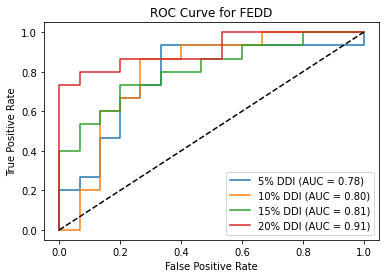

In [ ]:
# 5 @ 0.77, 10 @ 0.8, 0.8, 15 @ 0.77, 0.77, 0.77, 20 @ 0.87
blocks =    [4,   12,  12,  10]
timesteps = [800, 700, 300, 400]
fracs =     [5,   10,  15,  20]

target_size = 512
fold = 3
kind = "Binary_v3"

zoom = "Resized"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Classification/{zoom}"

exp_table_path = os.path.join("/content/drive/MyDrive/Winter 2023/DDPM/",
                              "CLS_Rebuttal.csv")

try:
    experiment_table = pd.read_csv(exp_table_path)

except:
    headers = {"Method":[], "DDI Fraction (%)":[], "Block": [], "Timestep": [],
               "Best Threshold":[], "Overall ROC-AUC":[], "Light ROC-AUC":[],
               "Med ROC-AUC":[], "Dark ROC-AUC":[], "F1":[], "Light F1":[],
               "Med F1":[], "Dark F1":[], "Overall Acc (%)":[],
               "Light Acc (%)":[], "Med Acc (%)":[], "Dark Acc (%)":[]}

    table = pd.DataFrame.from_dict(headers)
    table.to_csv(exp_table_path, index=False)
    experiment_table = pd.read_csv(exp_table_path)


# Load
for block, frac, timestep in zip(blocks, fracs, timesteps):

    opts = {
    # ICLR Args
    "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
    "model_type": "ddpm",

    "category": "ddi_binary_cls",
    "number_class": 2,

    "metadata_path": '/content/drive/MyDrive/Winter 2023/DDI/ddi_metadata.csv',
    "training_path": f"{base}/Fold {fold}/{frac}%/train",
    "validation_path": f"{base}/Fold {fold}/{frac}%/val",
    "testing_path": f"{base}/Fold {fold}/{frac}%/test",
    #"model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
    "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    "validation_light": f"{base}/Fold {fold}/val_light",
    "validation_med": f"{base}/Fold {fold}/val_med",
    "validation_dark": f"{base}/Fold {fold}/val_dark",

    "testing_light": f"{base}/Fold {fold}/test_light",
    "testing_med": f"{base}/Fold {fold}/test_med",
    "testing_dark": f"{base}/Fold {fold}/test_dark",

    # Hyper-params
    "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [timestep], # how many steps before grabbing activations
    "blocks": [block], # where to grab activations 8, 10, 12, 14, 16?
    "model_num": 1, # How many MLP's to train

    "batch_size": 64,
    "training_number": frac * 6,
    "testing_number": 30,
    "max_training": frac * 6,

    "seed": 0,
    #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
    }

    factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
    factor = 1024
    #global_csv["Image Size"].append(str(opts["dim"]))

    opts['dim'].append(factor)

    setup_seed(opts['seed'])

    # Add model num to path
    if len(opts['steps']) > 0:
        suffix = '_'.join([str(step) for step in opts['steps']])
        suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
        suffix += "_" + str(opts['model_num'])
        suffix += "_" + str(frac)
        suffix += "_" + str(fold)
        suffix += "_" + str(target_size)
        if zoom == 'Resized':
            suffix += "_" + zoom
        if kind:
            suffix += "_" + kind

        opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

    print("Will load from:", os.path.join(opts['exp_dir'], 'binary_model.pth'))

    feature_extractor = create_feature_extractor(**opts)

    test_features, test_labels, _ = prepare_data_cls(opts, opts['metadata_path'],
                                            target_size, feature_extractor,
                                            split='test')

    test_data = FeatureDatasetCls(test_features, test_labels)

    test_loader = DataLoader(dataset=test_data, batch_size=opts['testing_number'],
                                shuffle=False, drop_last=True)

    print("**** Test Dataloader length " +  str(len(test_loader)) + " ****")

    model_path = os.path.join(opts['exp_dir'], 'binary_model.pth')
    state_dict = torch.load(model_path)['model_state_dict']
    best_val_model = nn.DataParallel(LinearClassifier(classes=1,
                                                      dim=target_size))
    best_val_model.load_state_dict(state_dict)
    best_val_model = best_val_model.module.to('cuda')
    best_val_model.eval()

    test_criterion = nn.BCELoss()
    for test_X_batch, test_y_batch in test_loader:
        X_batch_test, y_batch_test = test_X_batch.to(dev()), test_y_batch.to(dev())
        y_batch_test = y_batch_test.type(torch.float)
        y_pred_test = best_val_model(X_batch_test.float())
        test_loss = test_criterion(y_pred_test, y_batch_test.unsqueeze(1))
    test_acc = binary_accuracy(y_pred_test, y_batch_test.unsqueeze(1))
    print(f"**** Test Loss: {test_loss.item()}, Test Acc: {test_acc} ****")

    y_true = y_batch_test.unsqueeze(1).cpu().detach().numpy()
    y_hat = y_pred_test.cpu().detach().numpy()

    my_gt = y_true.flatten()
    my_pred = y_hat.flatten()
    dark_idx = [0, 1, 2, 3, 5, 6, 7, 8, 10, 11]
    med_idx = [9, 18, 20, 23, 24, 25, 26, 27, 28, 29]
    light_idx = [4, 12, 13, 14, 15, 16, 17, 19, 21, 22]

    dark_trues = get_elements(y_true.flatten(), dark_idx)
    dark_preds = get_elements(y_hat.flatten(), dark_idx)
    dark_acc = skin_acc(dark_preds, dark_trues)

    med_trues = get_elements(y_true.flatten(), med_idx)
    med_preds = get_elements(y_hat.flatten(), med_idx)
    med_acc = skin_acc(med_preds, med_trues)

    light_trues = get_elements(y_true.flatten(), light_idx)
    light_preds = get_elements(y_hat.flatten(), light_idx)
    light_acc = skin_acc(light_preds, light_trues)

    fpr, tpr, thresholds = roc_curve(y_true, y_hat)
    auc = roc_auc_score(y_true, y_hat)

    light_auc = roc_auc_score(light_trues, light_preds)
    med_auc = roc_auc_score(med_trues, med_preds)
    dark_auc = roc_auc_score(dark_trues, dark_preds)

    plt.plot(fpr, tpr, label=f'{frac}%% DDI (AUC = %0.2f)' % auc)

    best_threshold = 0
    best_diff = 0
    for j in range(len(thresholds)):
        diff = tpr[j] - fpr[j]
        if diff > best_diff:
            best_diff = diff
            best_threshold = thresholds[j]
    print('Best threshold: %0.2f' % best_threshold)

    # for gt in gts:

    y_pred_bin = [int(p > best_threshold) for p in y_hat]
    f1 = f1_score(y_true, y_pred_bin)

    y_pred_bin_light = [int(p > best_threshold) for p in light_preds]
    light_f1 = f1_score(light_trues, y_pred_bin_light)

    y_pred_bin_med = [int(p > best_threshold) for p in med_preds]
    med_f1 = f1_score(med_trues, y_pred_bin_med)

    y_pred_bin_dark = [int(p > best_threshold) for p in dark_preds]
    dark_f1 = f1_score(dark_trues, y_pred_bin_dark)

    experiment_table.loc[len(experiment_table)] = ["DDPM Best", frac, block,
                                                   timestep, best_threshold, auc,
                                                   light_auc, med_auc, dark_auc,
                                                   f1, light_f1, med_f1, dark_f1,
                                                   test_acc, light_acc, med_acc, dark_acc]

    experiment_table.to_csv(exp_table_path, index=False)

plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
title = f'ROC Curve for FEDD'
plt.title(title)
plt.legend(loc='lower right')
plt.savefig("/content/drive/My Drive/Winter 2023/DDPM" + title + ".pdf")
plt.show()

###Collecting metrics rebuttal

In [ ]:
gc.collect()
# 5 @ 0.77, 10 @ 0.8, 0.8, 15 @ 0.77, 0.77, 0.77, 20 @ 0.87
# TODO: Need to recalculate these!
blocks =    [4,   12,  12,  10]
timesteps = [800, 700, 300, 400]
fracs =     [5,   10,  15,  20]

target_size = 512
fold = 3
kind = "Binary_v3"

zoom = "Resized"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Segmentation Labels/{zoom}/Rebuttal/"

exp_table_path = os.path.join("/content/drive/MyDrive/Winter 2023/DDPM/",
                              "CLS_Rebuttal.csv")

try:
    experiment_table = pd.read_csv(exp_table_path)

except:
    headers = {"Method":[], "DDI Fraction (%)":[], "Block": [], "Timestep": [],
               "Best Threshold":[], "Overall ROC-AUC":[], "Light ROC-AUC":[],
               "Med ROC-AUC":[], "Dark ROC-AUC":[], "F1":[], "Light F1":[],
               "Med F1":[], "Dark F1":[], "Overall Acc (%)":[],
               "Light Acc (%)":[], "Med Acc (%)":[], "Dark Acc (%)":[]}

    table = pd.DataFrame.from_dict(headers)
    table.to_csv(exp_table_path, index=False)
    experiment_table = pd.read_csv(exp_table_path)


# Load
for block, frac, timestep in zip(blocks, fracs, timesteps):

    opts = {
    # ICLR Args
    "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
    "model_type": "ddpm",

    "category": "ddi_binary_cls",
    "number_class": 2,

    "metadata_path": '/content/drive/MyDrive/Winter 2023/DDI/ddi_metadata.csv',
    "testing_path": f"{base}/Fold {fold}/cls_test_resized", # contains all images not in train/val of 20%
    #"model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
    "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    # Hyper-params
    "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [timestep], # how many steps before grabbing activations
    "blocks": [block], # where to grab activations 8, 10, 12, 14, 16?
    "model_num": 1, # How many MLP's to train

    "batch_size": 64,
    "training_number": frac * 6,
    "testing_number": 506,
    "max_training": frac * 6,

    "seed": 0,
    #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
    }

    factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
    factor = 1024
    #global_csv["Image Size"].append(str(opts["dim"]))

    opts['dim'].append(factor)

    setup_seed(opts['seed'])

    # Add model num to path
    if len(opts['steps']) > 0:
        suffix = '_'.join([str(step) for step in opts['steps']])
        suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
        suffix += "_" + str(opts['model_num'])
        suffix += "_" + str(frac)
        suffix += "_" + str(fold)
        suffix += "_" + str(target_size)
        if zoom == 'Resized':
            suffix += "_" + zoom
        if kind:
            suffix += "_" + kind

        opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

    print("Will load from:", os.path.join(opts['exp_dir'], 'binary_model.pth'))

    feature_extractor = create_feature_extractor(**opts)

    test_features, test_labels, _ = prepare_data_cls(opts, opts['metadata_path'],
                                            target_size, feature_extractor,
                                            split='test')

    test_data = FeatureDatasetCls(test_features, test_labels)

    test_loader = DataLoader(dataset=test_data, batch_size=opts['testing_number'],
                                shuffle=False, drop_last=True)

    print("**** Test Dataloader length " +  str(len(test_loader)) + " ****")

    model_path = os.path.join(opts['exp_dir'], 'binary_model.pth')
    state_dict = torch.load(model_path)['model_state_dict']
    best_val_model = nn.DataParallel(LinearClassifier(classes=1,
                                                      dim=target_size))
    best_val_model.load_state_dict(state_dict)
    best_val_model = best_val_model.module.to('cuda')
    best_val_model.eval()

    test_criterion = nn.BCELoss()
    for test_X_batch, test_y_batch in test_loader:
        X_batch_test, y_batch_test = test_X_batch.to(dev()), test_y_batch.to(dev())
        y_batch_test = y_batch_test.type(torch.float)
        y_pred_test = best_val_model(X_batch_test.float())
        test_loss = test_criterion(y_pred_test, y_batch_test.unsqueeze(1))
    test_acc = binary_accuracy(y_pred_test, y_batch_test.unsqueeze(1))
    print(f"**** Test Loss: {test_loss.item()}, Test Acc: {test_acc} ****")

    y_true = y_batch_test.unsqueeze(1).cpu().detach().numpy()
    y_hat = y_pred_test.cpu().detach().numpy()

    my_gt = y_true.flatten()
    my_pred = y_hat.flatten()
    dark_idx = [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 26, 27, 28, 29, 31, 32, 33, 34, 36, 37, 38, 39, 43, 44, 45, 46, 47, 48, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79, 80, 81, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 183, 184, 185, 186, 187]
    med_idx = [5, 15, 30, 35, 40, 49, 50, 61, 62, 63, 78, 136, 162, 163, 181, 273, 274, 297, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 399, 400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 501, 502, 503, 504, 505]
    light_idx = [3, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 41, 42, 82, 83, 182, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332]

    dark_trues = get_elements(y_true.flatten(), dark_idx)
    dark_preds = get_elements(y_hat.flatten(), dark_idx)
    dark_acc = skin_acc(dark_preds, dark_trues)

    med_trues = get_elements(y_true.flatten(), med_idx)
    med_preds = get_elements(y_hat.flatten(), med_idx)
    med_acc = skin_acc(med_preds, med_trues)

    light_trues = get_elements(y_true.flatten(), light_idx)
    light_preds = get_elements(y_hat.flatten(), light_idx)
    light_acc = skin_acc(light_preds, light_trues)

    fpr, tpr, thresholds = roc_curve(y_true, y_hat)
    auc = roc_auc_score(y_true, y_hat)

    light_auc = roc_auc_score(light_trues, light_preds)
    med_auc = roc_auc_score(med_trues, med_preds)
    dark_auc = roc_auc_score(dark_trues, dark_preds)

    plt.plot(fpr, tpr, label=f'{frac}%% DDI (AUC = %0.2f)' % auc)

    best_threshold = 0
    best_diff = 0
    for j in range(len(thresholds)):
        diff = tpr[j] - fpr[j]
        if diff > best_diff:
            best_diff = diff
            best_threshold = thresholds[j]
    print('Best threshold: %0.2f' % best_threshold)

    # for gt in gts:

    y_pred_bin = [int(p > best_threshold) for p in y_hat]
    f1 = f1_score(y_true, y_pred_bin)

    y_pred_bin_light = [int(p > best_threshold) for p in light_preds]
    light_f1 = f1_score(light_trues, y_pred_bin_light)

    y_pred_bin_med = [int(p > best_threshold) for p in med_preds]
    med_f1 = f1_score(med_trues, y_pred_bin_med)

    y_pred_bin_dark = [int(p > best_threshold) for p in dark_preds]
    dark_f1 = f1_score(dark_trues, y_pred_bin_dark)

    experiment_table.loc[len(experiment_table)] = ["DDPM Best", frac, block,
                                                   timestep, best_threshold, auc,
                                                   light_auc, med_auc, dark_auc,
                                                   f1, light_f1, med_f1, dark_f1,
                                                   test_acc, light_acc, med_acc, dark_acc]

    experiment_table.to_csv(exp_table_path, index=False)

plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
title = f'ROC Curve for FEDD'
plt.title(title)
plt.legend(loc='lower right')
plt.savefig("/content/drive/My Drive/Winter 2023/DDPM" + title + ".pdf")
plt.show()

In [ ]:
!ls -l /content/drive/MyDrive/Winter\ 2023/DDI/Segmentation\ Labels/Resized/Rebuttal/Fold\ 3/cls_test_resized | wc -l

507


In [ ]:
gc.collect()

timesteps = list(range(0,1000,50))
timesteps.append(999)
fracs = [5, 10, 15, 20]
target_sizes = [128, 256, 512]
blocks = [10, 12, 14]
folds = [3]

hyperparams = list(itertools.product(timesteps, fracs, target_sizes, blocks, folds))

kind = "Binary_v3"
zoom = "Resized"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Segmentation Labels/{zoom}/Rebuttal/"

exp_table_path = os.path.join("/content/drive/MyDrive/Winter 2023/DDPM/",
                              "CLS_Rebuttal_parallel_3.csv")

try:
    experiment_table = pd.read_csv(exp_table_path)

except:
    headers = {"Method":[], "DDI Fraction (%)":[], "Block": [], "Timestep": [],
               "Best Threshold":[], "Overall ROC-AUC":[], "Light ROC-AUC":[],
               "Med ROC-AUC":[], "Dark ROC-AUC":[], "F1":[], "Light F1":[],
               "Med F1":[], "Dark F1":[], "Overall Acc (%)":[],
               "Light Acc (%)":[], "Med Acc (%)":[], "Dark Acc (%)":[]}

    table = pd.DataFrame.from_dict(headers)
    table.to_csv(exp_table_path, index=False)
    experiment_table = pd.read_csv(exp_table_path)


# Load
for timestep, frac, target_size, block, fold in tqdm(hyperparams[:250]):

    opts = {
    # ICLR Args
    "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
    "model_type": "ddpm",

    "category": "ddi_binary_cls",
    "number_class": 2,

    "metadata_path": '/content/drive/MyDrive/Winter 2023/DDI/ddi_metadata.csv',
    "testing_path": f"{base}/Fold {fold}/cls_test_resized", # contains all images not in train/val of 20%
    #"model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
    "model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    # Hyper-params
    "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [timestep], # how many steps before grabbing activations
    "blocks": [block], # where to grab activations 8, 10, 12, 14, 16?
    "model_num": 1, # How many MLP's to train

    "batch_size": 64,
    "training_number": frac * 6,
    "testing_number": 506,
    "max_training": frac * 6,

    "seed": 0,
    #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
    }

    factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
    factor = 1024
    #global_csv["Image Size"].append(str(opts["dim"]))

    opts['dim'].append(factor)

    setup_seed(opts['seed'])

    # Add model num to path
    if len(opts['steps']) > 0:
        suffix = '_'.join([str(step) for step in opts['steps']])
        suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
        suffix += "_" + str(opts['model_num'])
        suffix += "_" + str(frac)
        suffix += "_" + str(fold)
        suffix += "_" + str(target_size)
        if zoom == 'Resized':
            suffix += "_" + zoom
        if kind:
            suffix += "_" + kind

        opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

    print("Will load from:", os.path.join(opts['exp_dir'], 'binary_model.pth'))

    feature_extractor = create_feature_extractor(**opts)

    test_features, test_labels, _ = prepare_data_cls(opts, opts['metadata_path'],
                                            target_size, feature_extractor,
                                            split='test')

    test_data = FeatureDatasetCls(test_features, test_labels)

    test_loader = DataLoader(dataset=test_data, batch_size=opts['testing_number'],
                                shuffle=False, drop_last=True)

    print("**** Test Dataloader length " +  str(len(test_loader)) + " ****")

    model_path = os.path.join(opts['exp_dir'], 'binary_model.pth')
    state_dict = torch.load(model_path)['model_state_dict']
    best_val_model = nn.DataParallel(LinearClassifier(classes=1,
                                                      dim=target_size))
    best_val_model.load_state_dict(state_dict)
    best_val_model = best_val_model.module.to('cuda')
    best_val_model.eval()

    test_criterion = nn.BCELoss()
    for test_X_batch, test_y_batch in test_loader:
        X_batch_test, y_batch_test = test_X_batch.to(dev()), test_y_batch.to(dev())
        y_batch_test = y_batch_test.type(torch.float)
        y_pred_test = best_val_model(X_batch_test.float())
        test_loss = test_criterion(y_pred_test, y_batch_test.unsqueeze(1))
    test_acc = binary_accuracy(y_pred_test, y_batch_test.unsqueeze(1))
    print(f"**** Test Loss: {test_loss.item()}, Test Acc: {test_acc} ****")

    y_true = y_batch_test.unsqueeze(1).cpu().detach().numpy()
    y_hat = y_pred_test.cpu().detach().numpy()

    my_gt = y_true.flatten()
    my_pred = y_hat.flatten()
    dark_idx = [0, 1, 2, 4, 6, 7, 8, 9, 10, 11, 12, 13, 14, 26, 27, 28, 29, 31, 32, 33, 34, 36, 37, 38, 39, 43, 44, 45, 46, 47, 48, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 79, 80, 81, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 183, 184, 185, 186, 187]
    med_idx = [5, 15, 30, 35, 40, 49, 50, 61, 62, 63, 78, 136, 162, 163, 181, 273, 274, 297, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 399, 400, 401, 402, 403, 404, 405, 406, 407, 408, 409, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457, 458, 459, 460, 461, 462, 463, 464, 465, 466, 467, 468, 469, 470, 471, 472, 473, 474, 475, 476, 477, 478, 479, 480, 481, 482, 483, 484, 485, 486, 487, 488, 489, 490, 491, 492, 493, 494, 495, 496, 497, 498, 499, 500, 501, 502, 503, 504, 505]
    light_idx = [3, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 41, 42, 82, 83, 182, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332]

    dark_trues = get_elements(y_true.flatten(), dark_idx)
    dark_preds = get_elements(y_hat.flatten(), dark_idx)
    dark_acc = skin_acc(dark_preds, dark_trues)

    med_trues = get_elements(y_true.flatten(), med_idx)
    med_preds = get_elements(y_hat.flatten(), med_idx)
    med_acc = skin_acc(med_preds, med_trues)

    light_trues = get_elements(y_true.flatten(), light_idx)
    light_preds = get_elements(y_hat.flatten(), light_idx)
    light_acc = skin_acc(light_preds, light_trues)

    fpr, tpr, thresholds = roc_curve(y_true, y_hat)
    auc = roc_auc_score(y_true, y_hat)

    light_auc = roc_auc_score(light_trues, light_preds)
    med_auc = roc_auc_score(med_trues, med_preds)
    dark_auc = roc_auc_score(dark_trues, dark_preds)

    plt.plot(fpr, tpr, label=f'{frac}%% DDI (AUC = %0.2f)' % auc)

    best_threshold = 0
    best_diff = 0
    for j in range(len(thresholds)):
        diff = tpr[j] - fpr[j]
        if diff > best_diff:
            best_diff = diff
            best_threshold = thresholds[j]
    print('Best threshold: %0.2f' % best_threshold)

    # for gt in gts:

    y_pred_bin = [int(p > best_threshold) for p in y_hat]
    f1 = f1_score(y_true, y_pred_bin)

    y_pred_bin_light = [int(p > best_threshold) for p in light_preds]
    light_f1 = f1_score(light_trues, y_pred_bin_light)

    y_pred_bin_med = [int(p > best_threshold) for p in med_preds]
    med_f1 = f1_score(med_trues, y_pred_bin_med)

    y_pred_bin_dark = [int(p > best_threshold) for p in dark_preds]
    dark_f1 = f1_score(dark_trues, y_pred_bin_dark)

    experiment_table.loc[len(experiment_table)] = ["DDPM Best", frac, block,
                                                   timestep, best_threshold, auc,
                                                   light_auc, med_auc, dark_auc,
                                                   f1, light_f1, med_f1, dark_f1,
                                                   test_acc, light_acc, med_acc, dark_acc]

    experiment_table.to_csv(exp_table_path, index=False)

# plt.plot([0, 1], [0, 1], 'k--')
# plt.xlabel('False Positive Rate')
# plt.ylabel('True Positive Rate')
# title = f'ROC Curve for FEDD'
# plt.title(title)
# plt.legend(loc='lower right')
# plt.savefig("/content/drive/My Drive/Winter 2023/DDPM" + title + ".pdf")
# plt.show()

In [ ]:
"/content/drive/My Drive/Winter 2023/DDPM/" + title + ".pdf"

'/content/drive/My Drive/Winter 2023/DDPMROC Curve for FEDD.pdf'

## One-off

In [ ]:
frac = 20
fold = 0
zoom = "Crops"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Segmentation Labels/{zoom}"

opts = {
    # ICLR Args
    "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
    "model_type": "ddpm",

    "category": "ddi_5_crops",
    "number_class": 5,
    "ignore_label": 255,

    "training_path": f"{base}/Fold {fold}/{frac}%/train",
    "validation_path": f"{base}/Fold {fold}/{frac}%/val",
    "testing_path": f"{base}/Fold {fold}/{frac}%/test",
    "model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",
    #"model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",

    # Hyper-params
    "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
    "steps": [100], # how many steps before grabbing activations
    "blocks": [6, 8], # where to grab activations 8, 10, 12, 14, 16?
    "model_num": 5, # How many MLP's to train

    "batch_size": 64,
    "training_number": frac * 6,
    "testing_number": 16,
    "max_training": frac * 6,

    "seed": 0,
    #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

    "upsample_mode":"bilinear",
    "share_noise": True,
    "input_activations": False,

    # Guided Diff Flags 64
    "attention_resolutions": "32,16,8",
    "class_cond": False, # uncond
    "diffusion_steps": 1000,
    "dropout": 0.1,
    "image_size": 256,
    "learn_sigma": True,
    "noise_schedule": "linear", # cosine in OpenAi 64
    "num_channels": 256,
    "num_head_channels": 64,
    "num_res_blocks": 2,
    "resblock_updown": True,
    #"use_new_attention_order": True, # not in ICLR 356
    "use_fp16": True,
    "use_scale_shift_norm": True,

    # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
    "channel_mult": "",
    "num_heads": 4,
    "num_heads_upsample": -1,
    "num_heads_channels": -1,
    "timestep_respacing": "",
    "use_kl": False,
    "predict_xstart": False,
    "rescale_timesteps": False,
    "rescale_learned_sigmas": False,
    "use_checkpoint": False, # really?
    "use_new_attention_order": False
}

factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
factor = 1024

opts['dim'].append(factor)

setup_seed(opts['seed'])

# Add model num to path
if len(opts['steps']) > 0:
    suffix = '_'.join([str(step) for step in opts['steps']])
    suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
    suffix += "_" + str(opts['model_num'])
    suffix += "_" + str(frac)
    opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

path = opts['exp_dir']
os.makedirs(path, exist_ok=True)
print('Experiment folder: %s' % (path))
## We should save the experimental setup opts to exp_dir
#os.system('cp %s %s' % (opts['exp'], opts['exp_dir']))

# Check whether all models in ensemble are trained
pretrained = [os.path.exists(os.path.join(opts['exp_dir'], f'model_{i}.pth'))
                for i in range(opts['model_num'])]
json_obj = json.dumps(opts)
f = open(os.path.join(path, "settings.json"), "w")
f.write(json_obj)
f.close()

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_15


In [ ]:
if not all(pretrained):
    # train all remaining models
    opts['start_model_num'] = sum(pretrained)
    train(opts)

Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Preparing the train set for ddi_5_crops...
Take first 90 images...


  1%|          | 1/90 [00:01<02:04,  1.40s/it]

Delete small annotation from image /content/drive/MyDrive/Winter 2023/DDI/Segmentation Labels/Crops/Fold 0/15%/train/000001.png | label 0


100%|██████████| 90/90 [00:42<00:00,  2.11it/s]


Total dimension 1024
 ********* max_label 5 *** ignore_label 255 ***********
 *********************** Current number data 5898239 ***********************
 *********************** Current dataloader length 92159 ***********************
Epoch :  0 iteration 1000 loss 0.06016692891716957 acc tensor(96.8750, device='cuda:0')
Epoch :  0 iteration 2000 loss 0.09381169080734253 acc tensor(95.3125, device='cuda:0')
Epoch :  0 iteration 3000 loss 0.06335420906543732 acc tensor(96.8750, device='cuda:0')


KeyboardInterrupt: ignored

In [ ]:
print('Loading pretrained models...')
models = load_ensemble(opts, device='cuda')
eval_dict = evaluation(opts, models)

Loading pretrained models...
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt
Take first 16 images...


100%|██████████| 16/16 [00:01<00:00,  9.54it/s]


IOU for background 0.527
IOU for lesion 0.7474
IOU for marker 0.676
IOU for ruler 0.9335
IOU for skin 0.9467
Overall mIoU:  0.7661250695723375
Mean uncertainty: 0.14513102546334267


In [ ]:
df = pd.DataFrame.from_dict(eval_dict)
df.to_csv(os.path.join(path, "metrics.csv"), index=False)

#### Visualize

In [ ]:
test_output = os.path.join(path, "visualizations")
test_gt = opts['testing_path']

In [ ]:
test_out = os.listdir(test_output)
viz = []
for fn in test_out:
    gt = fn.split(".")[0] + ".png"
    gt = os.path.join(test_gt, gt)

    out = os.path.join(test_output, fn)

    with Image.open(gt) as img:
    # Convert the image to a NumPy array
        viz.append(np.array(img))

    with Image.open(out) as img:
    # Convert the image to a NumPy array
        viz.append(np.array(img))

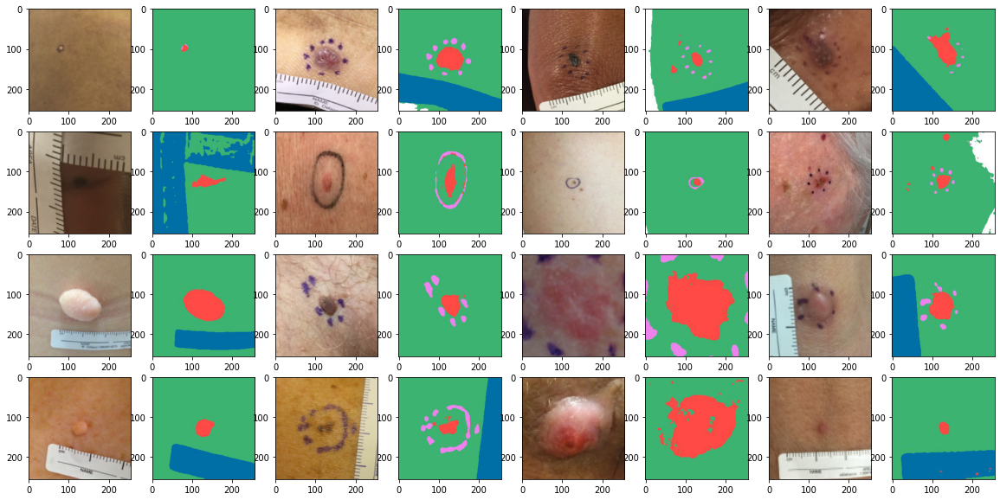

In [ ]:
plot_images(viz, max_cols=8, init=None)

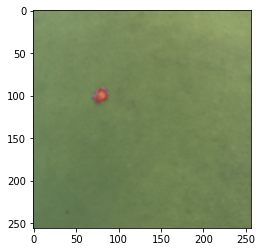

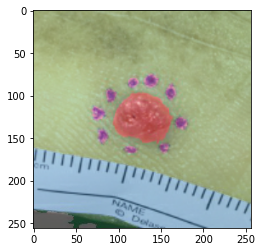

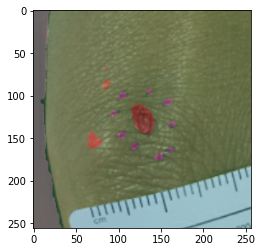

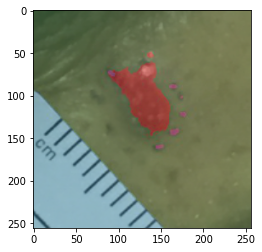

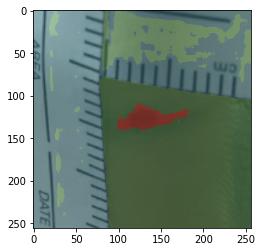

...

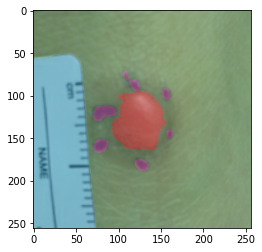

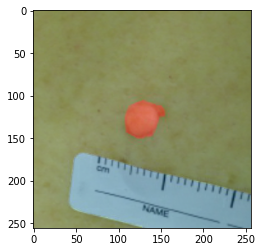

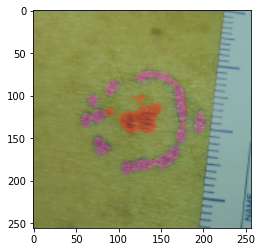

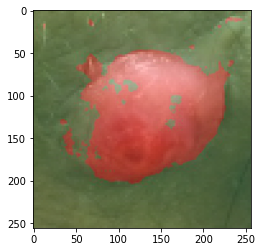

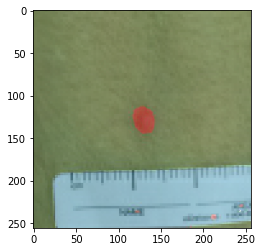

In [ ]:
for i in range(0, len(viz), 2):
    plt.imshow(viz[i])
    plt.imshow(viz[i+1], alpha=0.35)
    plt.show()

## Experiment loop

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_20_3_Resized_fixed
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Preparing the train set for ddi_5_resized...
Take first 120 images...


100%|██████████| 120/120 [01:08<00:00,  1.75it/s]


Total dimension 1024
 ********* max_label 5 *** ignore_label 255 ***********
 *********************** Current number data 7864320 ***********************
 *********************** Current dataloader length 122880 ***********************
Epoch :  0 iteration 100000 loss 0.04386662691831589 acc tensor(98.4375, device='cuda:0')
Epoch :  1 iteration 200000 loss 0.004216391127556562 acc tensor(100., device='cuda:0')
Epoch :  2 iteration 300000 loss 0.05220403894782066 acc tensor(96.8750, device='cuda:0')
Epoch :  3 iteration 400000 loss 0.009798433631658554 acc tensor(100., device='cuda:0')
*************** Break, Total iters, 491627 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_20_3_Resized_fixed/model_0.pth
Epoch :  0 iteration 100000 loss 0.023706907406449318 acc tensor(100., device='cuda:0')
Epoch :  1 iteration 200000 loss 0.000151278538396582 acc tensor(100., device='cuda:0')
Epoch :  2 iteration 300000 loss 4.855654333368

100%|██████████| 120/120 [00:11<00:00, 10.50it/s]


IOU for background 0.9945
IOU for lesion 0.9707
IOU for marker 0.8451
IOU for ruler 0.9943
IOU for skin 0.9972
Overall mIoU:  0.9603691066900126
Mean uncertainty: 0.0161492499668384
Getting Validation Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 15 images...


100%|██████████| 15/15 [00:27<00:00,  1.80s/it]


IOU for background 0.9547
IOU for lesion 0.7576
IOU for marker 0.6186
IOU for ruler 0.9668
IOU for skin 0.986
Overall mIoU:  0.8567518266665438
Mean uncertainty: 0.06779380931208531
Getting Validation Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:06<00:00,  1.36s/it]


IOU for background 0.9357
IOU for lesion 0.7537
IOU for marker 0.6087
IOU for ruler 0.9324
IOU for skin 0.9884
Overall mIoU:  0.8437845630269962
Mean uncertainty: 0.1034935211762786
Getting Validation Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:06<00:00,  1.35s/it]


IOU for background 0.9339
IOU for lesion 0.8033
IOU for marker 0.7946
IOU for ruler 0.9723
IOU for skin 0.9859
Overall mIoU:  0.8979906807731975
Mean uncertainty: 0.04279749244451523
Getting Validation Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:06<00:00,  1.23s/it]


IOU for background 0.972
IOU for lesion 0.7277
IOU for marker 0.3235
IOU for ruler 0.9623
IOU for skin 0.9831
Overall mIoU:  0.793724284845154
Mean uncertainty: 0.057090414315462114
Getting Test Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 16 images...


100%|██████████| 16/16 [00:26<00:00,  1.67s/it]


IOU for background 0.8033
IOU for lesion 0.7244
IOU for marker 0.4667
IOU for ruler 0.9237
IOU for skin 0.9574
Overall mIoU:  0.7751209727465793
Mean uncertainty: 0.1264640223234892
Getting Test Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 6 images...


100%|██████████| 6/6 [00:07<00:00,  1.26s/it]


IOU for background 0.6011
IOU for lesion 0.6817
IOU for marker 0.6931
IOU for ruler 0.9772
IOU for skin 0.9602
Overall mIoU:  0.7826588816239367
Mean uncertainty: 0.09308364056050777
Getting Test Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


IOU for background 0.7856
IOU for lesion 0.4272
IOU for marker 0.1876
IOU for ruler 0.8522
IOU for skin 0.9671
Overall mIoU:  0.6439297169001171
Mean uncertainty: 0.11994643285870552
Getting Test Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:06<00:00,  1.25s/it]


IOU for background 0.8741
IOU for lesion 0.7914
IOU for marker 0.7435
IOU for ruler 0.9547
IOU for skin 0.9422
Overall mIoU:  0.8611857566484262
Mean uncertainty: 0.17303806990385057


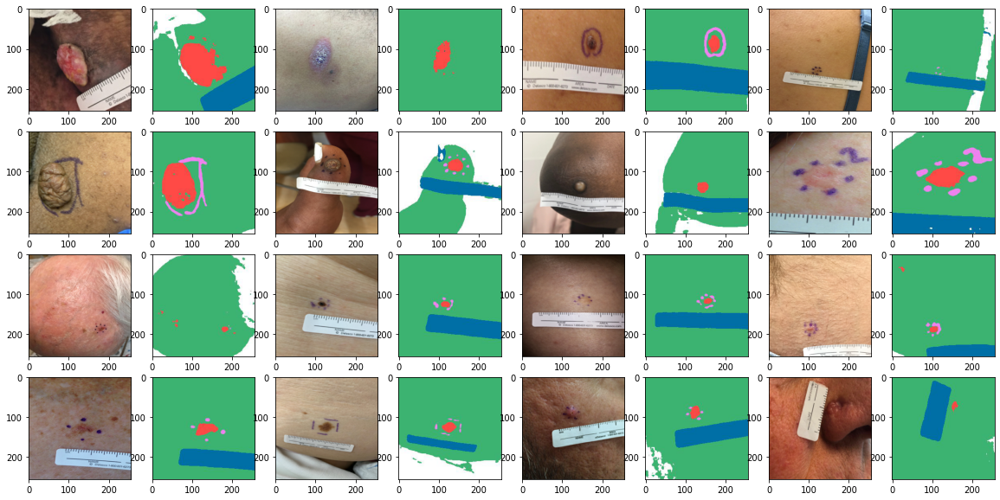

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_15_3_Resized_fixed
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Preparing the train set for ddi_5_resized...
Take first 90 images...


100%|██████████| 90/90 [00:45<00:00,  1.98it/s]


Total dimension 1024
 ********* max_label 5 *** ignore_label 255 ***********
 *********************** Current number data 5898240 ***********************
 *********************** Current dataloader length 92160 ***********************
Epoch :  1 iteration 100000 loss 0.014562597498297691 acc tensor(100., device='cuda:0')
Epoch :  2 iteration 200000 loss 0.007755957543849945 acc tensor(100., device='cuda:0')
Epoch :  3 iteration 300000 loss 0.01797308586537838 acc tensor(98.4375, device='cuda:0')
*************** Break, Total iters, 368744 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_15_3_Resized_fixed/model_0.pth
Epoch :  1 iteration 100000 loss 0.0008210872765630484 acc tensor(100., device='cuda:0')
Epoch :  2 iteration 200000 loss 0.0035389489494264126 acc tensor(100., device='cuda:0')
Epoch :  3 iteration 300000 loss 0.018609216436743736 acc tensor(98.4375, device='cuda:0')
*************** Break, Total iters, 368758 , 

100%|██████████| 90/90 [00:08<00:00, 10.56it/s]


IOU for background 0.9947
IOU for lesion 0.9733
IOU for marker 0.8539
IOU for ruler 0.9947
IOU for skin 0.9972
Overall mIoU:  0.962739893908506
Mean uncertainty: 0.01627720933045364
Getting Validation Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 15 images...


100%|██████████| 15/15 [00:20<00:00,  1.34s/it]


IOU for background 0.9571
IOU for lesion 0.7593
IOU for marker 0.6226
IOU for ruler 0.9627
IOU for skin 0.9865
Overall mIoU:  0.8576147379451996
Mean uncertainty: 0.05261870976537466
Getting Validation Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.40it/s]


IOU for background 0.9529
IOU for lesion 0.764
IOU for marker 0.6155
IOU for ruler 0.9439
IOU for skin 0.9902
Overall mIoU:  0.8532899187593003
Mean uncertainty: 0.06442200336605311
Getting Validation Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.32it/s]


IOU for background 0.9552
IOU for lesion 0.8177
IOU for marker 0.7916
IOU for ruler 0.9727
IOU for skin 0.9877
Overall mIoU:  0.9049546517051373
Mean uncertainty: 0.035445631667971614
Getting Validation Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.39it/s]


IOU for background 0.9598
IOU for lesion 0.7102
IOU for marker 0.3287
IOU for ruler 0.9498
IOU for skin 0.9806
Overall mIoU:  0.7858140683141812
Mean uncertainty: 0.05798849426209927
Getting Test Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 16 images...


100%|██████████| 16/16 [00:20<00:00,  1.27s/it]


IOU for background 0.7413
IOU for lesion 0.6735
IOU for marker 0.4661
IOU for ruler 0.8937
IOU for skin 0.9504
Overall mIoU:  0.7449899085860092
Mean uncertainty: 0.14055756875313818
Getting Test Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 6 images...


100%|██████████| 6/6 [00:00<00:00, 10.41it/s]


IOU for background 0.4747
IOU for lesion 0.706
IOU for marker 0.7023
IOU for ruler 0.9032
IOU for skin 0.9581
Overall mIoU:  0.7488670493158639
Mean uncertainty: 0.12618292247255644
Getting Test Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.27it/s]


IOU for background 0.7675
IOU for lesion 0.3871
IOU for marker 0.1851
IOU for ruler 0.8535
IOU for skin 0.9639
Overall mIoU:  0.6314395660537568
Mean uncertainty: 0.09706973508000374
Getting Test Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.46it/s]


IOU for background 0.8278
IOU for lesion 0.7099
IOU for marker 0.7428
IOU for ruler 0.9466
IOU for skin 0.9239
Overall mIoU:  0.8301691964434801
Mean uncertainty: 0.20129497796297074


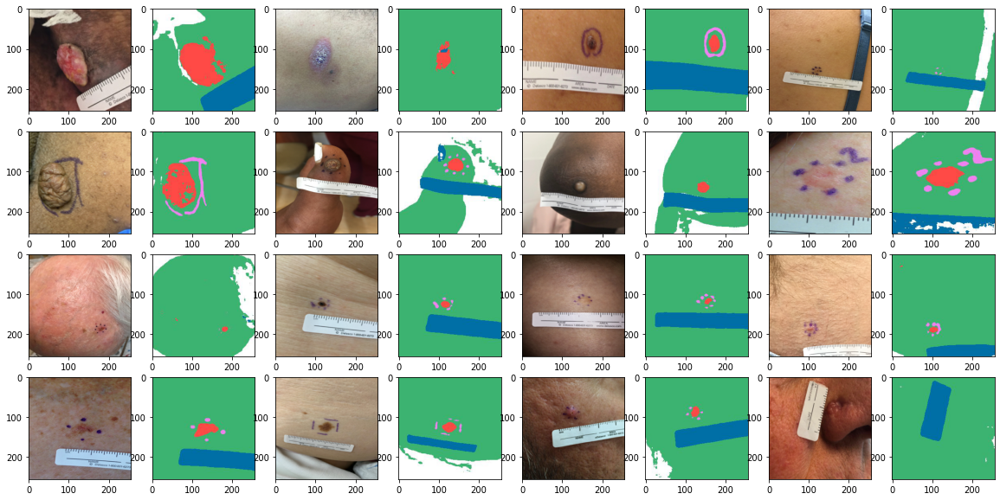

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_10_3_Resized_fixed
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Preparing the train set for ddi_5_resized...
Take first 60 images...


100%|██████████| 60/60 [00:24<00:00,  2.45it/s]


Total dimension 1024
 ********* max_label 5 *** ignore_label 255 ***********
 *********************** Current number data 3932160 ***********************
 *********************** Current dataloader length 61440 ***********************
Epoch :  1 iteration 100000 loss 0.0016305875033140182 acc tensor(100., device='cuda:0')
Epoch :  3 iteration 200000 loss 0.0070516024716198444 acc tensor(100., device='cuda:0')
*************** Break, Total iters, 245841 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_10_3_Resized_fixed/model_0.pth
Epoch :  1 iteration 100000 loss 0.005311593879014254 acc tensor(100., device='cuda:0')
Epoch :  3 iteration 200000 loss 0.017996475100517273 acc tensor(98.4375, device='cuda:0')
*************** Break, Total iters, 245820 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_10_3_Resized_fixed/model_1.pth
Epoch :  1 iteration 100000 loss 0.007

100%|██████████| 60/60 [00:05<00:00, 10.49it/s]


IOU for background 0.9946
IOU for lesion 0.9714
IOU for marker 0.8588
IOU for ruler 0.995
IOU for skin 0.9972
Overall mIoU:  0.9633978044412583
Mean uncertainty: 0.01725700340272548
Getting Validation Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 15 images...


100%|██████████| 15/15 [00:18<00:00,  1.26s/it]


IOU for background 0.9229
IOU for lesion 0.7744
IOU for marker 0.6264
IOU for ruler 0.9647
IOU for skin 0.9807
Overall mIoU:  0.8538040154378622
Mean uncertainty: 0.07940964649120967
Getting Validation Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.18it/s]


IOU for background 0.8245
IOU for lesion 0.791
IOU for marker 0.6071
IOU for ruler 0.9234
IOU for skin 0.9767
Overall mIoU:  0.8245427997854244
Mean uncertainty: 0.11199043802917004
Getting Validation Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.35it/s]


IOU for background 0.9455
IOU for lesion 0.8201
IOU for marker 0.8037
IOU for ruler 0.9747
IOU for skin 0.987
Overall mIoU:  0.9061944665909805
Mean uncertainty: 0.04835276082158089
Getting Validation Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.19it/s]


IOU for background 0.9587
IOU for lesion 0.725
IOU for marker 0.3281
IOU for ruler 0.9543
IOU for skin 0.9787
Overall mIoU:  0.7889671884536694
Mean uncertainty: 0.07788574062287808
Getting Test Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 16 images...


100%|██████████| 16/16 [00:19<00:00,  1.25s/it]


IOU for background 0.7181
IOU for lesion 0.5972
IOU for marker 0.4723
IOU for ruler 0.9199
IOU for skin 0.9435
Overall mIoU:  0.7301938942215319
Mean uncertainty: 0.13514890964142978
Getting Test Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 6 images...


100%|██████████| 6/6 [00:00<00:00, 10.27it/s]


IOU for background 0.2521
IOU for lesion 0.6581
IOU for marker 0.7082
IOU for ruler 0.974
IOU for skin 0.9394
Overall mIoU:  0.7063858497006623
Mean uncertainty: 0.10623646713793278
Getting Test Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.26it/s]


IOU for background 0.8784
IOU for lesion 0.3588
IOU for marker 0.1907
IOU for ruler 0.8484
IOU for skin 0.9749
Overall mIoU:  0.6502336383059221
Mean uncertainty: 0.09936244189739227
Getting Test Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.43it/s]


IOU for background 0.8142
IOU for lesion 0.6188
IOU for marker 0.7427
IOU for ruler 0.9499
IOU for skin 0.9141
Overall mIoU:  0.807956879183422
Mean uncertainty: 0.2056303083896637


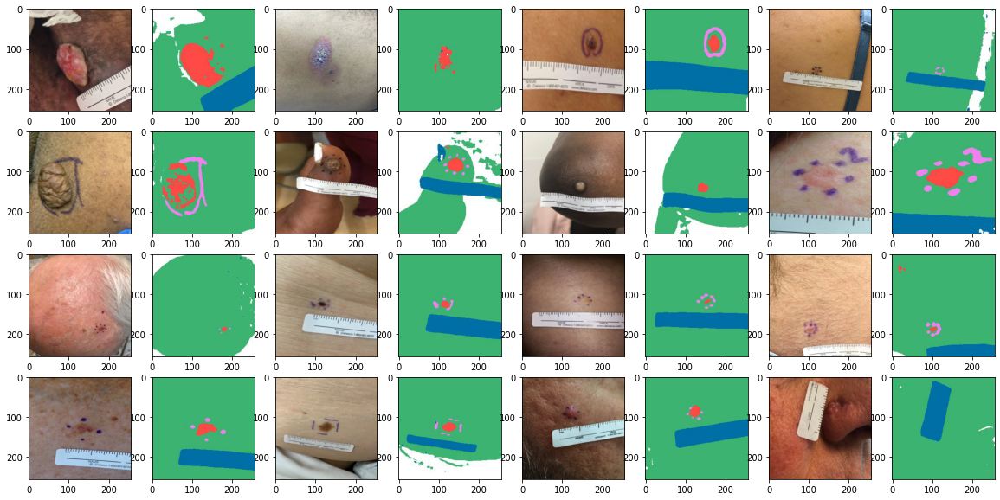

Seed:  0
Experiment folder: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_5_3_Resized_fixed
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Preparing the train set for ddi_5_resized...
Take first 30 images...


100%|██████████| 30/30 [00:40<00:00,  1.34s/it]


Total dimension 1024
 ********* max_label 5 *** ignore_label 255 ***********
 *********************** Current number data 1966080 ***********************
 *********************** Current dataloader length 30720 ***********************
Epoch :  3 iteration 100000 loss 0.0007048300467431545 acc tensor(100., device='cuda:0')
*************** Break, Total iters, 122975 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_5_3_Resized_fixed/model_0.pth
Epoch :  3 iteration 100000 loss 0.0034443968906998634 acc tensor(100., device='cuda:0')
*************** Break, Total iters, 122980 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm/100_6_8_5_5_3_Resized_fixed/model_1.pth
Epoch :  3 iteration 100000 loss 0.00017092745110858232 acc tensor(100., device='cuda:0')
*************** Break, Total iters, 122938 , at epoch 4 ***************
save to: /content/drive/MyDrive/Winter 2023/DDPM/pixel_cl

100%|██████████| 30/30 [00:02<00:00, 10.38it/s]


IOU for background 0.9941
IOU for lesion 0.9698
IOU for marker 0.8692
IOU for ruler 0.9953
IOU for skin 0.997
Overall mIoU:  0.9650906646089531
Mean uncertainty: 0.016382876853458583
Getting Validation Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 15 images...


100%|██████████| 15/15 [00:20<00:00,  1.36s/it]


IOU for background 0.8316
IOU for lesion 0.685
IOU for marker 0.5254
IOU for ruler 0.9515
IOU for skin 0.9658
Overall mIoU:  0.7918697796741782
Mean uncertainty: 0.08478044904768467
Getting Validation Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.11it/s]


IOU for background 0.9552
IOU for lesion 0.5403
IOU for marker 0.5668
IOU for ruler 0.8396
IOU for skin 0.989
Overall mIoU:  0.7781785441544257
Mean uncertainty: 0.06773969009518624
Getting Validation Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.25it/s]


IOU for background 0.83
IOU for lesion 0.8113
IOU for marker 0.7743
IOU for ruler 0.9678
IOU for skin 0.9737
Overall mIoU:  0.8714307998392152
Mean uncertainty: 0.06919146627187729
Getting Validation Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.25it/s]


IOU for background 0.7751
IOU for lesion 0.7246
IOU for marker 0.1567
IOU for ruler 0.9401
IOU for skin 0.93
Overall mIoU:  0.7052959949556866
Mean uncertainty: 0.11741019077599049
Getting Test Overall IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 16 images...


100%|██████████| 16/16 [00:19<00:00,  1.24s/it]


IOU for background 0.6316
IOU for lesion 0.4035
IOU for marker 0.4482
IOU for ruler 0.9021
IOU for skin 0.929
Overall mIoU:  0.6628625022653998
Mean uncertainty: 0.12321117345709354
Getting Test Light IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 6 images...


100%|██████████| 6/6 [00:00<00:00, 10.36it/s]


IOU for background 0.2345
IOU for lesion 0.612
IOU for marker 0.6707
IOU for ruler 0.9582
IOU for skin 0.9388
Overall mIoU:  0.6828387122165065
Mean uncertainty: 0.09347516639779012
Getting Test Medium IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.09it/s]


IOU for background 0.776
IOU for lesion 0.3629
IOU for marker 0.1883
IOU for ruler 0.8323
IOU for skin 0.9696
Overall mIoU:  0.625823558379928
Mean uncertainty: 0.09914125725626946
Getting Test Dark IOUs
Creating DDPM Feature Extractor...
Pretrained model is successfully loaded from /content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt
Take first 5 images...


100%|██████████| 5/5 [00:00<00:00, 10.02it/s]


IOU for background 0.7145
IOU for lesion 0.3329
IOU for marker 0.6876
IOU for ruler 0.9267
IOU for skin 0.8719
Overall mIoU:  0.7067145731929275
Mean uncertainty: 0.18296429812908171


In [ ]:
gc.collect()

fracs = [20, 15, 10, 5]
folds = [3]
zoom = "Resized"
base = f"/content/drive/MyDrive/Winter 2023/DDI/Segmentation Labels/{zoom}"

exp_table_path = os.path.join("/content/drive/MyDrive/Winter 2023/DDPM/",
                              "experiments_ddpm_v2.csv")

try:
    experiment_table = pd.read_csv(exp_table_path)

except:
    headers = {"Method":[], "DDI Fraction (%)":[], "Fold":[], "Zoom":[],
               "Image Size":[], "Diffusion Timesteps":[], "Blocks":[],
               "Embedding Size":[], "MLP Models":[],

               "Train Overall Mean IOU":[], "Train Overall Lesion IOU":[],
               "Train Overall Marker IOU":[], "Train Overall Ruler IOU":[],
               "Train Overall Skin IOU":[], "Train Overall Background IOU":[],

               "Val Overall Mean IOU":[],
               "Val Light Mean IOU":[], "Val Medium Mean IOU":[],
               "Val Dark Mean IOU": [], "Val Overall Lesion IOU":[], # here
               "Val Light Lesion IOU":[], "Val Medium Lesion IOU":[],
               "Val Dark Lesion IOU":[], "Val Overall Marker IOU":[],
               "Val Light Marker IOU":[], "Val Medium Marker IOU":[],
               "Val Dark Marker IOU":[], "Val Overall Ruler IOU":[],
               "Val Light Ruler IOU":[], "Val Medium Ruler IOU":[],
               "Val Dark Ruler IOU":[], "Val Overall Skin IOU":[],
               "Val Light Skin IOU":[], "Val Medium Skin IOU":[],
               "Val Dark Skin IOU":[], "Val Overall Background IOU":[],
               "Val Light Background IOU":[], "Val Medium Background IOU":[],
               "Val Dark Background IOU":[],

               "Test Overall Mean IOU":[],
               "Test Light Mean IOU":[], "Test Medium Mean IOU":[],
               "Test Dark Mean IOU":[], "Test Overall Lesion IOU":[],
               "Test Light Lesion IOU":[], "Test Medium Lesion IOU":[],
               "Test Dark Lesion IOU":[], "Test Overall Marker IOU":[],
               "Test Light Marker IOU":[], "Test Medium Marker IOU":[],
               "Test Dark Marker IOU":[], "Test Overall Ruler IOU":[],
               "Test Light Ruler IOU":[], "Test Medium Ruler IOU":[],
               "Test Dark Ruler IOU":[], "Test Overall Skin IOU":[],
               "Test Light Skin IOU":[], "Test Medium Skin IOU":[],
               "Test Dark Skin IOU":[], "Test Overall Background IOU":[],
               "Test Light Background IOU":[], "Test Medium Background IOU":[],
               "Test Dark Background IOU":[],

               "Results":[]}

    table = pd.DataFrame.from_dict(headers)
    table.to_csv(exp_table_path, index=False)
    experiment_table = pd.read_csv(exp_table_path)

for frac in fracs:
    for fold in folds:
        opts = {
            # ICLR Args
            "exp_dir": "/content/drive/MyDrive/Winter 2023/DDPM/pixel_classifiers/ddpm",
            "model_type": "ddpm",

            "category": "ddi_5_resized",
            "number_class": 5,
            "ignore_label": 255,

            "training_path": f"{base}/Fold {fold}/{frac}%/train",
            "validation_path": f"{base}/Fold {fold}/{frac}%/val",
            "testing_path": f"{base}/Fold {fold}/{frac}%/test",
            #"model_path": "/content/ddpm-segmentation/guided_diffusion/models/256x256_diffusion_uncond.pt",
            "model_path": "/content/drive/MyDrive/Winter 2023/DDPM/256x256_diffusion_uncond.pt",

            "validation_light": f"{base}/Fold {fold}/val_light",
            "validation_med": f"{base}/Fold {fold}/val_med",
            "validation_dark": f"{base}/Fold {fold}/val_dark",

            "testing_light": f"{base}/Fold {fold}/test_light",
            "testing_med": f"{base}/Fold {fold}/test_med",
            "testing_dark": f"{base}/Fold {fold}/test_dark",

            # Hyper-params
            "dim": [256, 256], # The last dim is the number of feature maps (deps on blocks/steps)
            "steps": [100], # how many steps before grabbing activations
            "blocks": [6, 8], # where to grab activations 8, 10, 12, 14, 16?
            "model_num": 5, # How many MLP's to train

            "batch_size": 64,
            "training_number": frac * 6,
            "testing_number": 16,
            "max_training": frac * 6,

            "seed": 0,
            #"exp": "/content/drive/MyDrive/Winter 2023/DDI/ddpm.json",

            "upsample_mode":"bilinear",
            "share_noise": True,
            "input_activations": False,

            # Guided Diff Flags 64
            "attention_resolutions": "32,16,8",
            "class_cond": False, # uncond
            "diffusion_steps": 1000,
            "dropout": 0.1,
            "image_size": 256,
            "learn_sigma": True,
            "noise_schedule": "linear", # cosine in OpenAi 64
            "num_channels": 256,
            "num_head_channels": 64,
            "num_res_blocks": 2,
            "resblock_updown": True,
            #"use_new_attention_order": True, # not in ICLR 356
            "use_fp16": True,
            "use_scale_shift_norm": True,

            # Defaults in https://github.com/openai/guided-diffusion/blob/main/guided_diffusion/script_util.py
            "channel_mult": "",
            "num_heads": 4,
            "num_heads_upsample": -1,
            "num_heads_channels": -1,
            "timestep_respacing": "",
            "use_kl": False,
            "predict_xstart": False,
            "rescale_timesteps": False,
            "rescale_learned_sigmas": False,
            "use_checkpoint": False, # really?
            "use_new_attention_order": False
        }

        factor = (len(opts['steps']) + len(opts['blocks'])) * 2 * opts['dim'][0]
        factor = 1024
        #global_csv["Image Size"].append(str(opts["dim"]))

        opts['dim'].append(factor)

        setup_seed(opts['seed'])

        # Add model num to path
        if len(opts['steps']) > 0:
            suffix = '_'.join([str(step) for step in opts['steps']])
            suffix += '_' + '_'.join([str(step) for step in opts['blocks']])
            suffix += "_" + str(opts['model_num'])
            suffix += "_" + str(frac)
            suffix += "_" + str(fold)
            if zoom == 'Resized':
                suffix += "_" + zoom + "_fixed"
            opts['exp_dir'] = os.path.join(opts['exp_dir'], suffix)

        path = opts['exp_dir']
        os.makedirs(path, exist_ok=True)
        print('Experiment folder: %s' % (path))
        ## We should save the experimental setup opts to exp_dir
        #os.system('cp %s %s' % (opts['exp'], opts['exp_dir']))

        # Check whether all models in ensemble are trained
        pretrained = [os.path.exists(os.path.join(opts['exp_dir'], f'model_{i}.pth'))
                        for i in range(opts['model_num'])]
        json_obj = json.dumps(opts)
        f = open(os.path.join(path, "settings.json"), "w")
        f.write(json_obj)
        f.close()

        if not all(pretrained):
            # train all remaining models
            opts['start_model_num'] = sum(pretrained)
            train(opts)

        print('Loading pretrained models...')
        models = load_ensemble(opts, device='cuda')

        print("Getting Train Overall IOUs")
        eval_dict_train = evaluation(opts, models, split='train', skin='all')
        df_train_all = pd.DataFrame.from_dict(eval_dict_train)

        print("Getting Validation Overall IOUs")
        eval_dict_val = evaluation(opts, models, split='val', skin='all')
        df_val_all = pd.DataFrame.from_dict(eval_dict_val)

        print("Getting Validation Light IOUs")
        eval_dict_val_light = evaluation(opts, models, split='val', skin='light')
        df_val_light = pd.DataFrame.from_dict(eval_dict_val_light)

        print("Getting Validation Medium IOUs")
        eval_dict_val_med = evaluation(opts, models, split='val', skin='med')
        df_val_med = pd.DataFrame.from_dict(eval_dict_val_med)

        print("Getting Validation Dark IOUs")
        eval_dict_val_dark = evaluation(opts, models, split='val', skin='dark')
        df_val_dark = pd.DataFrame.from_dict(eval_dict_val_dark)

        print("Getting Test Overall IOUs")
        eval_dict_test = evaluation(opts, models, split='test', skin='all')
        df_test_all = pd.DataFrame.from_dict(eval_dict_test)

        print("Getting Test Light IOUs")
        eval_dict_test = evaluation(opts, models, split='test', skin='light')
        df_test_light = pd.DataFrame.from_dict(eval_dict_test)

        print("Getting Test Medium IOUs")
        eval_dict_test = evaluation(opts, models, split='test', skin='med')
        df_test_med = pd.DataFrame.from_dict(eval_dict_test)

        print("Getting Test Dark IOUs")
        eval_dict_test = evaluation(opts, models, split='test', skin='dark')
        df_test_dark = pd.DataFrame.from_dict(eval_dict_test)

        train_overall_mean = float(df_train_all.loc[df_train_all['Class'] == 'mean']['IOU'])
        train_overall_lesion = float(df_train_all.loc[df_train_all['Class'] == 'lesion']['IOU'])
        train_overall_marker = float(df_train_all.loc[df_train_all['Class'] == 'marker']['IOU'])
        train_overall_ruler = float(df_train_all.loc[df_train_all['Class'] == 'ruler']['IOU'])
        train_overall_skin = float(df_train_all.loc[df_train_all['Class'] == 'skin']['IOU'])
        train_overall_background = float(df_train_all.loc[df_train_all['Class'] == 'background']['IOU'])

        val_overall_mean = float(df_val_all.loc[df_val_all['Class'] == 'mean']['IOU'])
        val_light_mean = float(df_val_light.loc[df_val_light['Class'] == 'mean']['IOU'])
        val_med_mean = float(df_val_med.loc[df_val_med['Class'] == 'mean']['IOU'])
        val_dark_mean = float(df_val_dark.loc[df_val_dark['Class'] == 'mean']['IOU'])

        val_overall_lesion = float(df_val_all.loc[df_val_all['Class'] == 'lesion']['IOU'])
        val_light_lesion = float(df_val_light.loc[df_val_light['Class'] == 'lesion']['IOU'])
        val_med_lesion = float(df_val_med.loc[df_val_med['Class'] == 'lesion']['IOU'])
        val_dark_lesion = float(df_val_dark.loc[df_val_dark['Class'] == 'lesion']['IOU'])

        val_overall_marker = float(df_val_all.loc[df_val_all['Class'] == 'marker']['IOU'])
        val_light_marker = float(df_val_light.loc[df_val_light['Class'] == 'marker']['IOU'])
        val_med_marker = float(df_val_med.loc[df_val_med['Class'] == 'marker']['IOU'])
        val_dark_marker = float(df_val_dark.loc[df_val_dark['Class'] == 'marker']['IOU'])

        val_overall_ruler = float(df_val_all.loc[df_val_all['Class'] == 'ruler']['IOU'])
        val_light_ruler = float(df_val_light.loc[df_val_light['Class'] == 'ruler']['IOU'])
        val_med_ruler = float(df_val_med.loc[df_val_med['Class'] == 'ruler']['IOU'])
        val_dark_ruler = float(df_val_dark.loc[df_val_dark['Class'] == 'ruler']['IOU'])

        val_overall_skin = float(df_val_all.loc[df_val_all['Class'] == 'skin']['IOU'])
        val_light_skin = float(df_val_light.loc[df_val_light['Class'] == 'skin']['IOU'])
        val_med_skin = float(df_val_med.loc[df_val_med['Class'] == 'skin']['IOU'])
        val_dark_skin = float(df_val_dark.loc[df_val_dark['Class'] == 'skin']['IOU'])

        val_overall_background = float(df_val_all.loc[df_val_all['Class'] == 'background']['IOU'])
        val_light_background = float(df_val_light.loc[df_val_light['Class'] == 'background']['IOU'])
        val_med_background = float(df_val_med.loc[df_val_med['Class'] == 'background']['IOU'])
        val_dark_background = float(df_val_dark.loc[df_val_dark['Class'] == 'background']['IOU'])

        test_overall_mean = float(df_test_all.loc[df_test_all['Class'] == 'mean']['IOU'])
        test_light_mean = float(df_test_light.loc[df_test_light['Class'] == 'mean']['IOU'])
        test_med_mean = float(df_test_med.loc[df_test_med['Class'] == 'mean']['IOU'])
        test_dark_mean = float(df_test_dark.loc[df_test_dark['Class'] == 'mean']['IOU'])

        test_overall_lesion = float(df_test_all.loc[df_test_all['Class'] == 'lesion']['IOU'])
        test_light_lesion = float(df_test_light.loc[df_test_light['Class'] == 'lesion']['IOU'])
        test_med_lesion = float(df_test_med.loc[df_test_med['Class'] == 'lesion']['IOU'])
        test_dark_lesion = float(df_test_dark.loc[df_test_dark['Class'] == 'lesion']['IOU'])

        test_overall_marker = float(df_test_all.loc[df_test_all['Class'] == 'marker']['IOU'])
        test_light_marker = float(df_test_light.loc[df_test_light['Class'] == 'marker']['IOU'])
        test_med_marker = float(df_test_med.loc[df_test_med['Class'] == 'marker']['IOU'])
        test_dark_marker = float(df_test_dark.loc[df_test_dark['Class'] == 'marker']['IOU'])

        test_overall_ruler = float(df_test_all.loc[df_test_all['Class'] == 'ruler']['IOU'])
        test_light_ruler = float(df_test_light.loc[df_test_light['Class'] == 'ruler']['IOU'])
        test_med_ruler = float(df_test_med.loc[df_test_med['Class'] == 'ruler']['IOU'])
        test_dark_ruler = float(df_test_dark.loc[df_test_dark['Class'] == 'ruler']['IOU'])

        test_overall_skin = float(df_test_all.loc[df_test_all['Class'] == 'skin']['IOU'])
        test_light_skin = float(df_test_light.loc[df_test_light['Class'] == 'skin']['IOU'])
        test_med_skin = float(df_test_med.loc[df_test_med['Class'] == 'skin']['IOU'])
        test_dark_skin = float(df_test_dark.loc[df_test_dark['Class'] == 'skin']['IOU'])

        test_overall_background = float(df_test_all.loc[df_test_all['Class'] == 'background']['IOU'])
        test_light_background = float(df_val_light.loc[df_test_light['Class'] == 'background']['IOU'])
        test_med_background = float(df_test_med.loc[df_test_med['Class'] == 'background']['IOU'])
        test_dark_background = float(df_test_dark.loc[df_test_dark['Class'] == 'background']['IOU'])

        experiment_table.loc[len(experiment_table)] = [opts["model_type"],
                                                       frac, fold, zoom,
                                           str(opts["dim"][:2]), str(opts['steps']),
                                           str(opts["blocks"]), str(opts["dim"][-1]),
                                           opts["model_num"],

                                           train_overall_mean,
                                           train_overall_lesion,
                                           train_overall_marker,
                                           train_overall_ruler,
                                           train_overall_skin,
                                           train_overall_background,

                                           val_overall_mean,
                                           val_light_mean, val_med_mean,
                                           val_dark_mean, val_overall_lesion,
                                           val_light_lesion, val_med_lesion,
                                           val_dark_lesion, val_overall_marker,
                                           val_light_marker, val_med_marker,
                                           val_dark_marker, val_overall_ruler,
                                           val_light_ruler, val_med_ruler,
                                           val_dark_ruler, val_overall_skin,
                                           val_light_skin, val_med_skin,
                                           val_dark_skin, val_overall_background,
                                           val_light_background, val_med_background,
                                           val_dark_background,

                                           test_overall_mean,
                                           test_light_mean, test_med_mean,
                                           test_dark_mean, test_overall_lesion,
                                           test_light_lesion, test_med_lesion,
                                           test_dark_lesion, test_overall_marker,
                                           test_light_marker, test_med_marker,
                                           test_dark_marker, test_overall_ruler,
                                           test_light_ruler, test_med_ruler,
                                           test_dark_ruler, test_overall_skin,
                                           test_light_skin, test_med_skin,
                                           test_dark_skin, test_overall_background,
                                           test_light_background, test_med_background,
                                           test_dark_background, opts['exp_dir']]

        experiment_table.to_csv(exp_table_path, index=False)

        test_output = os.path.join(path, "visualizations")
        test_gt = opts['testing_path']

        test_out = os.listdir(test_output)
        viz = []
        for fn in test_out:
            gt = fn.split(".")[0] + ".png"
            gt = os.path.join(test_gt, gt)

            out = os.path.join(test_output, fn)

            with Image.open(gt) as img:
            # Convert the image to a NumPy array
                viz.append(np.array(img))

            with Image.open(out) as img:
            # Convert the image to a NumPy array
                viz.append(np.array(img))

        plot_images(viz, max_cols=8, init=None, save=True, path=path)
        gc.collect()

In [ ]:
from google.colab import runtime
runtime.unassign()

In [ ]:
def train_binary_cls(args, in_size, epochs=1000, batch_size=3, early_stop=500,
                     pooling_num=4, block=6):

    ## Loads a backbone network
    feature_extractor = create_feature_extractor(**args)

    ## Uses the backbone network to extract features and grond truth labels
    features, labels = prepare_data_cls(args, args['metadata_path'], in_size,
                                        feature_extractor,
                                        pooling_num=pooling_num,
                                        block=block)
    # Debug print
    print(f" ************** Features size {len(features)} ******************")

    ## Simple class that extends `Dataset`, see above for details
    train_data = FeatureDatasetCls(features, labels)

    ## Call to PyTorch's DataLoader
    train_loader = DataLoader(dataset=train_data, batch_size=batch_size,
                              shuffle=True, drop_last=True)

    print(" ******* Dataloader length " +  str(len(train_loader)) + " *******")

    ## Creates a binary classifier from our LinearClassifier class
    binary_classifier = LinearClassifier(classes=1, dim=in_size,
                                         pooling_num=pooling_num)

    ## DataParallel (seen on some examples, not sure if needed)
    binary_classifier = nn.DataParallel(binary_classifier).cuda()
    ## BinaryCrossEntropy loss (as we're doing binary classification)
    criterion = nn.BCELoss()
    ## Adam with L2 penalty
    optimizer = torch.optim.Adam(binary_classifier.parameters(), lr=0.0001,
                                 weight_decay=0.00001)
    ## Not sure if this is needed (seen on some examples)
    binary_classifier.train()
    ## Binary acccuracy for our accuracy metric
    metric = BinaryAccuracy()

    ## Some definitions for our loop
    iteration = 0
    break_count = 0
    best_loss = 10000000
    best_vacc = 0.0
    best_tacc = 0.5
    stop_sign = 0

    ## Prepares the validation data the same way as the training data above
    v_features, v_labels = prepare_data_cls(args, args['metadata_path'],
                                            in_size, feature_extractor,
                                            split='val', pooling_num=pooling_num,
                                            block=block)

    val_data = FeatureDatasetCls(v_features, v_labels)

    val_loader = DataLoader(dataset=val_data, batch_size=args['testing_number'],
                              shuffle=False, drop_last=True)

    print(" **** Val Dataloader length " +  str(len(val_loader)) + " ****")

    print("Training...")
    # Epoch loop
    for epoch in range(epochs):
        # batch loop
        for X_batch, y_batch in train_loader:
            binary_classifier.train(True)
            X_batch, y_batch = X_batch.to(dev()), y_batch.to(dev())
            y_batch = y_batch.type(torch.float)

            optimizer.zero_grad()
            y_pred = binary_classifier(X_batch.float())
            #y_pred = y_pred.unsqueeze(1)
            #y_pred = y_pred.float()

            loss = criterion(y_pred, y_batch.unsqueeze(1))
            loss.backward()

            metric.update(torch.squeeze(y_pred).cpu(), y_batch.cpu())
            optimizer.step()

            t_acc = binary_accuracy(y_pred, y_batch.unsqueeze(1))
            iteration += 1
            if iteration % 1000 == 0:
                #acc = metric.compute()
                print('Epoch :', str(epoch+1), 'iteration', iteration, 'loss', loss.item(), 'acc', t_acc)
                # print("For pred, gt:")
                # print(y_pred, y_batch)

            if epoch > 3:
                if loss.item() < best_loss:
                    best_loss = loss.item()
                    break_count = 0
                else:
                    break_count += 1

                if break_count > early_stop:
                    stop_sign = 1
                    print("* Early Stop, Total iters,", iteration, ", at epoch", str(epoch), "*")
                    break


        binary_classifier.train(False)
        v_criterion = nn.BCELoss()
        for val_X_batch, val_y_batch in val_loader:
            X_batch_val, y_batch_val = val_X_batch.to(dev()), val_y_batch.to(dev())
            y_batch_val = y_batch_val.type(torch.float)
            y_pred_val = binary_classifier(X_batch_val.float())
            v_loss = v_criterion(y_pred_val, y_batch_val.unsqueeze(1))

        v_acc = binary_accuracy(y_pred_val, y_batch_val.unsqueeze(1))
        if v_acc > best_vacc or (math.isclose(v_acc, best_vacc, rel_tol=0.01) and t_acc > best_tacc):
            train_acc = binary_accuracy(y_pred, y_batch.unsqueeze(1))
            print(f"* Train Loss: {loss.item()}, Train Acc: {train_acc} *")
            print(f"*** Val Loss: {v_loss.item()}, Val Acc: {v_acc} ***")
            best_vacc = v_acc
            model_path = os.path.join(args['exp_dir'], 'binary_model.pth')
            print('save to:', model_path)
            torch.save({'model_state_dict': binary_classifier.state_dict()}, model_path)

        if stop_sign == 1:
                break

    test_features, test_labels = prepare_data_cls(args, args['metadata_path'],
                                            in_size, feature_extractor,
                                            split='test', pooling_num=pooling_num,
                                            block=block)

    test_data = FeatureDatasetCls(test_features, test_labels)

    test_loader = DataLoader(dataset=test_data, batch_size=args['testing_number'],
                              shuffle=False, drop_last=True)

    print("**** Test Dataloader length " +  str(len(test_loader)) + " ****")

    state_dict = torch.load(model_path)['model_state_dict']
    model = nn.DataParallel(LinearClassifier(classes=1,
                                                     dim=in_size,
                                                     pooling_num=pooling_num))
    model.load_state_dict(state_dict)
    model = model.module.to('cuda')
    model.eval()
    test_criterion = nn.BCELoss()
    for test_X_batch, test_y_batch in test_loader:
        X_batch_test, y_batch_test = test_X_batch.to(dev()), test_y_batch.to(dev())
        y_batch_test = y_batch_test.type(torch.float)
        y_pred_test = model(X_batch_test.float())
        test_loss = test_criterion(y_pred_test, y_batch_test.unsqueeze(1))
    test_acc = binary_accuracy(y_pred_test, y_batch_test.unsqueeze(1))
    print(f"**** Test Loss: {test_loss.item()}, Test Acc: {test_acc} ****")

    return train_acc, best_vacc, test_acc